In [1]:
import numpy as np
from numpy import *
from pylab import *
from math import *
import matplotlib.pyplot as plt
import matplotlib.pylab as pylab
import os 
import pandas as pd
import glob
from astropy.io import ascii
import itertools
from datetime import datetime

# Ajuste gaussiano
from scipy.optimize import minimize
import emcee
import corner
from IPython.display import display, Math
from scipy.optimize import curve_fit

path = os.getcwd()

### Sustracción del espectro de los gases

Una vez se obtiene el espectro sintetizado mediante Starlight se procede a obtener el espectro del gas.

El espectro sintetizado por el código de Starlight se corresponde con la parte estelar, por lo que al eliminarla obtenemos los gases.

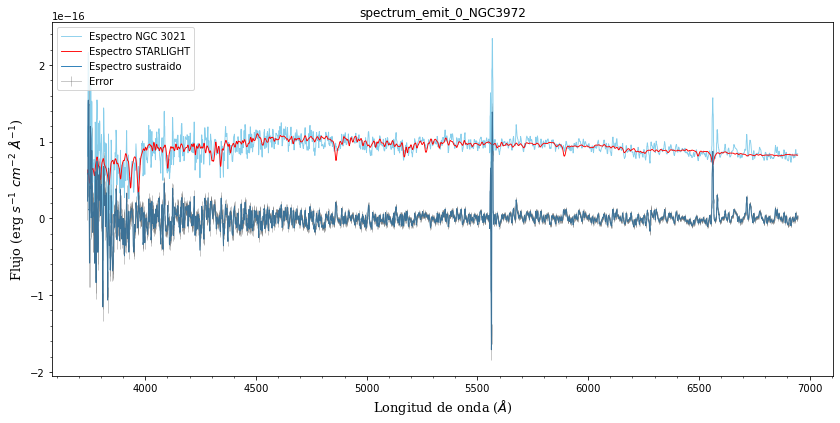

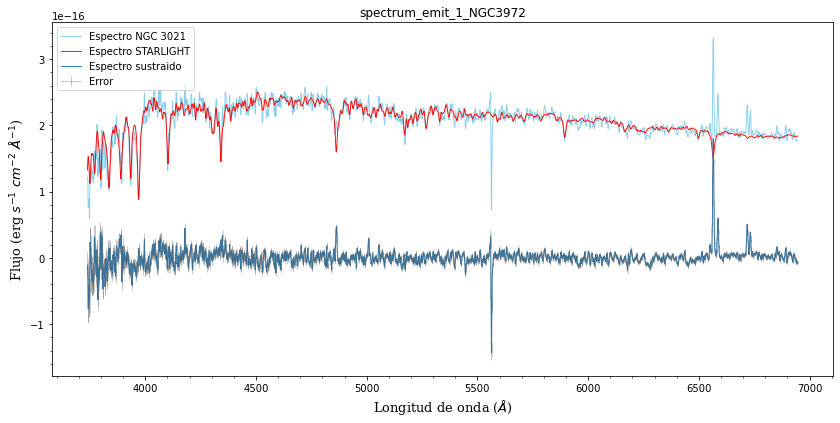

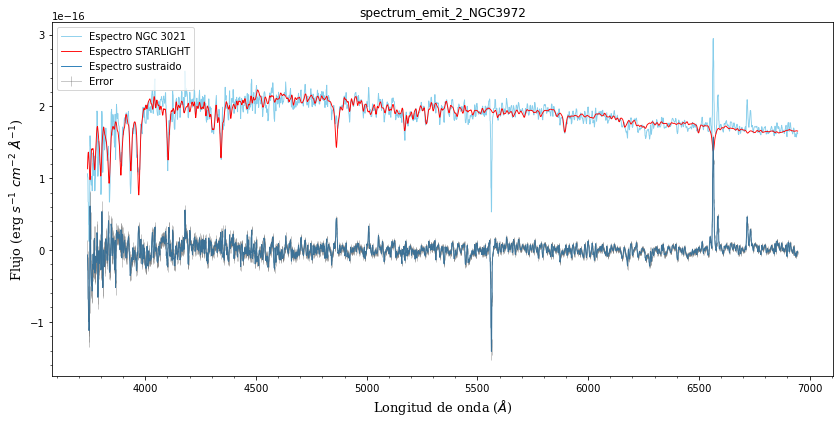

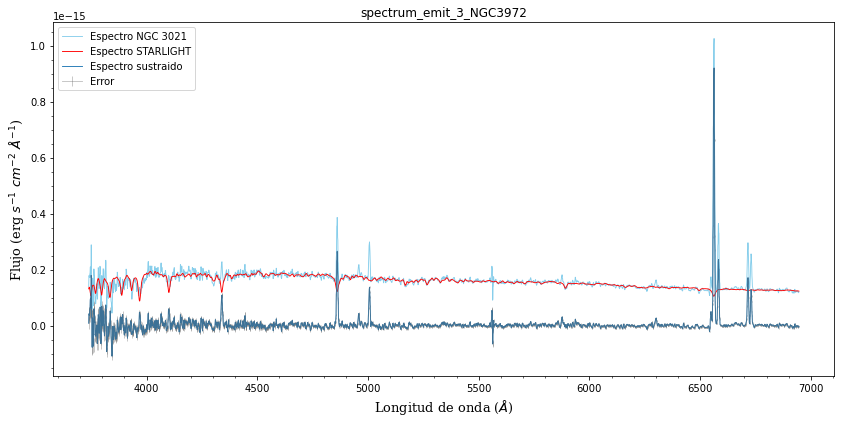

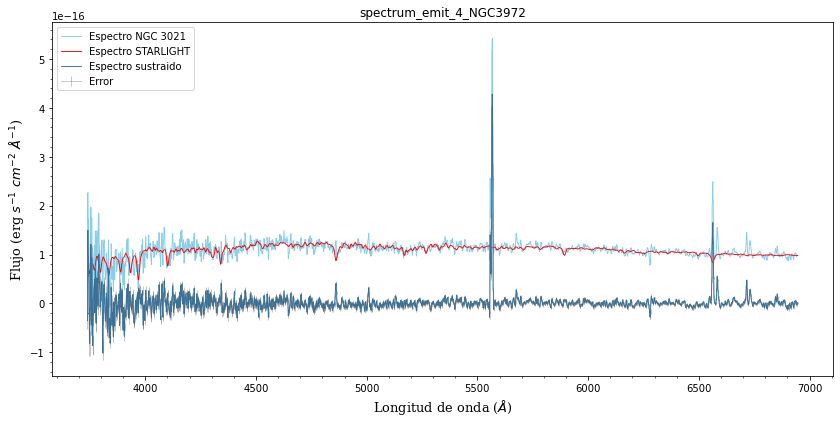

...

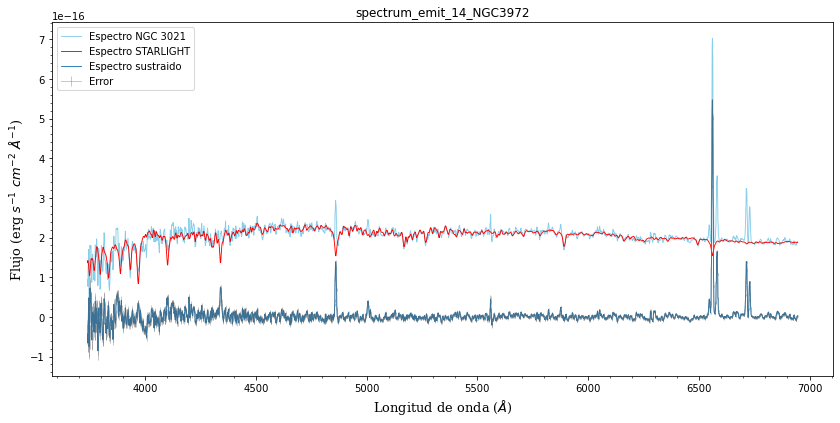

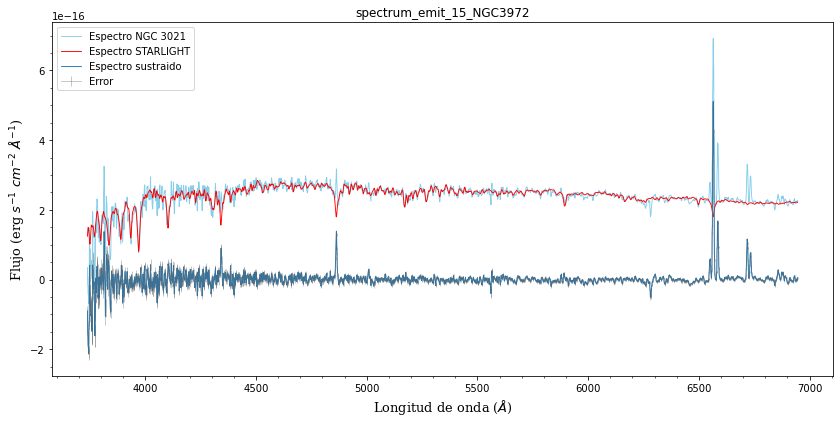

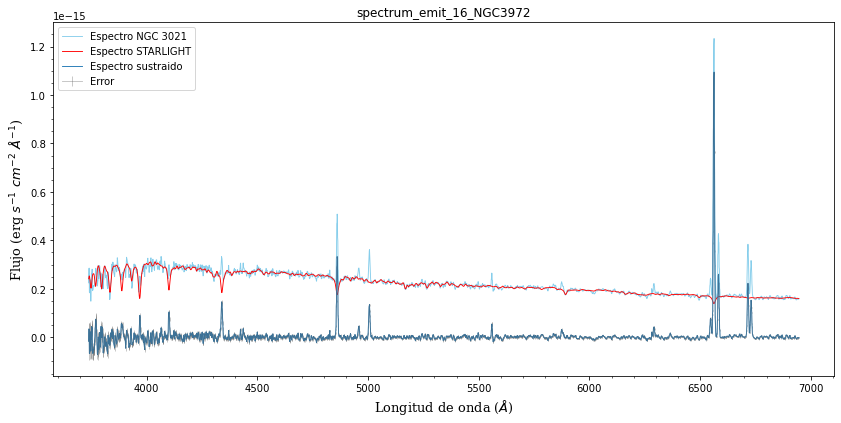

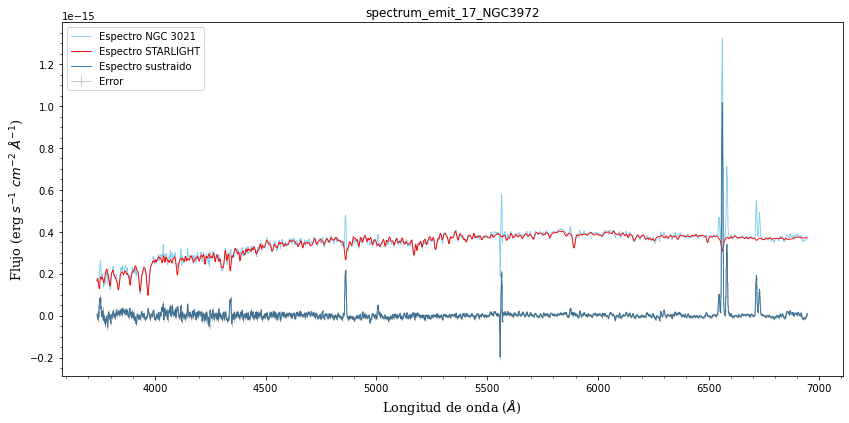

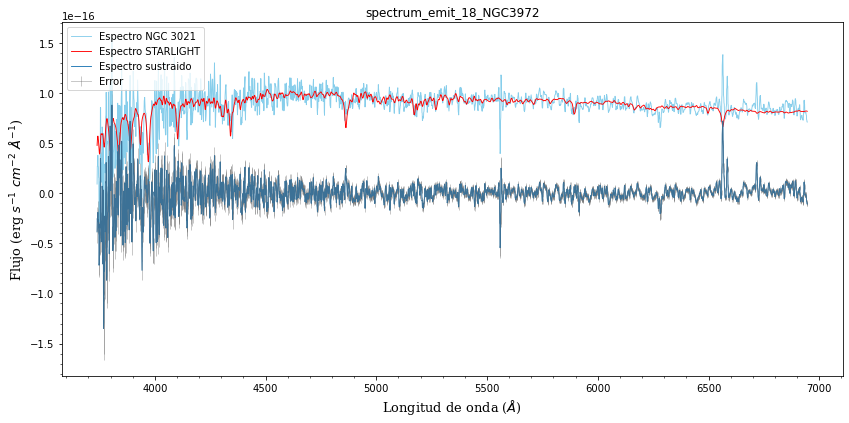

In [2]:
os.chdir(path+'\emited_spectrum')    
os.getcwd()

l_obs_todos = []
f_obs_todos = []
f_syn_todos = []
e_emit_todos = []

lenn = len(glob.glob1(path+'\emited_spectrum',"*.BN"))
#for i in list(itertools.chain(range(lenn-10,lenn-9))):
for i in range(len(glob.glob1(path+'/emited_spectrum',"*.BN"))):
    file = 'spectrum_emit_'+str(i)+'_NGC3972'
    l_obs = []
    f_obs = []
    f_syn = []
    with open(file+'.BN', 'r') as SL:
        f_obs_norm = float((np.array((SL.readlines()[25]).split()))[0,])
    with open(file+'.BN', 'r') as SL:
        data = SL.readlines()[1078:4334]   
        for linea in data:
            linea = np.array(linea.split())
            if float(linea[1]) != 0:
                l_obs.append(float(linea[0,]))
                f_obs.append(float(linea[1,]))
                f_syn.append(float(linea[2,]))
        l_obs = np.array(l_obs)
        f_obs = np.array(f_obs)*f_obs_norm
        f_syn = np.array(f_syn)*f_obs_norm
    
    e_emit = []
    with open(file+'.txt','r') as datos:
        data = datos.readlines()
        for linea in data:
            linea = np.array(linea.split())
            if float(linea[0]) >= l_obs[0] and float(linea[0]) <= l_obs[-1]:
                e_emit.append(float(linea[2,]))
        e_emit = np.array(e_emit)        
        
    
    fig, ax = plt.subplots(figsize=(14,6.5))
    ax.plot(l_obs,f_obs,color='skyblue', linewidth=0.9,label="Espectro NGC 3021")
    ax.plot(l_obs,f_syn,color='red', linewidth=0.9,label="Espectro STARLIGHT")
    ax.errorbar(l_obs,f_obs-f_syn,yerr=e_emit,linewidth=0.9, alpha=0.4, label='Error', color='dimgrey')
    ax.plot(l_obs,f_obs-f_syn, linewidth=0.9,label="Espectro sustraido")
    
    xlabel(r'Longitud de onda ($\AA$)', fontsize=13,fontfamily='serif'); ylabel(r'Flujo (erg $s^{-1}$ $cm^{-2}$ $\AA^{-1}$)', fontsize=13,fontfamily='serif') 
    plt.legend(loc='upper left')
    title('%s' %(file));plt.legend(loc='upper left')
    plt.minorticks_on()
    #axvline(4861, color='k', ls="dotted",lw='0.9')
    #text(4881, 8.3*10**(-16), r'[H$_{\beta}$] 4861',alpha=0.8,rotation='vertical',fontsize='11') 
    #axvline(5007, color='k', ls="dotted",lw='0.9')
    #text(5027, 8.3*10**(-16), r'[O III] 5007',alpha=0.8,rotation='vertical',fontsize='11') 
    #axvline(6563, color='k', ls="dotted",lw='0.9')
    #text(6485, 9.9*10**(-16), r'[H$_{\alpha}$] 6563',alpha=0.8,rotation='vertical',fontsize='11') 
    #axvline(6583, color='k', ls="dotted",lw='0.9')
    #text(6603, 9.9*10**(-16), r'[N II] 6583',alpha=0.8,rotation='vertical',fontsize='11') 
    #axvline(6716, color='k', ls="dotted",lw='0.9')
    #text(6646, 6.5*10**(-16), r'[S II] 6716',alpha=0.8,rotation='vertical',fontsize='11') 
    #axvline(6731, color='k', ls="dotted",lw='0.9')
    #text(6751, 6.5*10**(-16), r'[S II] 6731',alpha=0.8,rotation='vertical',fontsize='11')  
    #plt.savefig('espectro_final.png')
    plt.show() 
    
    l_obs_todos.append(l_obs)
    f_obs_todos.append(f_obs)
    f_syn_todos.append(f_syn)
    e_emit_todos.append(e_emit)
    
l_obs_todos = np.array(l_obs_todos)
f_obs_todos = np.array(f_obs_todos)
f_syn_todos = np.array(f_syn_todos)
e_emit_todos = np.array(e_emit_todos)

### Ajuste gaussiano en las líneas de Hbeta, OIII, Halfa y NII

Se emplean dos ajustes distintos:
 - Dos ajustes simple para Hb y OIII 
         def gaussian(x, a, x0, sigma):
            return a*np.exp(-(x-x0)**2/(2*sigma**2))
            
 - Un ajuste triple para Halfa y NII 
         def gaussian_2(x, a1 ,a2,a3, x0, sigma):
           return a1*np.exp(-(x-x0)**2/(2*sigma**2))+a2*np.exp(-(x-(x0+d1))**2/(2*sigma**2))+a3*np.exp(-(x-(x0-d2))**2/(2*sigma**2))
        
   
Como las líneas de Halfa y NII están muy cerca hay que hacer un ajuste de tres gaussianas a la vez. 


AJUSTANDO ESPECTRO 0

Ajuste en 4861 nm:

Parámetros reales:
1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


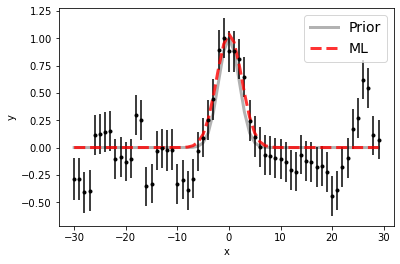

100%|██████████| 15000/15000 [00:20<00:00, 724.54it/s]


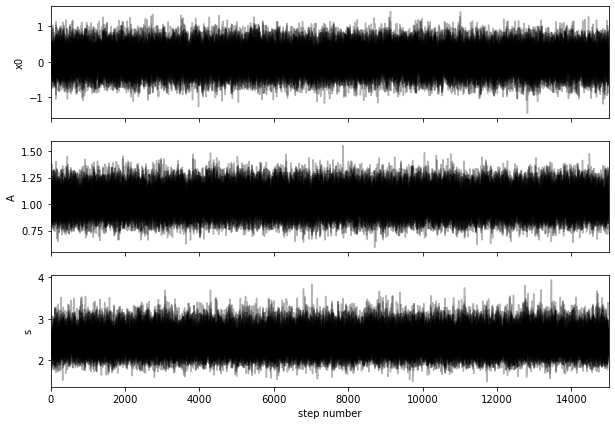

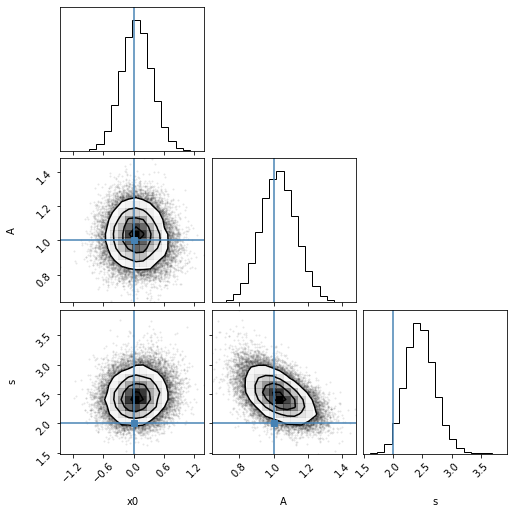

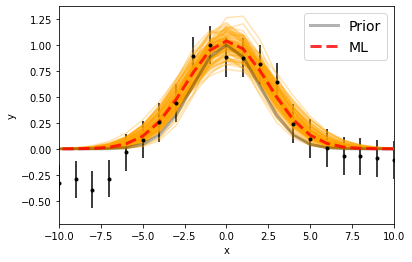

Maximum likelihood estimates:
x0 = 0.050
A = 1.038
s = 2.440


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x0 =  4861.058091298365 [0.297291   0.30070179]
A  =  2.1253842866727157e-17 [2.10479466e-18 2.15789780e-18]
s  =  2.4569130068494713 [0.23692239 0.25530759]

-------------------------------------------------------------------------------------------

Ajuste en 5007 nm:

Parámetros reales:
1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


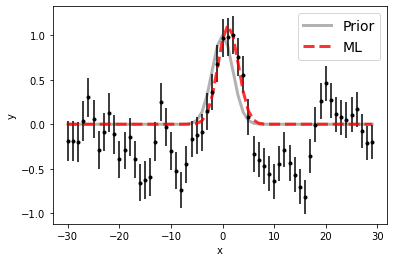

100%|██████████| 15000/15000 [00:16<00:00, 911.02it/s]


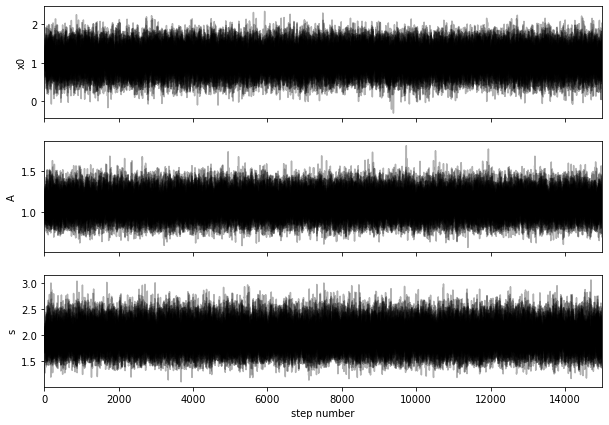

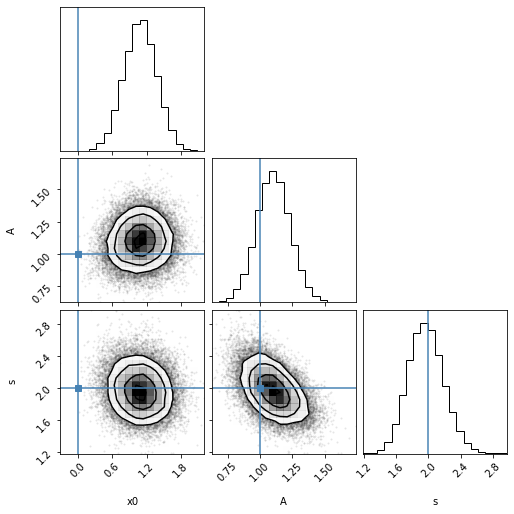

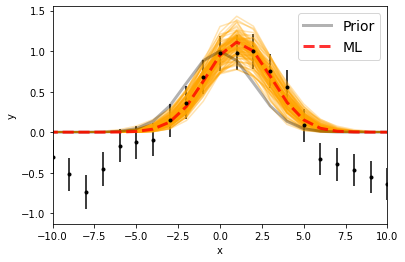

Maximum likelihood estimates:
x0 = 1.092
A = 1.113
s = 1.957


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x0 =  5008.0882979404305 [0.29133887 0.28602915]
A  =  1.9124814136498634e-17 [2.21012539e-18 2.27063295e-18]
s  =  1.9637233583111788 [0.21142484 0.2256325 ]

-------------------------------------------------------------------------------------------

Ajuste en 6563 nm:

Parámetros reales:
1.0 1.0 1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


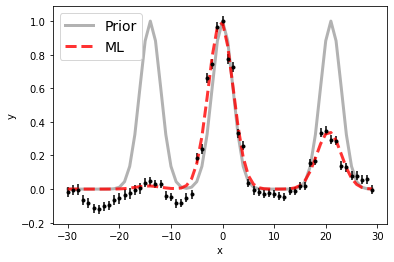

100%|██████████| 15000/15000 [00:27<00:00, 541.14it/s]


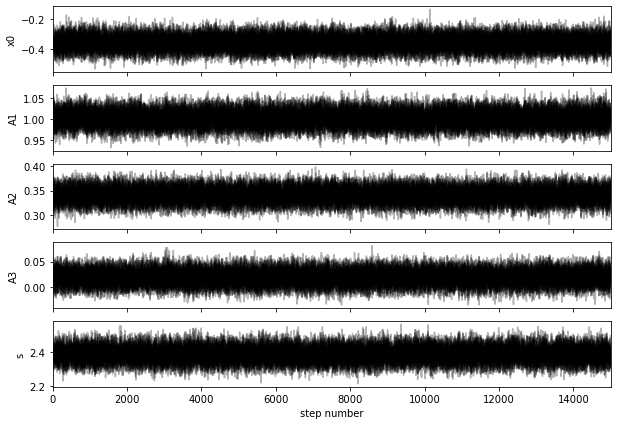

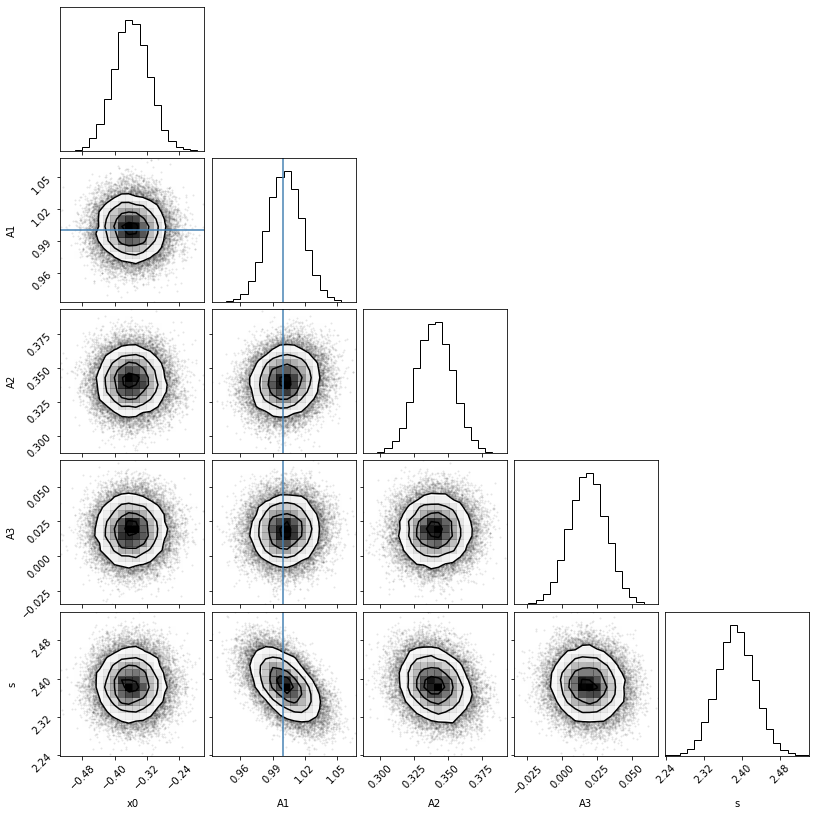

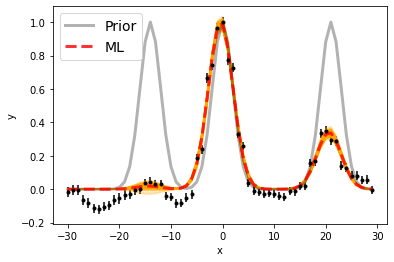

Maximum likelihood estimates:
x0 = -0.359
A1 = 1.002
A2 = 0.341
A3 = 0.019
s = 2.388


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x01, x02 =  6562.641021572392 6583.641021572392 [0.04265135 0.04340645]
A1, A2   =  8.741340793696927e-17 2.970575473630919e-17 [1.39618828e-18 1.41864228e-18] [1.13824760e-18 1.16202931e-18]
s  =  2.3869069016586364 [0.03875681 0.03929439]

-------------------------------------------------------------------------------------------

///////////////////////////////////////////////////////////////////////////////////////////


AJUSTANDO ESPECTRO 1

Ajuste en 4861 nm:

Parámetros reales:
1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


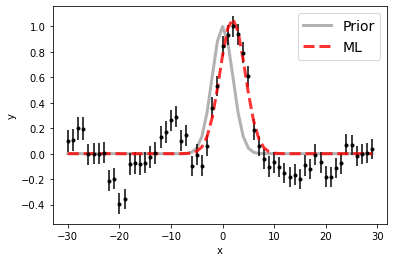

100%|██████████| 15000/15000 [00:16<00:00, 892.61it/s]


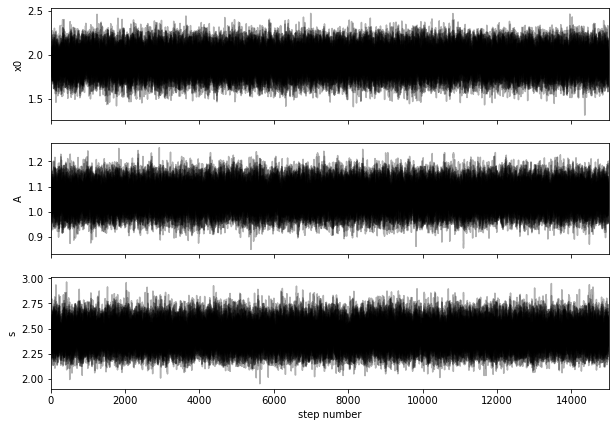

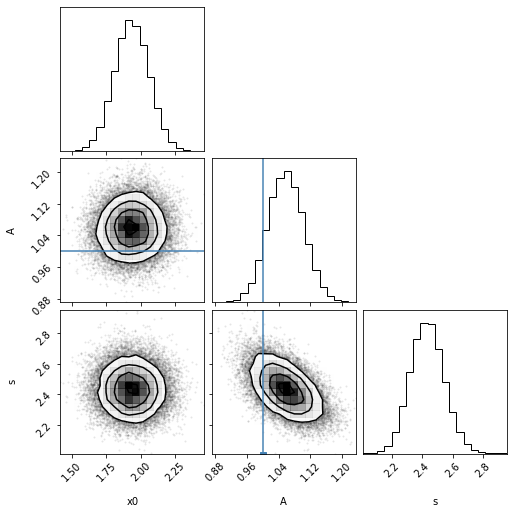

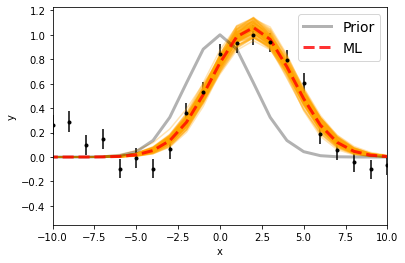

Maximum likelihood estimates:
x0 = 1.934
A = 1.060
s = 2.427


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x0 =  4862.933911144675 [0.12527857 0.12599151]
A  =  4.977921233699368e-17 [2.11223289e-18 2.13640227e-18]
s  =  2.431260310673436 [0.10840249 0.11258529]

-------------------------------------------------------------------------------------------

Ajuste en 5007 nm:

Parámetros reales:
1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


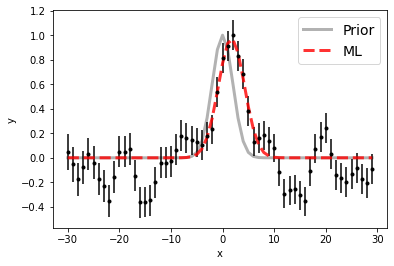

100%|██████████| 15000/15000 [00:16<00:00, 915.06it/s]


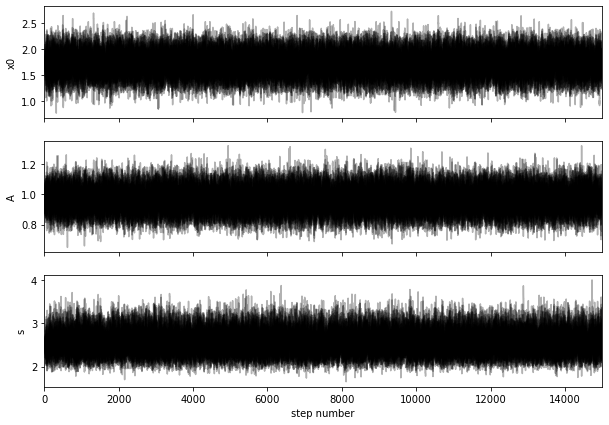

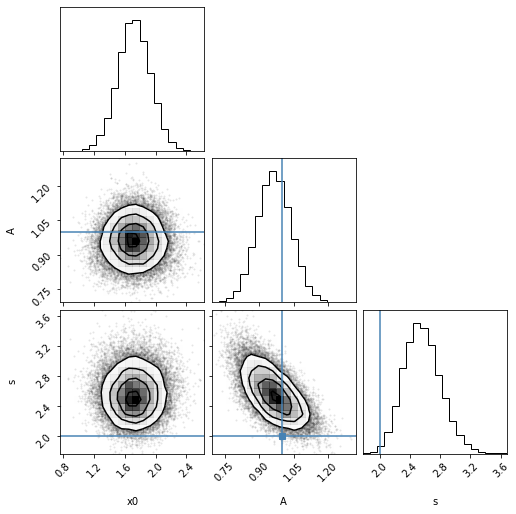

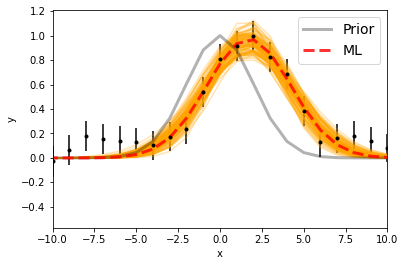

Maximum likelihood estimates:
x0 = 1.722
A = 0.973
s = 2.514


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x0 =  5008.716551767612 [0.20616156 0.21550395]
A  =  2.8240415282819845e-17 [2.15109733e-18 2.17105860e-18]
s  =  2.5457481076154087 [0.23098992 0.25978019]

-------------------------------------------------------------------------------------------

Ajuste en 6563 nm:

Parámetros reales:
1.0 1.0 1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


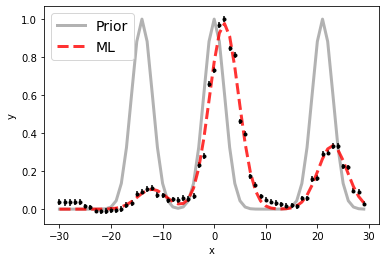

100%|██████████| 15000/15000 [00:25<00:00, 593.43it/s]


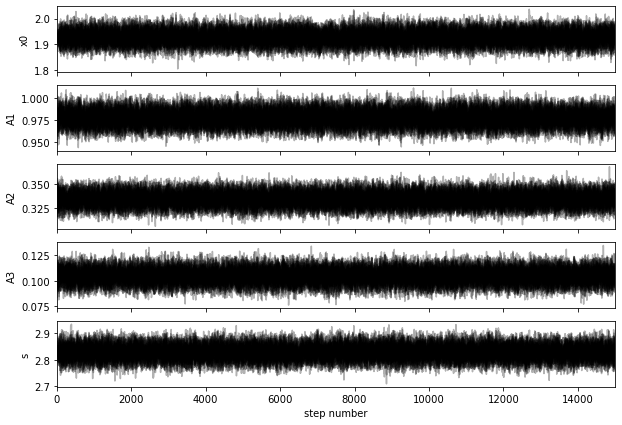

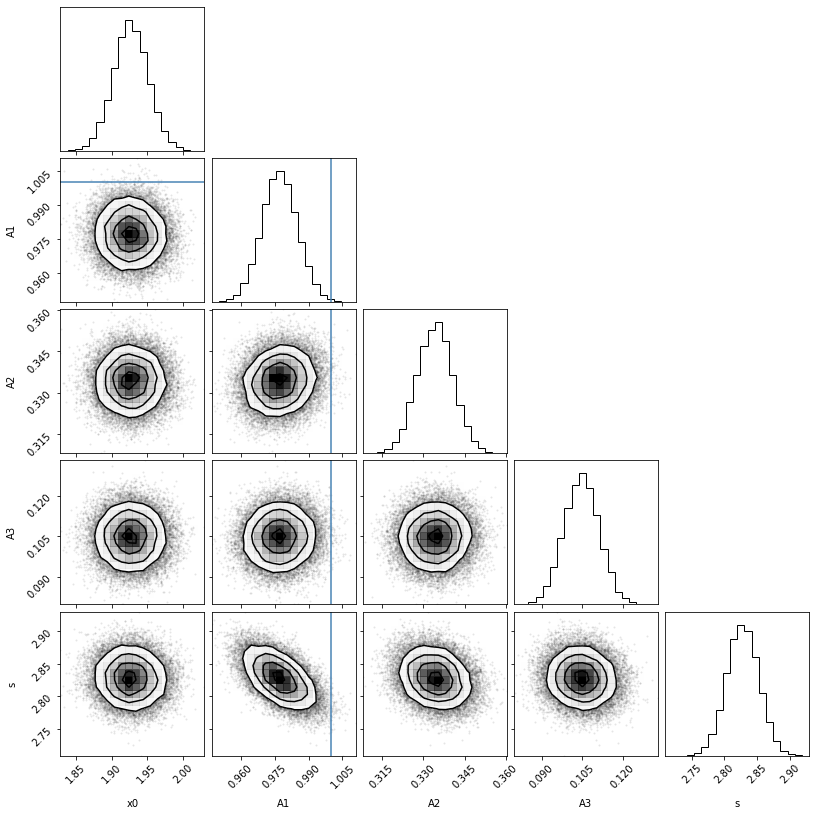

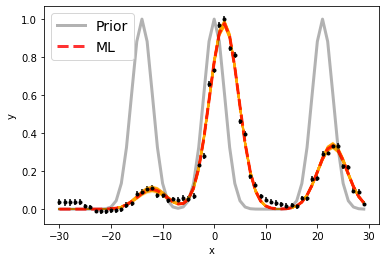

Maximum likelihood estimates:
x0 = 1.927
A1 = 0.977
A2 = 0.334
A3 = 0.105
s = 2.828


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x01, x02 =  6564.926650164261 6585.926650164261 [0.02419771 0.02457819]
A1, A2   =  1.7554598666514135e-16 6.007021680628916e-17 [1.40402943e-18 1.42702937e-18] [1.17874058e-18 1.14428121e-18]
s  =  2.8278362311216894 [0.0242259  0.02446096]

-------------------------------------------------------------------------------------------

///////////////////////////////////////////////////////////////////////////////////////////


AJUSTANDO ESPECTRO 2

Ajuste en 4861 nm:

Parámetros reales:
1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


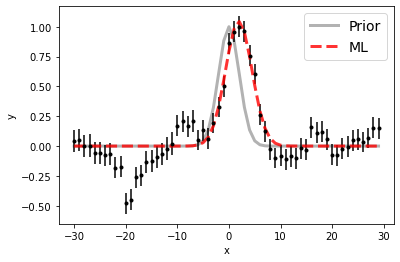

100%|██████████| 15000/15000 [00:16<00:00, 885.24it/s]


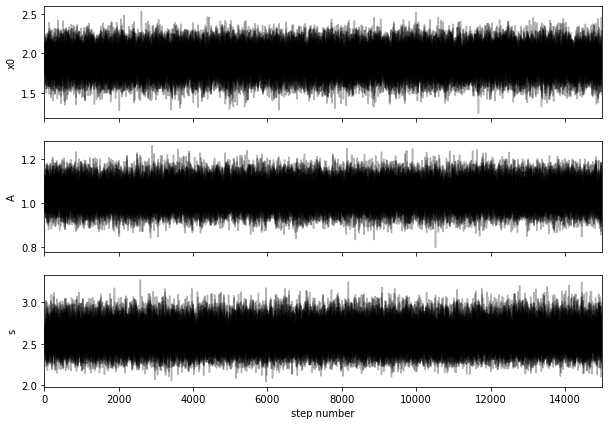

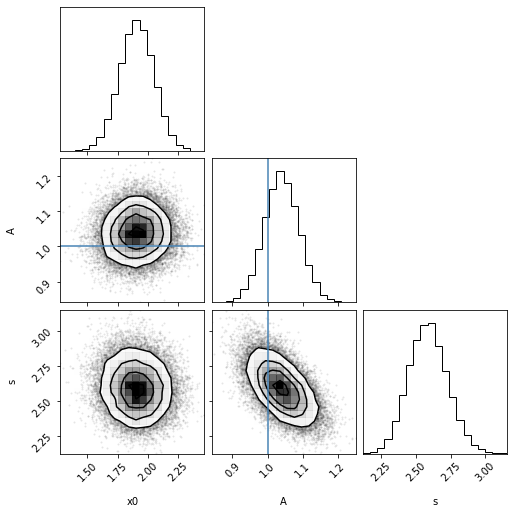

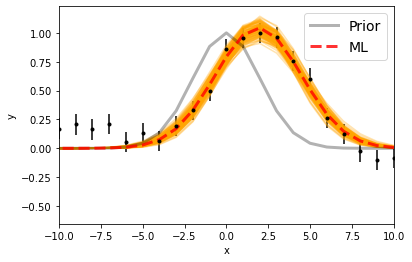

Maximum likelihood estimates:
x0 = 1.908
A = 1.044
s = 2.576


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x0 =  4862.90679709956 [0.14266179 0.1418358 ]
A  =  4.55792710200538e-17 [2.12321213e-18 2.20679972e-18]
s  =  2.585695701465431 [0.13630966 0.14240293]

-------------------------------------------------------------------------------------------

Ajuste en 5007 nm:

Parámetros reales:
1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


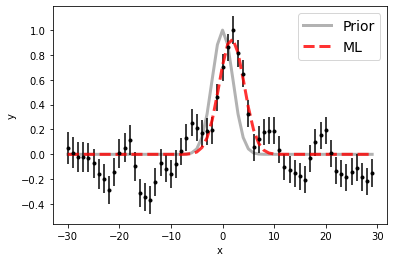

100%|██████████| 15000/15000 [00:16<00:00, 907.39it/s]


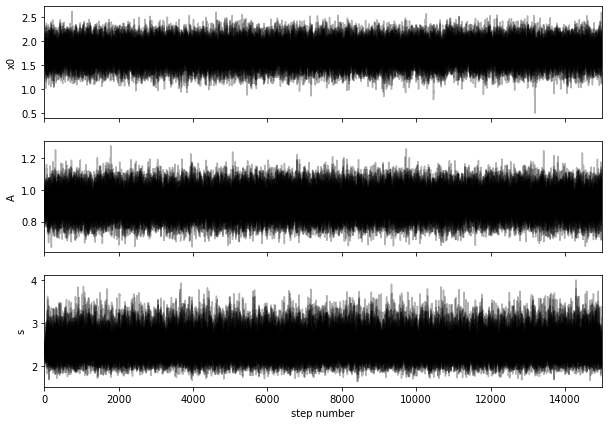

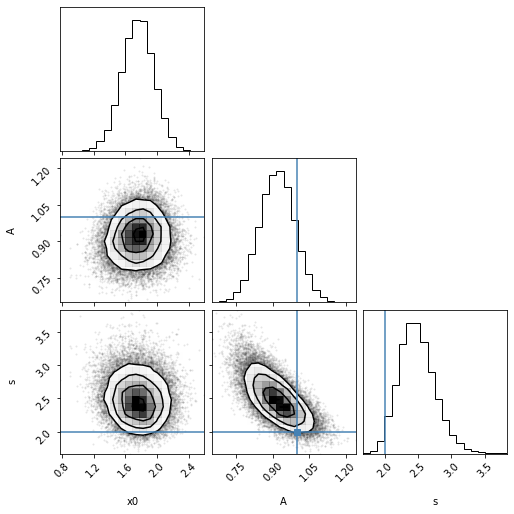

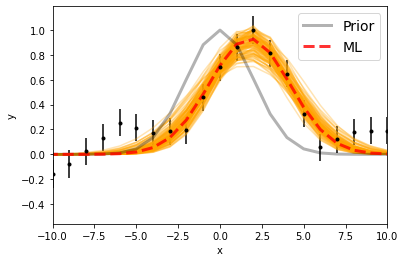

Maximum likelihood estimates:
x0 = 1.759
A = 0.932
s = 2.415


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x0 =  5008.759038800771 [0.20180009 0.19618195]
A  =  3.058998657097067e-17 [2.43995506e-18 2.38389353e-18]
s  =  2.4643314617432237 [0.24120144 0.28352254]

-------------------------------------------------------------------------------------------

Ajuste en 6563 nm:

Parámetros reales:
1.0 1.0 1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


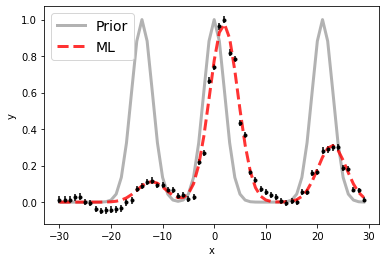

100%|██████████| 15000/15000 [00:25<00:00, 581.81it/s]


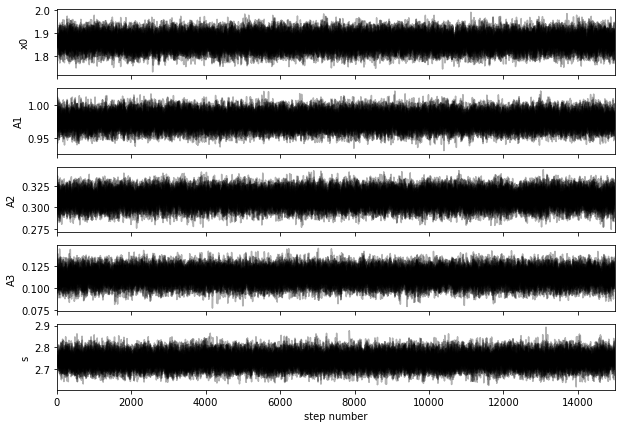

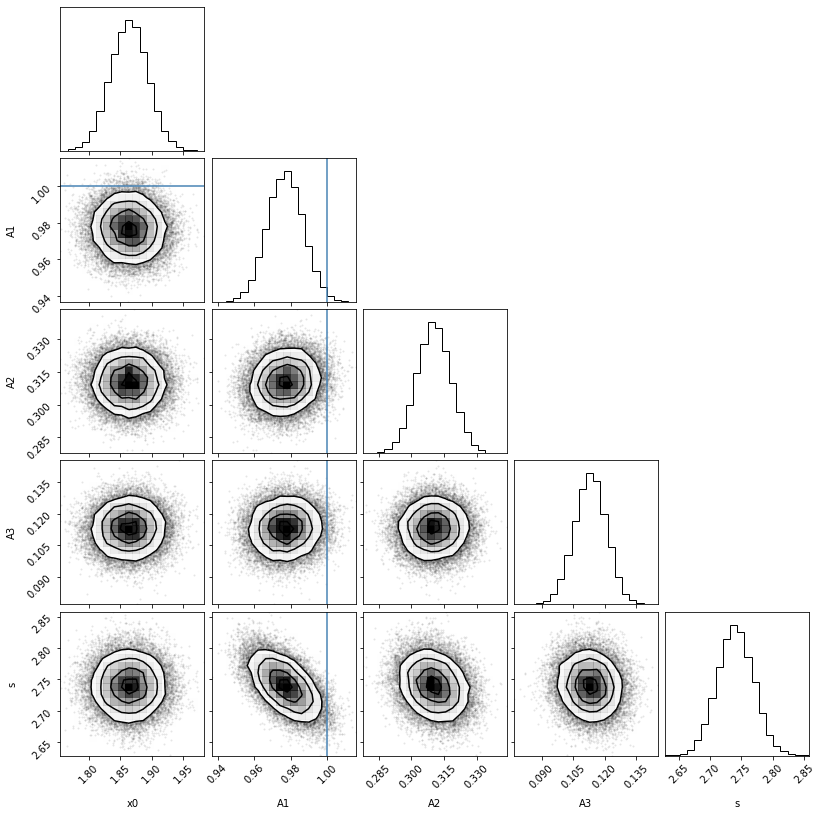

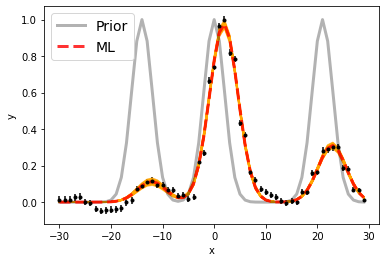

Maximum likelihood estimates:
x0 = 1.864
A1 = 0.977
A2 = 0.310
A3 = 0.113
s = 2.740


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x01, x02 =  6564.863841888617 6585.863841888617 [0.02945232 0.0290637 ]
A1, A2   =  1.533083792900465e-16 4.8675544462002105e-17 [1.54664770e-18 1.53961954e-18] [1.22064967e-18 1.25153133e-18]
s  =  2.7396443198824967 [0.02840377 0.02923539]

-------------------------------------------------------------------------------------------

///////////////////////////////////////////////////////////////////////////////////////////


AJUSTANDO ESPECTRO 3

Ajuste en 4861 nm:

Parámetros reales:
1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


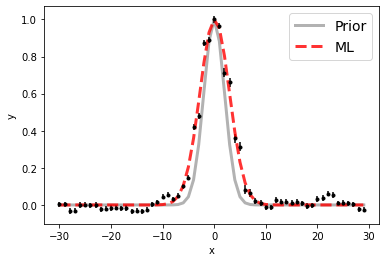

100%|██████████| 15000/15000 [00:16<00:00, 899.62it/s]


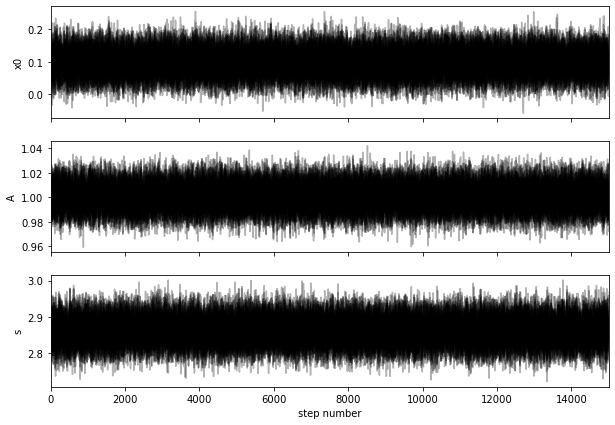

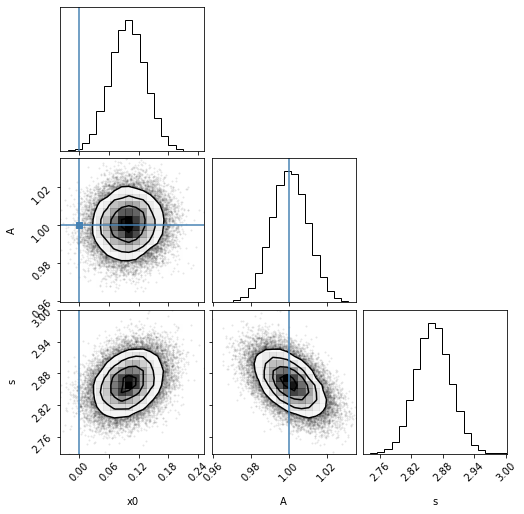

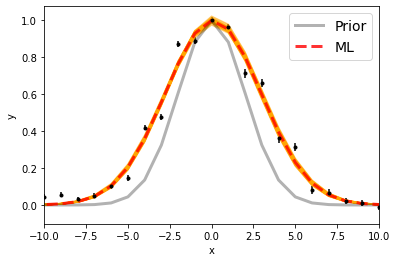

Maximum likelihood estimates:
x0 = 0.098
A = 1.001
s = 2.862


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x0 =  4861.098552221052 [0.03551288 0.03569831]
A  =  2.6481895238161715e-16 [2.50610525e-18 2.51939048e-18]
s  =  2.861655767122912 [0.0326512  0.03334196]

-------------------------------------------------------------------------------------------

Ajuste en 5007 nm:

Parámetros reales:
1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


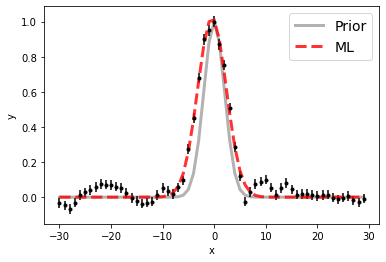

100%|██████████| 15000/15000 [00:16<00:00, 888.03it/s]


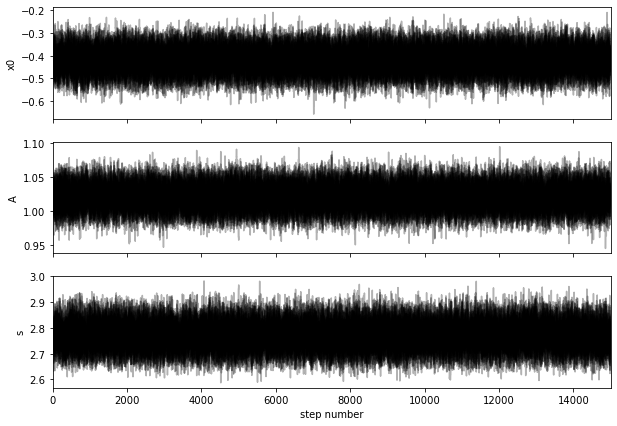

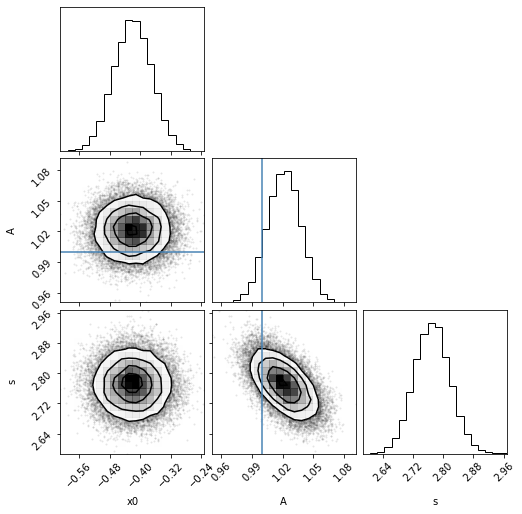

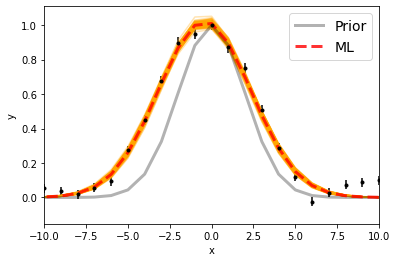

Maximum likelihood estimates:
x0 = -0.420
A = 1.022
s = 2.769


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x0 =  5006.580334106982 [0.04996228 0.04969243]
A  =  1.399408360403747e-16 [2.26138305e-18 2.22735040e-18]
s  =  2.77028130133151 [0.04695722 0.0469846 ]

-------------------------------------------------------------------------------------------

Ajuste en 6563 nm:

Parámetros reales:
1.0 1.0 1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


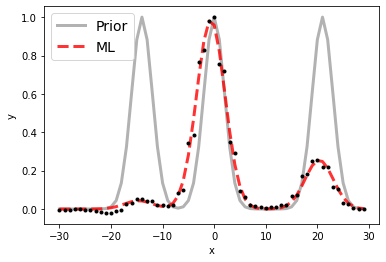

100%|██████████| 15000/15000 [00:25<00:00, 582.90it/s]


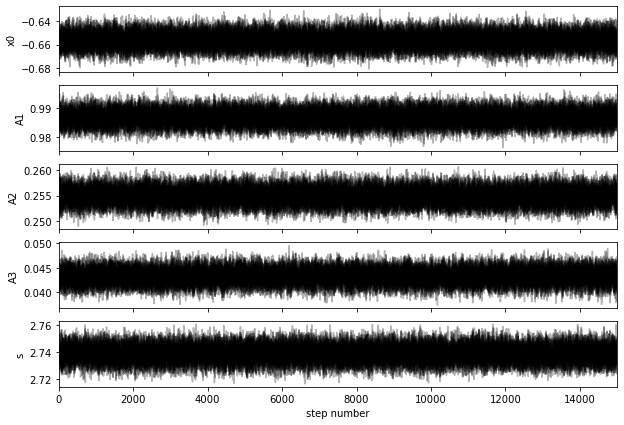

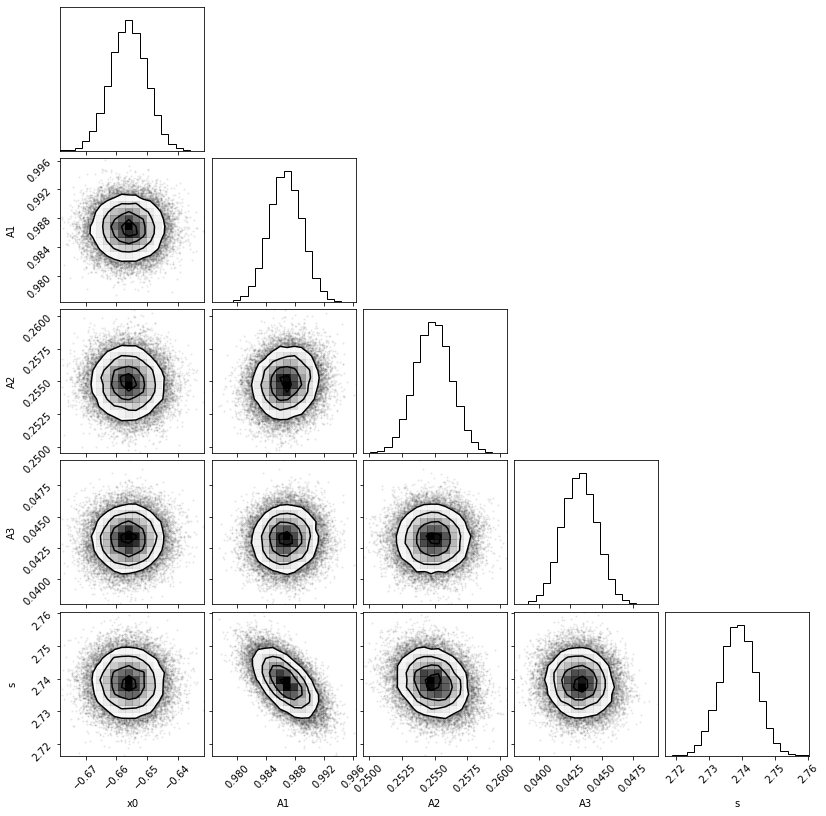

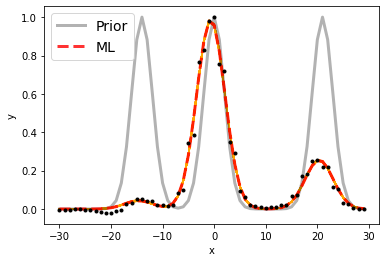

Maximum likelihood estimates:
x0 = -0.656
A1 = 0.987
A2 = 0.255
A3 = 0.043
s = 2.739


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x01, x02 =  6562.343896042798 6583.343896042798 [0.00582167 0.00587731]
A1, A2   =  9.079734849156775e-16 2.34554502936907e-16 [2.09756275e-18 2.10439491e-18] [1.28097047e-18 1.27513859e-18]
s  =  2.7387652509445566 [0.00536799 0.00541145]

-------------------------------------------------------------------------------------------

///////////////////////////////////////////////////////////////////////////////////////////


AJUSTANDO ESPECTRO 4

Ajuste en 4861 nm:

Parámetros reales:
1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


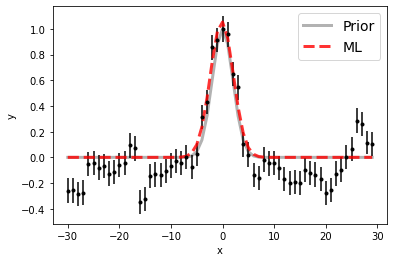

100%|██████████| 15000/15000 [00:19<00:00, 788.18it/s]


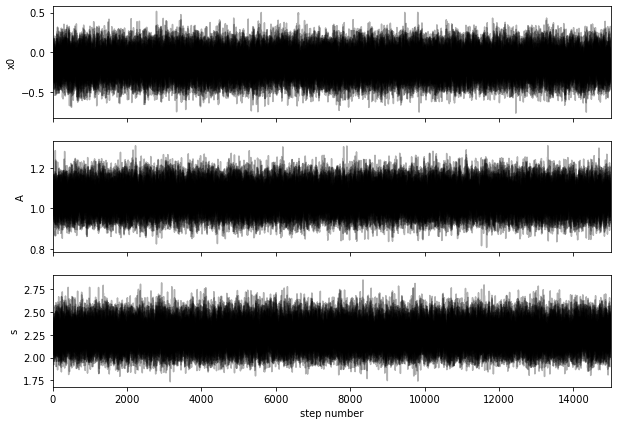

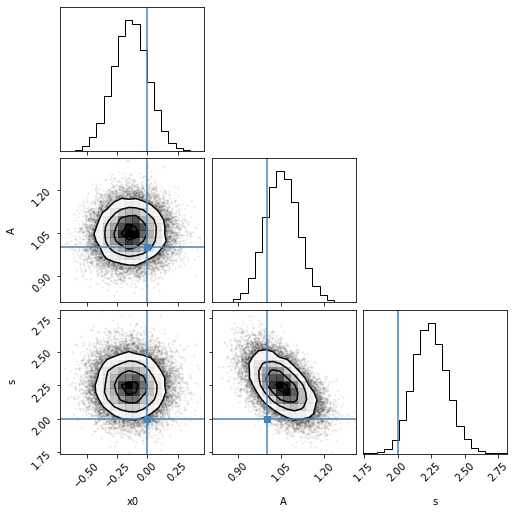

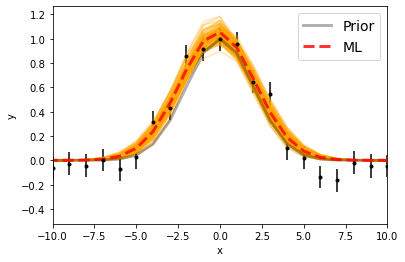

Maximum likelihood estimates:
x0 = -0.138
A = 1.056
s = 2.235


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x0 =  4860.860278635083 [0.14403587 0.14436488]
A  =  4.3024636570202793e-17 [2.33048311e-18 2.35218393e-18]
s  =  2.2419796635553646 [0.12083104 0.12813827]

-------------------------------------------------------------------------------------------

Ajuste en 5007 nm:

Parámetros reales:
1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


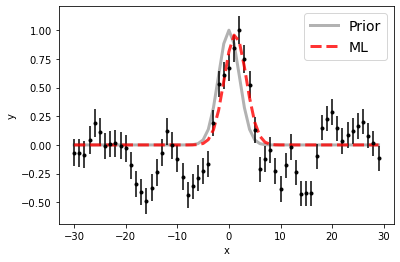

100%|██████████| 15000/15000 [00:16<00:00, 910.30it/s]


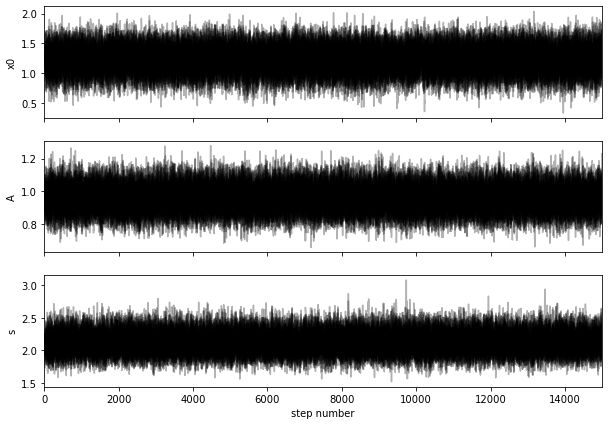

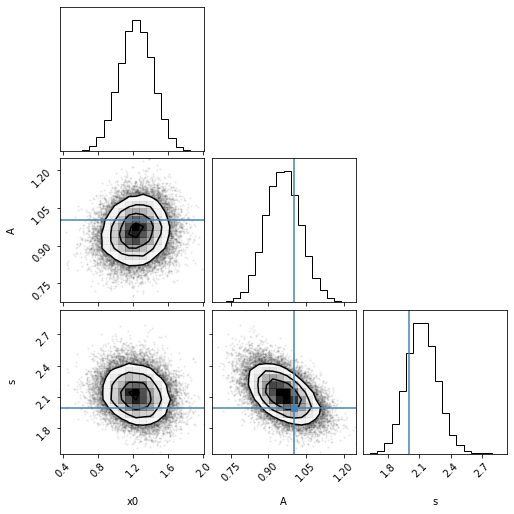

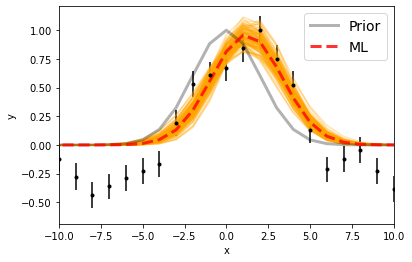

Maximum likelihood estimates:
x0 = 1.229
A = 0.963
s = 2.120


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x0 =  5008.230289219847 [0.19271853 0.19156114]
A  =  3.0767997223471264e-17 [2.22193093e-18 2.27439433e-18]
s  =  2.121175967377784 [0.14175122 0.15052038]

-------------------------------------------------------------------------------------------

Ajuste en 6563 nm:

Parámetros reales:
1.0 1.0 1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


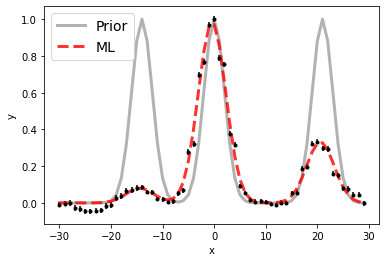

100%|██████████| 15000/15000 [00:24<00:00, 608.35it/s]


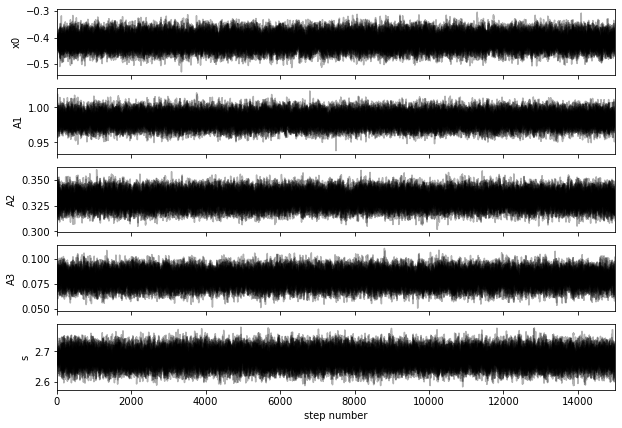

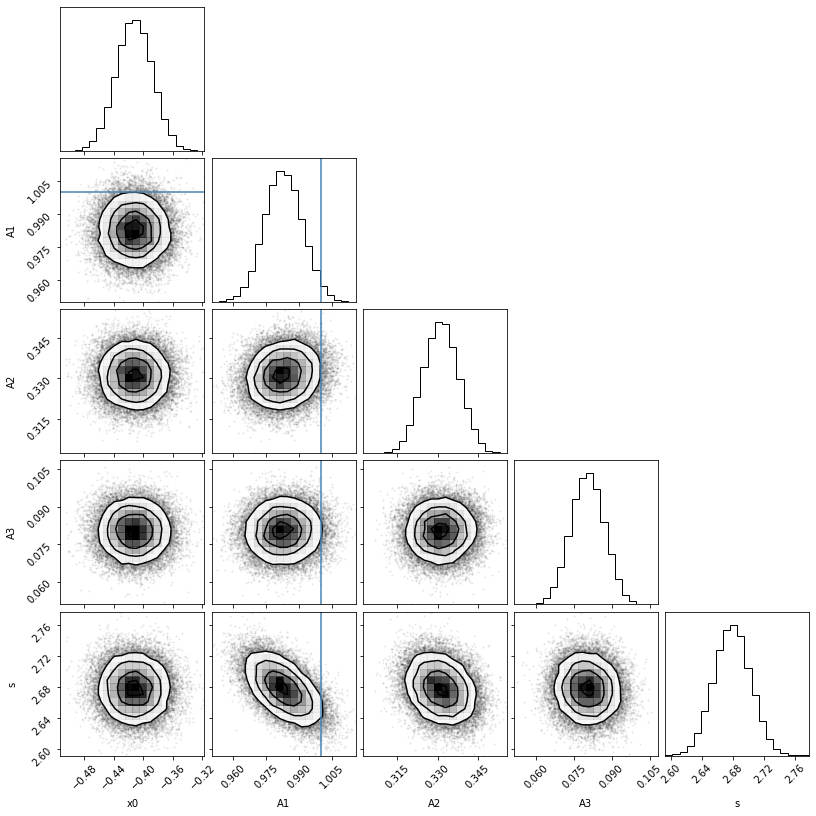

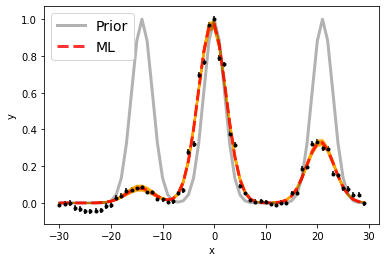

Maximum likelihood estimates:
x0 = -0.413
A1 = 0.983
A2 = 0.331
A3 = 0.080
s = 2.678


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x01, x02 =  6562.587514562853 6583.587514562853 [0.02431686 0.02435079]
A1, A2   =  1.6241487143417247e-16 5.474252384376449e-17 [1.39696994e-18 1.45522597e-18] [1.08367564e-18 1.08351233e-18]
s  =  2.678217798246875 [0.02337672 0.02373692]

-------------------------------------------------------------------------------------------

///////////////////////////////////////////////////////////////////////////////////////////


AJUSTANDO ESPECTRO 5

Ajuste en 4861 nm:

Parámetros reales:
1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


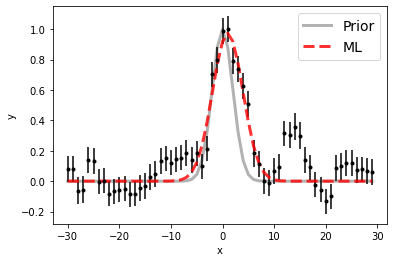

100%|██████████| 15000/15000 [00:17<00:00, 849.46it/s]


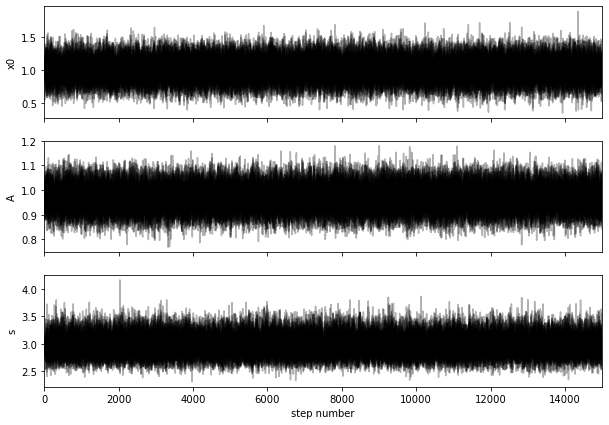

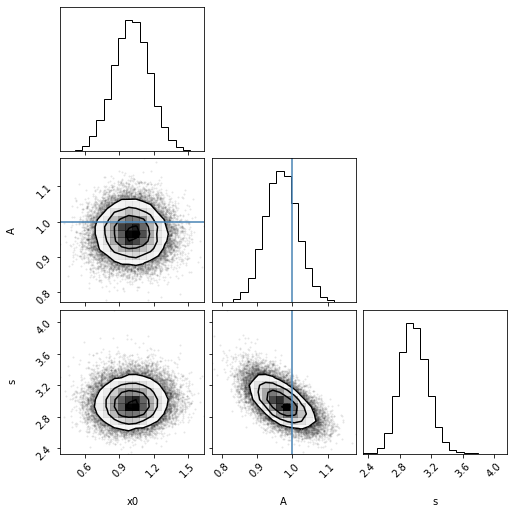

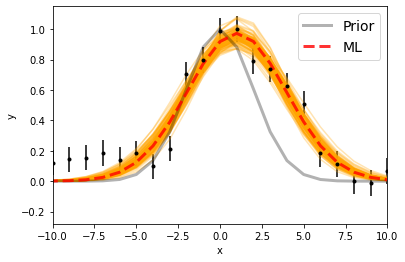

Maximum likelihood estimates:
x0 = 1.004
A = 0.973
s = 2.956


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x0 =  4862.005614275964 [0.15914169 0.15698437]
A  =  4.150963832030622e-17 [1.97847070e-18 2.00103454e-18]
s  =  2.9718919538875497 [0.16614297 0.18034484]

-------------------------------------------------------------------------------------------

Ajuste en 5007 nm:

Parámetros reales:
1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


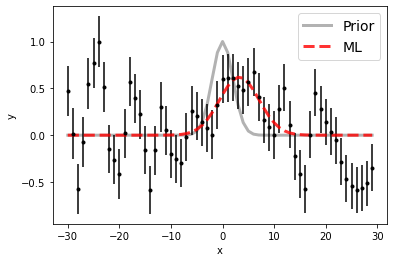

100%|██████████| 15000/15000 [00:16<00:00, 889.38it/s]


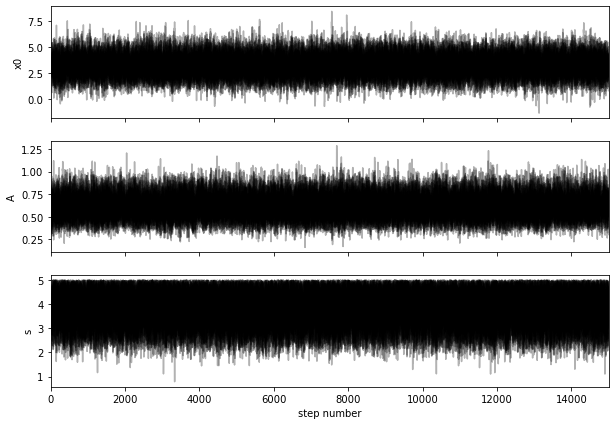

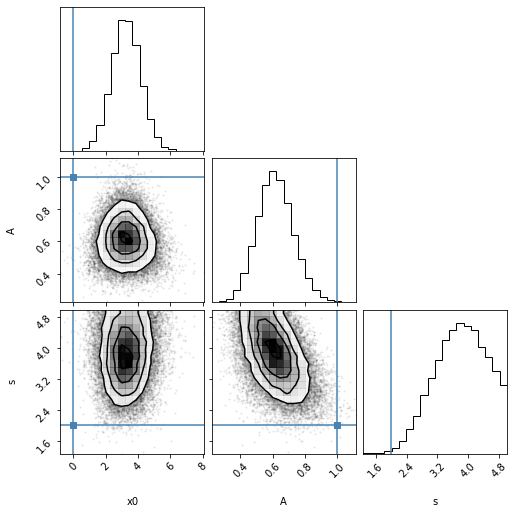

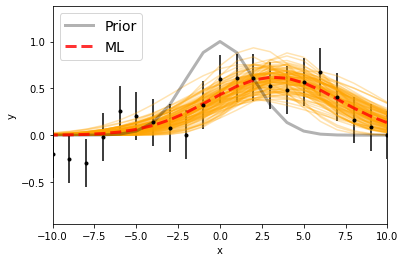

Maximum likelihood estimates:
x0 = 3.255
A = 0.620
s = 3.839


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x0 =  5010.256867936756 [0.87055495 0.88717179]
A  =  8.20640574794089e-18 [1.44839519e-18 1.53739977e-18]
s  =  3.828656184978791 [0.7257371  0.68862884]

-------------------------------------------------------------------------------------------

Ajuste en 6563 nm:

Parámetros reales:
1.0 1.0 1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


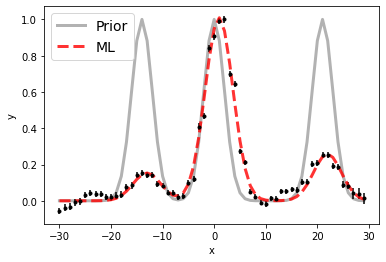

100%|██████████| 15000/15000 [00:29<00:00, 505.62it/s]


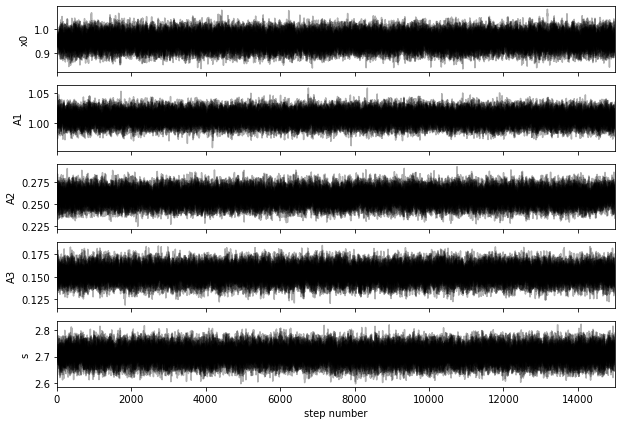

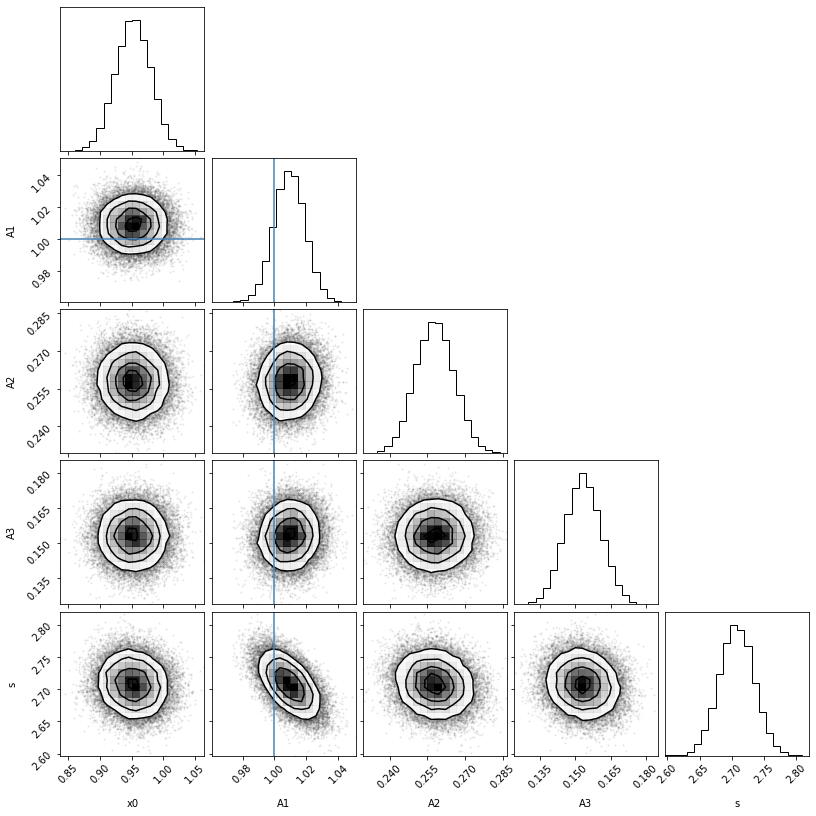

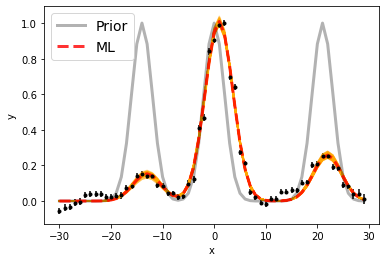

Maximum likelihood estimates:
x0 = 0.952
A1 = 1.009
A2 = 0.258
A3 = 0.153
s = 2.708


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x01, x02 =  6563.95237364053 6584.95237364053 [0.02778231 0.02790139]
A1, A2   =  1.3890062119096413e-16 3.5493958646748104e-17 [1.30595325e-18 1.32242487e-18] [1.05818988e-18 1.07107721e-18]
s  =  2.7072540002886942 [0.026505  0.0266207]

-------------------------------------------------------------------------------------------

///////////////////////////////////////////////////////////////////////////////////////////


AJUSTANDO ESPECTRO 6

Ajuste en 4861 nm:

Parámetros reales:
1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


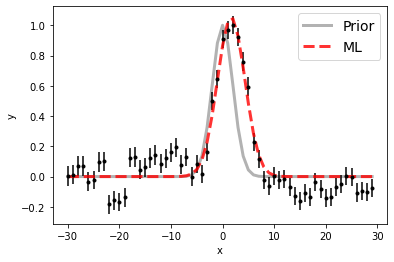

100%|██████████| 15000/15000 [00:20<00:00, 747.20it/s]


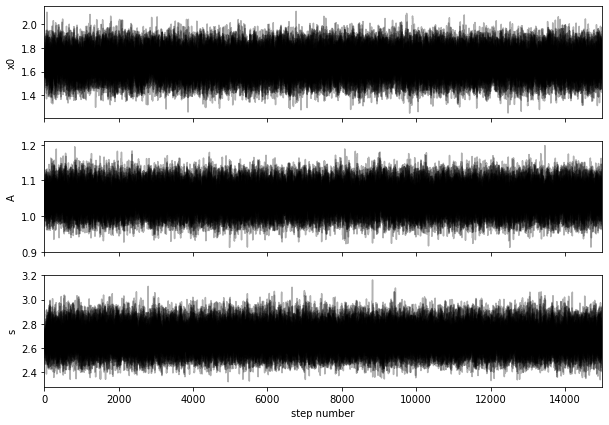

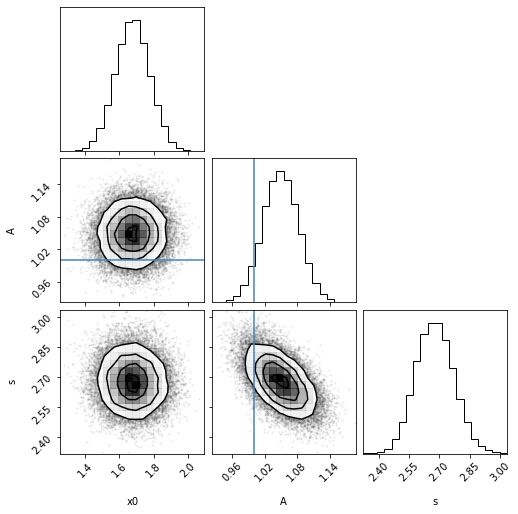

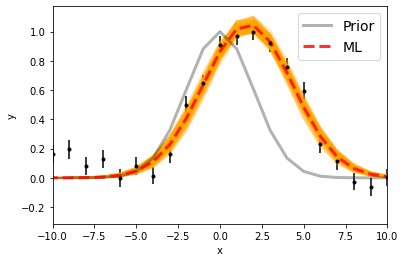

Maximum likelihood estimates:
x0 = 1.674
A = 1.051
s = 2.671


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x0 =  4862.675350313211 [0.09981748 0.0998565 ]
A  =  5.803392676582037e-17 [1.79104253e-18 1.83398302e-18]
s  =  2.6759717939227547 [0.09184476 0.09441746]

-------------------------------------------------------------------------------------------

Ajuste en 5007 nm:

Parámetros reales:
1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


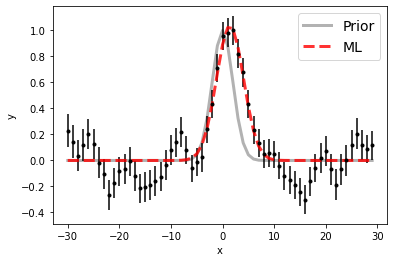

100%|██████████| 15000/15000 [00:21<00:00, 700.28it/s]


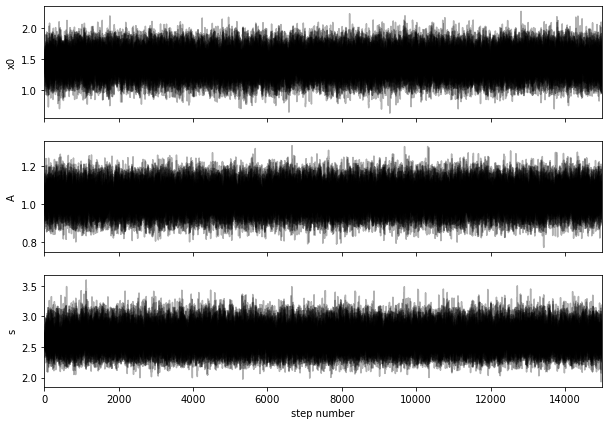

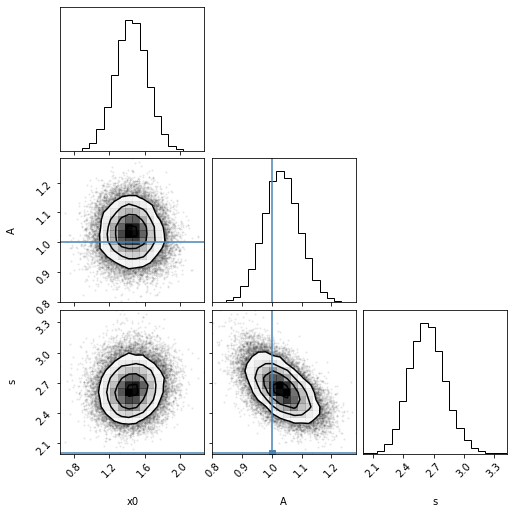

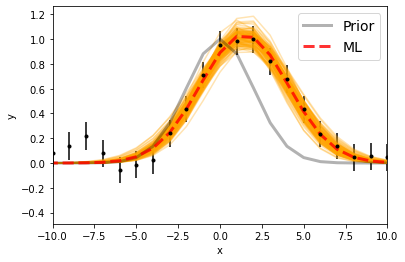

Maximum likelihood estimates:
x0 = 1.449
A = 1.037
s = 2.624


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x0 =  5008.448772776751 [0.18148566 0.18117489]
A  =  2.990155474926368e-17 [1.73957152e-18 1.78352295e-18]
s  =  2.6337205498258256 [0.16973757 0.18073763]

-------------------------------------------------------------------------------------------

Ajuste en 6563 nm:

Parámetros reales:
1.0 1.0 1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


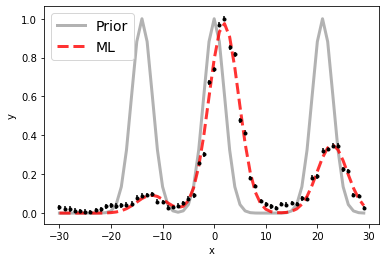

100%|██████████| 15000/15000 [00:32<00:00, 459.07it/s]


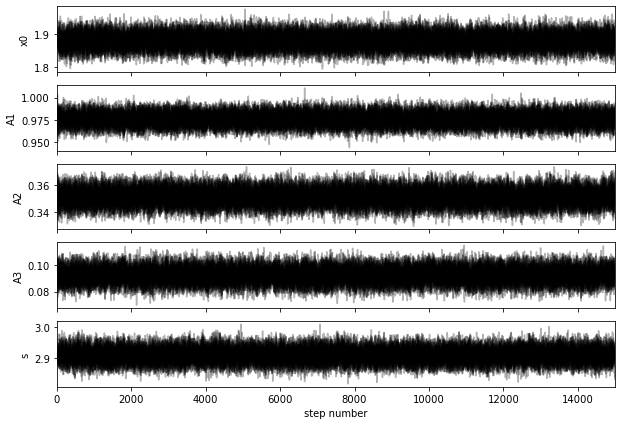

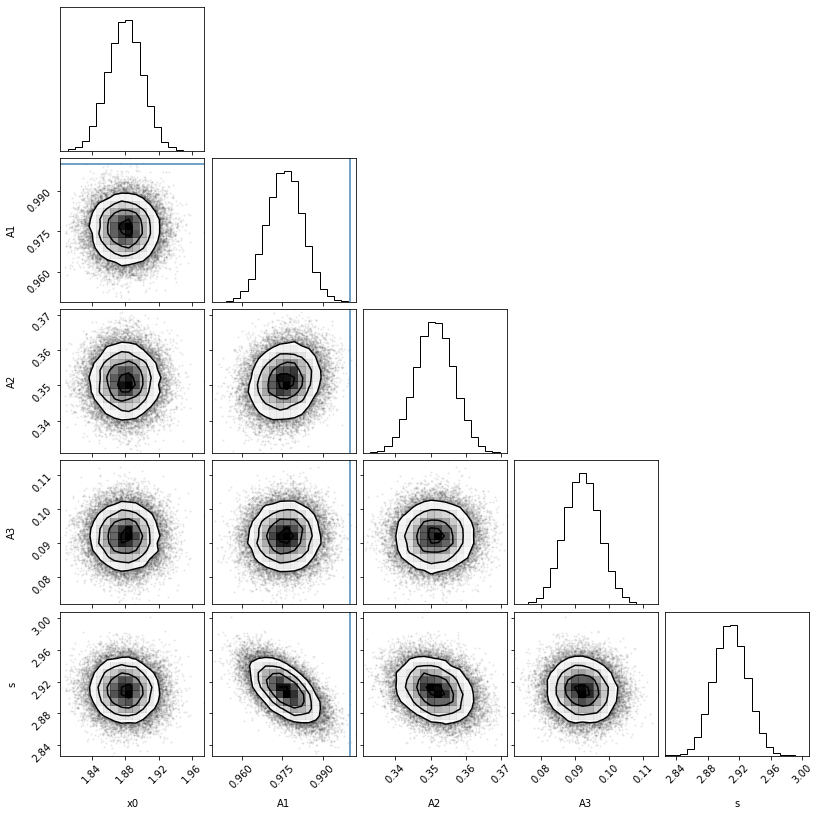

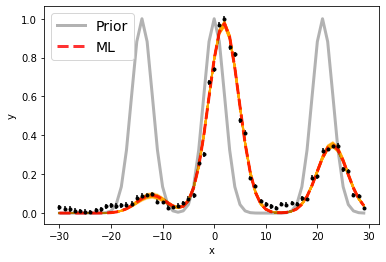

Maximum likelihood estimates:
x0 = 1.880
A1 = 0.976
A2 = 0.351
A3 = 0.092
s = 2.909


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x01, x02 =  6564.879888768933 6585.879888768933 [0.02088967 0.02044363]
A1, A2   =  1.9182331795255264e-16 6.902540179984167e-17 [1.31343677e-18 1.28689247e-18] [1.05971314e-18 1.05304348e-18]
s  =  2.908981435137058 [0.02082688 0.02111514]

-------------------------------------------------------------------------------------------

///////////////////////////////////////////////////////////////////////////////////////////


AJUSTANDO ESPECTRO 7

Ajuste en 4861 nm:

Parámetros reales:
1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


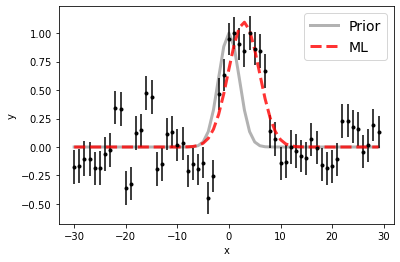

100%|██████████| 15000/15000 [00:19<00:00, 762.51it/s]


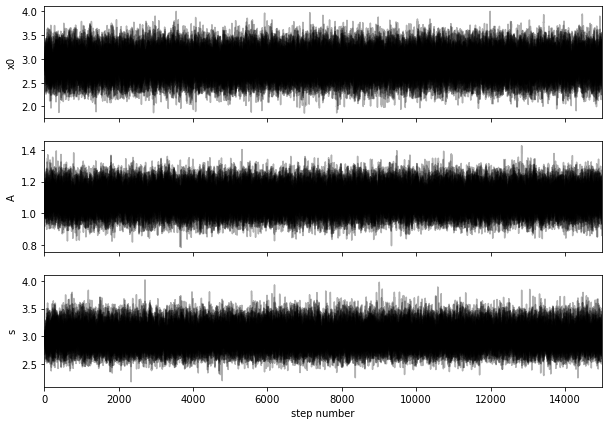

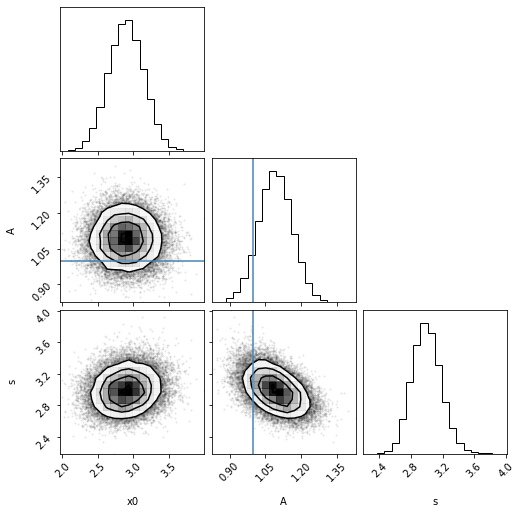

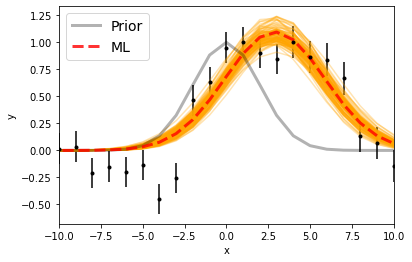

Maximum likelihood estimates:
x0 = 2.896
A = 1.096
s = 2.984


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x0 =  4863.895883122702 [0.24812061 0.24884508]
A  =  3.2631882024852517e-17 [2.06586107e-18 2.12232814e-18]
s  =  2.9898244575968356 [0.1771198 0.1852531]

-------------------------------------------------------------------------------------------

Ajuste en 5007 nm:

Parámetros reales:
1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


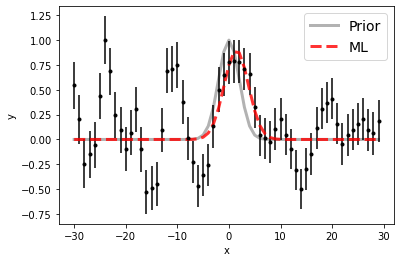

100%|██████████| 15000/15000 [00:19<00:00, 787.61it/s]


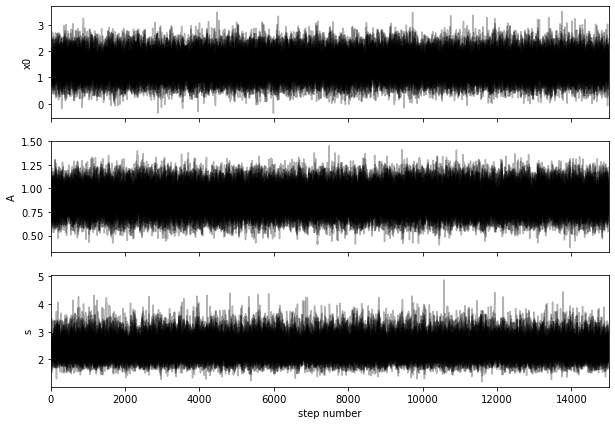

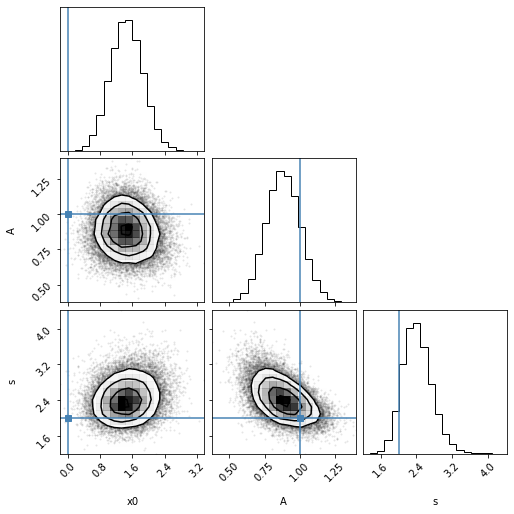

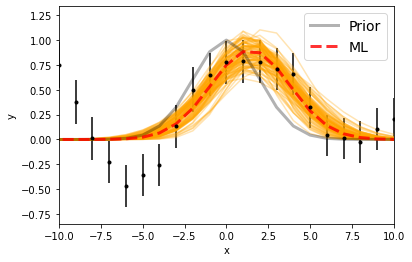

Maximum likelihood estimates:
x0 = 1.429
A = 0.898
s = 2.370


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x0 =  5008.451117385624 [0.39850133 0.40918537]
A  =  1.665516924118053e-17 [2.25453550e-18 2.32725292e-18]
s  =  2.3926219534535065 [0.29403342 0.34338106]

-------------------------------------------------------------------------------------------

Ajuste en 6563 nm:

Parámetros reales:
1.0 1.0 1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


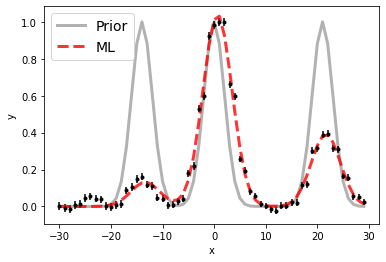

100%|██████████| 15000/15000 [00:28<00:00, 517.52it/s]


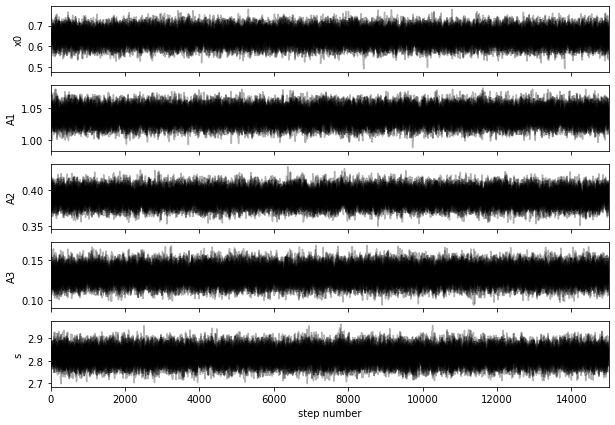

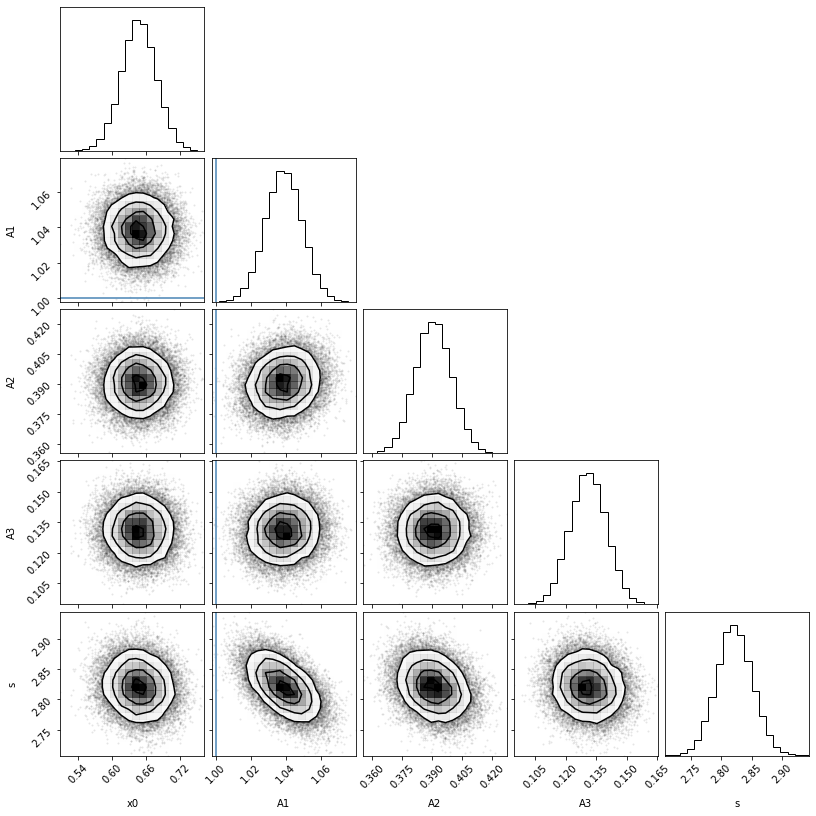

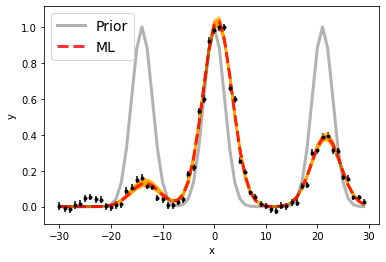

Maximum likelihood estimates:
x0 = 0.647
A1 = 1.038
A2 = 0.391
A3 = 0.131
s = 2.822


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x01, x02 =  6563.647269884953 6584.647269884953 [0.03054494 0.03071172]
A1, A2   =  1.3320664522937113e-16 5.010073657269309e-17 [1.34567987e-18 1.34329909e-18] [1.16207278e-18 1.16514711e-18]
s  =  2.821024308740305 [0.02878074 0.03000337]

-------------------------------------------------------------------------------------------

///////////////////////////////////////////////////////////////////////////////////////////


AJUSTANDO ESPECTRO 8

Ajuste en 4861 nm:

Parámetros reales:
1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


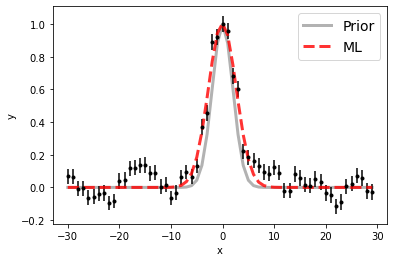

100%|██████████| 15000/15000 [00:18<00:00, 806.38it/s]


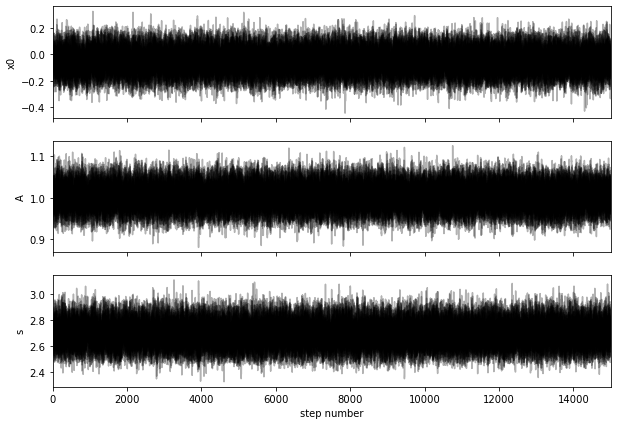

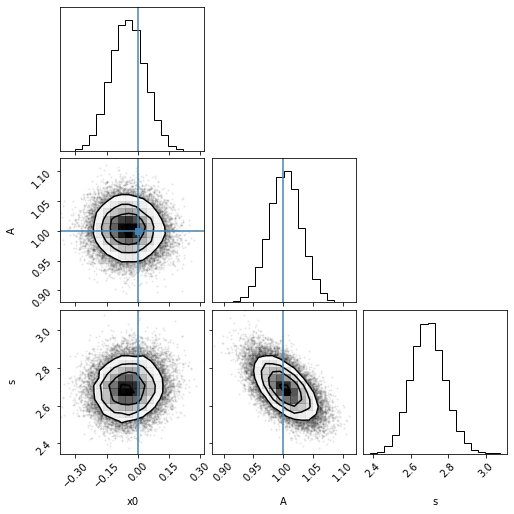

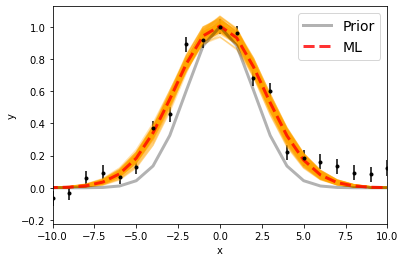

Maximum likelihood estimates:
x0 = -0.048
A = 1.004
s = 2.688


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x0 =  4860.951569696264 [0.0822534  0.08424147]
A  =  1.0210842913346751e-16 [2.75225357e-18 2.77335037e-18]
s  =  2.691594157175806 [0.0862772  0.08966607]

-------------------------------------------------------------------------------------------

Ajuste en 5007 nm:

Parámetros reales:
1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


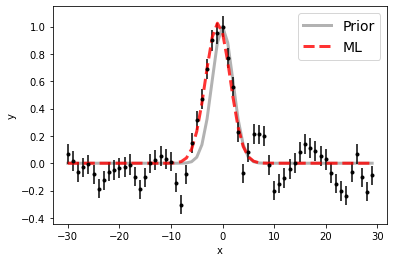

100%|██████████| 15000/15000 [00:18<00:00, 800.88it/s]


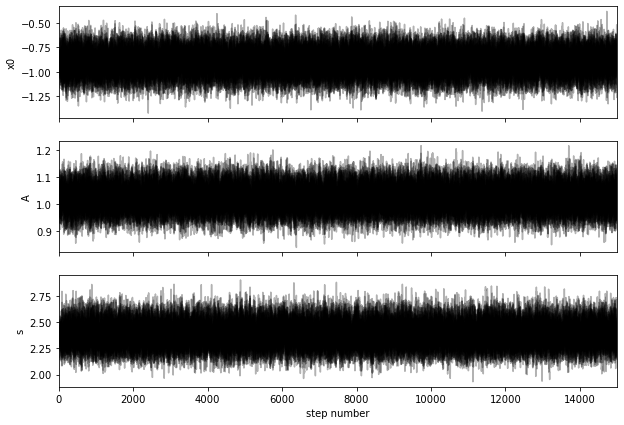

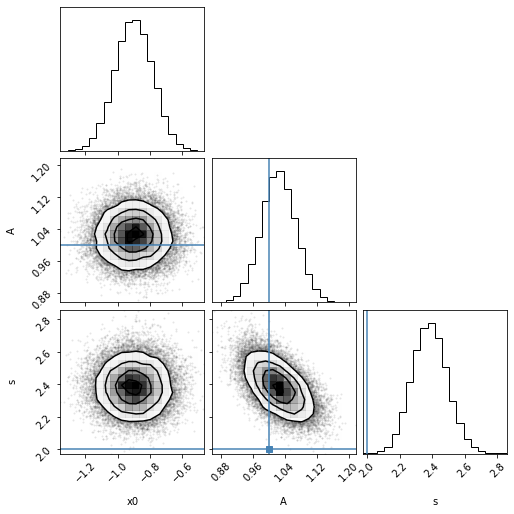

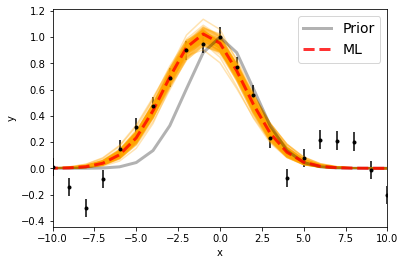

Maximum likelihood estimates:
x0 = -0.903
A = 1.025
s = 2.379


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x0 =  5006.098565727062 [0.11656964 0.11766236]
A  =  6.238551700331024e-17 [2.57083228e-18 2.64761092e-18]
s  =  2.382927683752733 [0.10608381 0.10807998]

-------------------------------------------------------------------------------------------

Ajuste en 6563 nm:

Parámetros reales:
1.0 1.0 1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


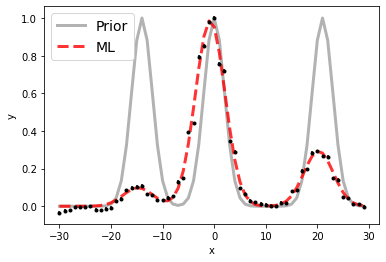

100%|██████████| 15000/15000 [00:29<00:00, 516.92it/s]


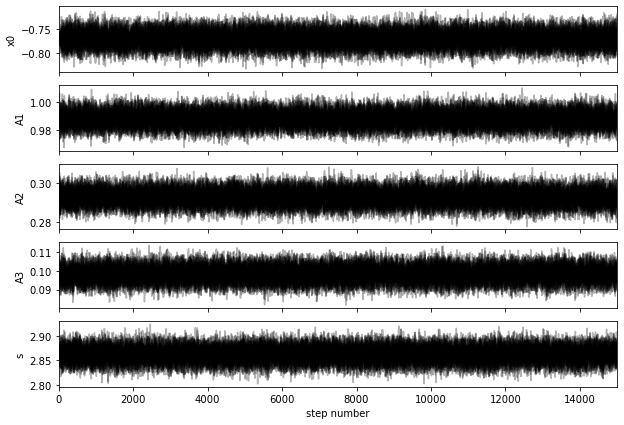

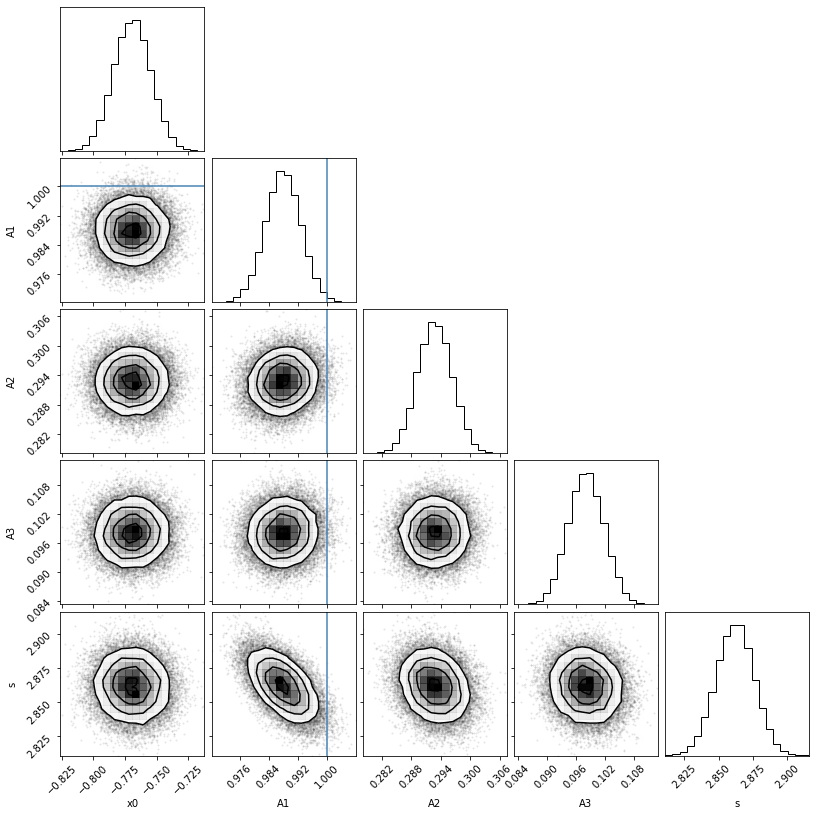

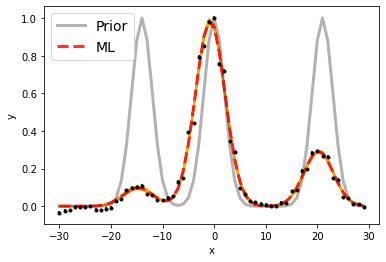

Maximum likelihood estimates:
x0 = -0.770
A1 = 0.988
A2 = 0.293
A3 = 0.098
s = 2.862


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x01, x02 =  6562.230582929827 6583.230582929827 [0.01465944 0.01451331]
A1, A2   =  3.1428246241990937e-16 9.312357067600162e-17 [1.53226336e-18 1.55635948e-18] [1.10921712e-18 1.12225332e-18]
s  =  2.8620543914408776 [0.0138569  0.01366646]

-------------------------------------------------------------------------------------------

///////////////////////////////////////////////////////////////////////////////////////////


AJUSTANDO ESPECTRO 9

Ajuste en 4861 nm:

Parámetros reales:
1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


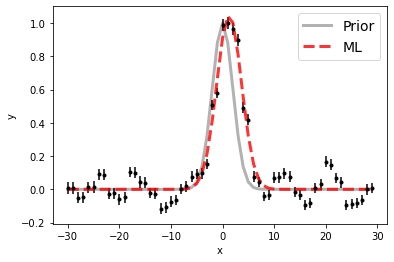

100%|██████████| 15000/15000 [00:18<00:00, 798.36it/s]


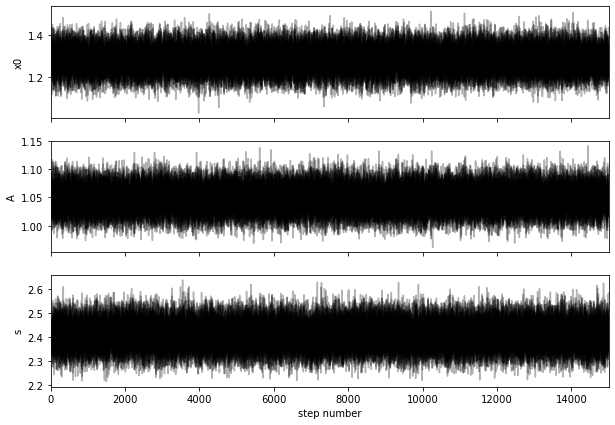

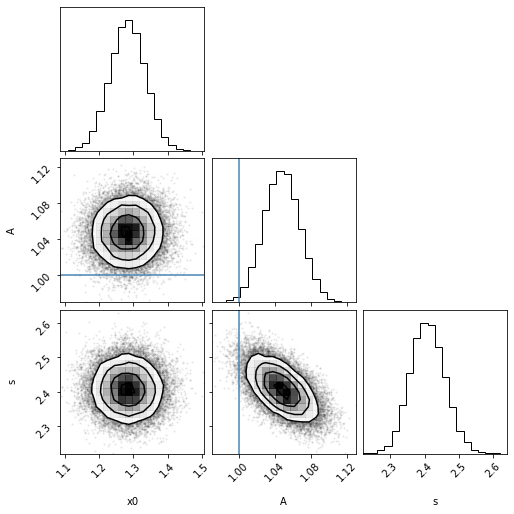

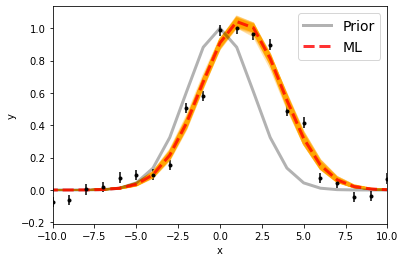

Maximum likelihood estimates:
x0 = 1.283
A = 1.048
s = 2.408


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x0 =  4862.283821439007 [0.05217396 0.05130397]
A  =  2.005706312163409e-16 [3.83346911e-18 3.87592693e-18]
s  =  2.4080305343494453 [0.04907064 0.05112122]

-------------------------------------------------------------------------------------------

Ajuste en 5007 nm:

Parámetros reales:
1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


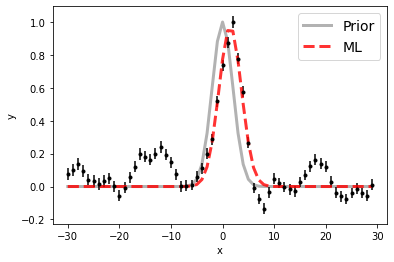

100%|██████████| 15000/15000 [00:18<00:00, 801.30it/s]


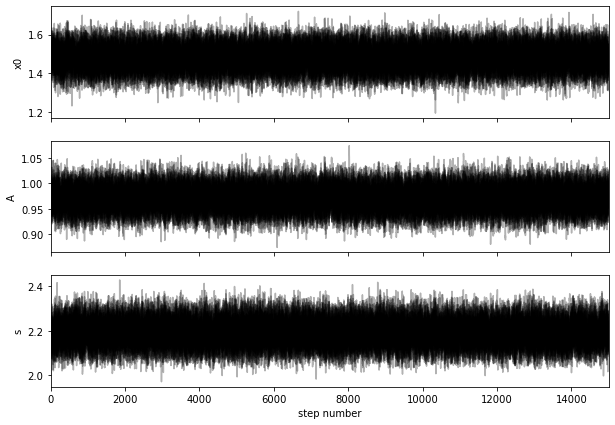

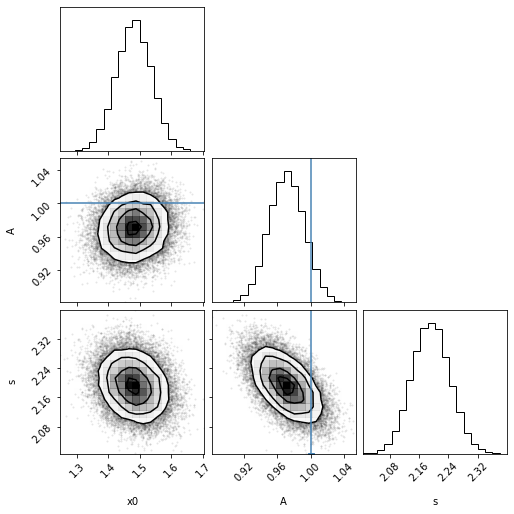

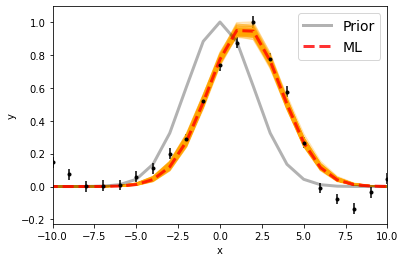

Maximum likelihood estimates:
x0 = 1.480
A = 0.971
s = 2.190


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x0 =  5008.480125939427 [0.05645571 0.05570713]
A  =  1.7255835924928102e-16 [3.74779284e-18 3.75960170e-18]
s  =  2.1922216511479955 [0.05134071 0.05162816]

-------------------------------------------------------------------------------------------

Ajuste en 6563 nm:

Parámetros reales:
1.0 1.0 1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


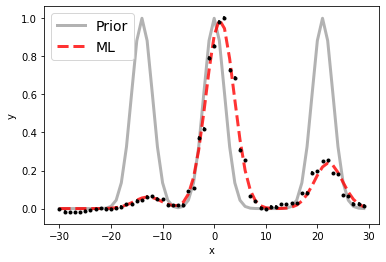

100%|██████████| 15000/15000 [00:28<00:00, 520.62it/s]


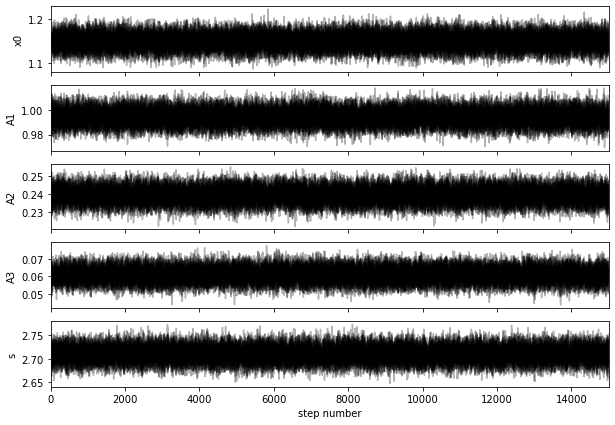

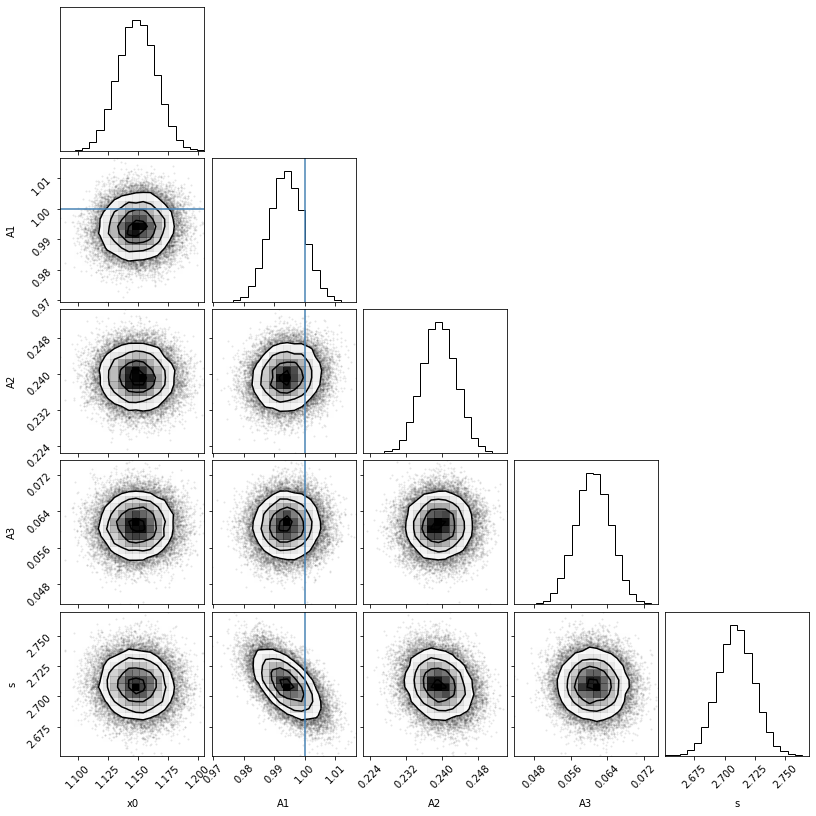

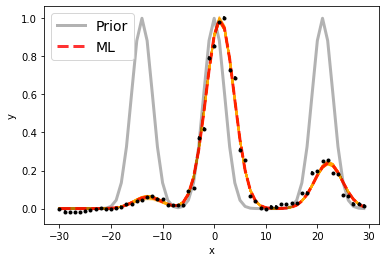

Maximum likelihood estimates:
x0 = 1.149
A1 = 0.994
A2 = 0.239
A3 = 0.061
s = 2.710


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x01, x02 =  6564.14897121508 6585.14897121508 [0.01593915 0.01556796]
A1, A2   =  5.236302750868394e-16 1.2605834814279263e-16 [2.91994296e-18 2.99888015e-18] [1.96587406e-18 2.01520461e-18]
s  =  2.709442851651337 [0.0146246  0.01472342]

-------------------------------------------------------------------------------------------

///////////////////////////////////////////////////////////////////////////////////////////


AJUSTANDO ESPECTRO 10

Ajuste en 4861 nm:

Parámetros reales:
1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


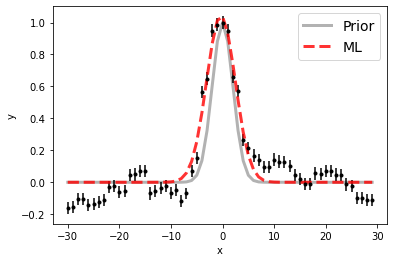

100%|██████████| 15000/15000 [00:18<00:00, 802.82it/s]


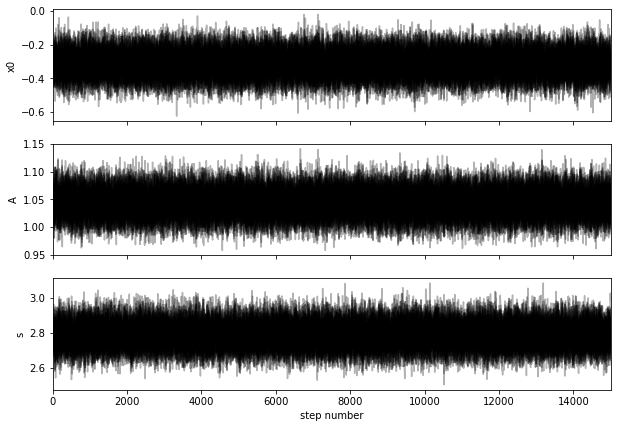

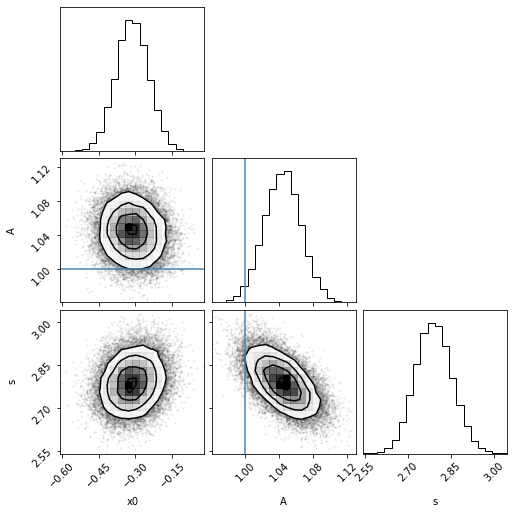

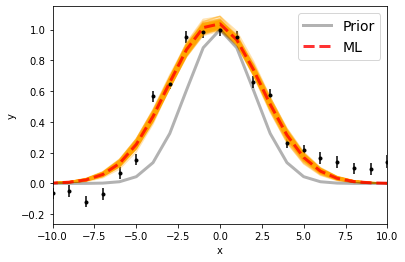

Maximum likelihood estimates:
x0 = -0.315
A = 1.044
s = 2.785


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x0 =  4860.686409891755 [0.06488088 0.06625272]
A  =  7.948304915441852e-17 [1.65866554e-18 1.62619812e-18]
s  =  2.78796467756597 [0.06299731 0.06469082]

-------------------------------------------------------------------------------------------

Ajuste en 5007 nm:

Parámetros reales:
1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


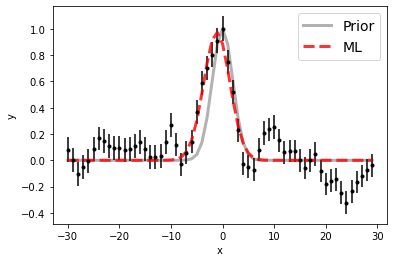

100%|██████████| 15000/15000 [00:18<00:00, 794.20it/s]


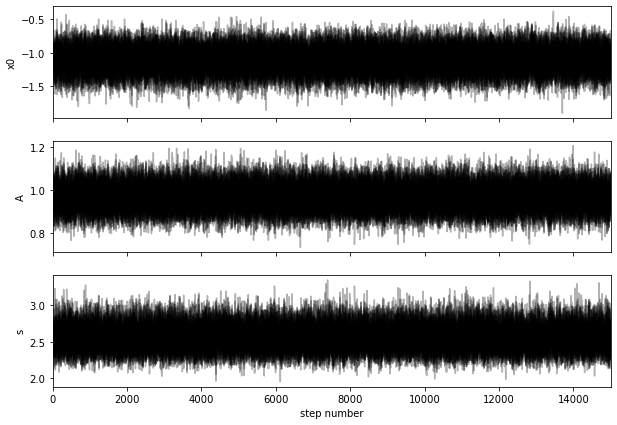

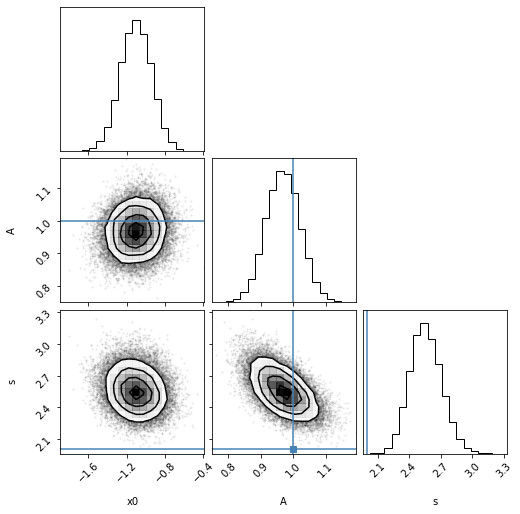

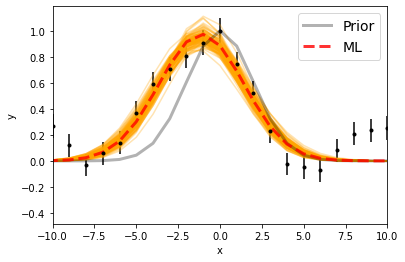

Maximum likelihood estimates:
x0 = -1.105
A = 0.973
s = 2.542


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x0 =  5005.894028137141 [0.16100312 0.16209599]
A  =  3.019708505233961e-17 [1.62664672e-18 1.64417354e-18]
s  =  2.552042785244907 [0.14249969 0.15726936]

-------------------------------------------------------------------------------------------

Ajuste en 6563 nm:

Parámetros reales:
1.0 1.0 1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


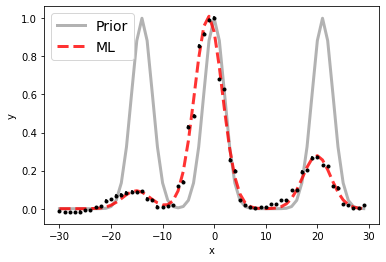

100%|██████████| 15000/15000 [00:28<00:00, 525.47it/s]


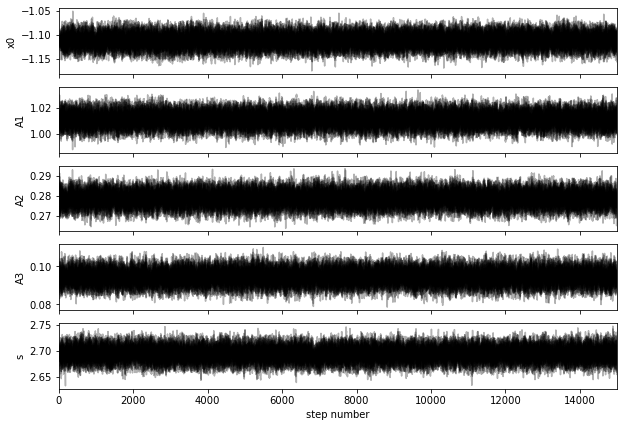

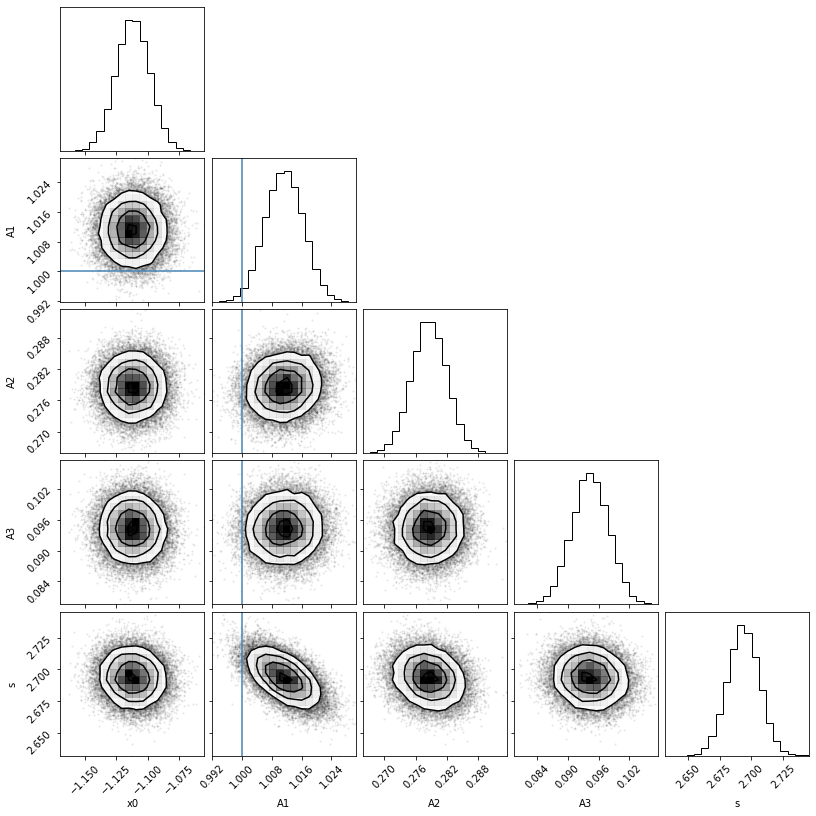

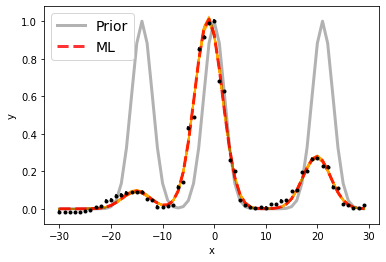

Maximum likelihood estimates:
x0 = -1.112
A1 = 1.011
A2 = 0.279
A3 = 0.094
s = 2.693


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x01, x02 =  6561.888038056608 6582.888038056608 [0.01313728 0.01335285]
A1, A2   =  2.696907530643682e-16 7.42991373521137e-17 [1.36136018e-18 1.38198993e-18] [8.87142142e-19 9.01196779e-19]
s  =  2.69353937023425 [0.01242089 0.01245849]

-------------------------------------------------------------------------------------------

///////////////////////////////////////////////////////////////////////////////////////////


AJUSTANDO ESPECTRO 11

Ajuste en 4861 nm:

Parámetros reales:
1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


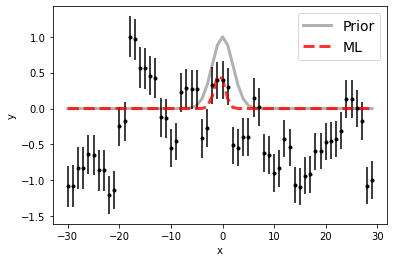

100%|██████████| 15000/15000 [00:15<00:00, 989.68it/s] 


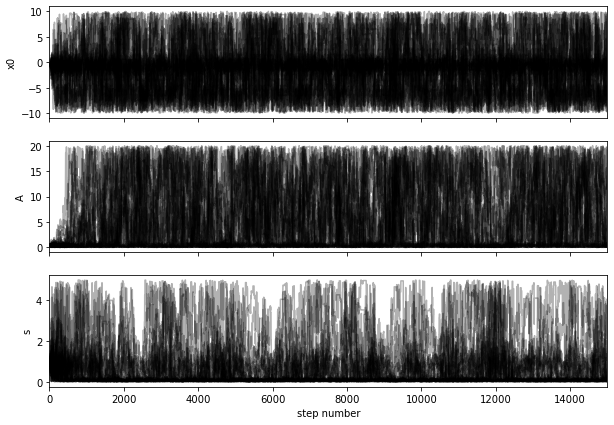

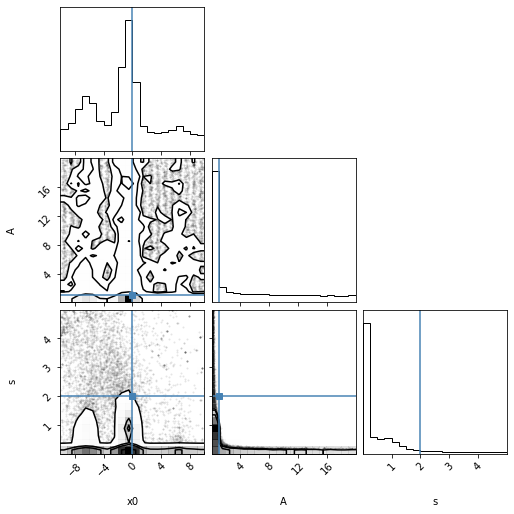

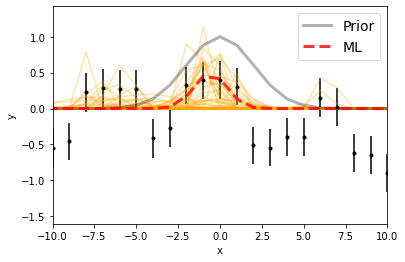

Maximum likelihood estimates:
x0 = -0.578
A = 0.493
s = 0.981


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x0 =  4860.027927221364 [5.50793094 4.78761017]
A  =  1.752815690712197e-17 [1.55428412e-17 1.22834609e-16]
s  =  0.152853551789761 [0.11785884 1.09480658]

-------------------------------------------------------------------------------------------

Ajuste en 5007 nm:

Parámetros reales:
1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


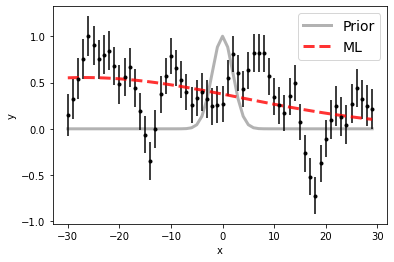

  0%|          | 0/15000 [00:00<?, ?it/s]C:\Users\saruk\anaconda3\lib\site-packages\emcee\moves\red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
100%|██████████| 15000/15000 [00:09<00:00, 1597.17it/s]


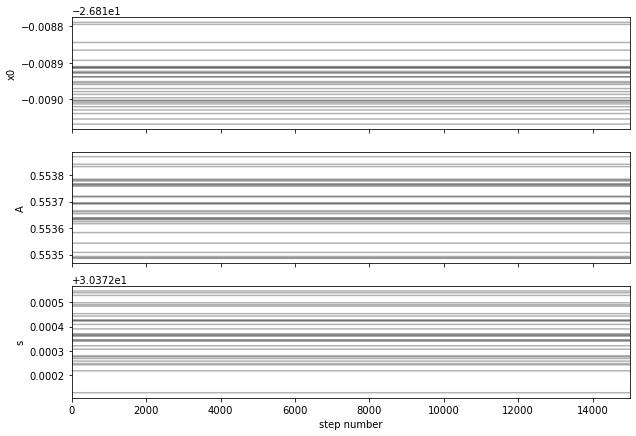

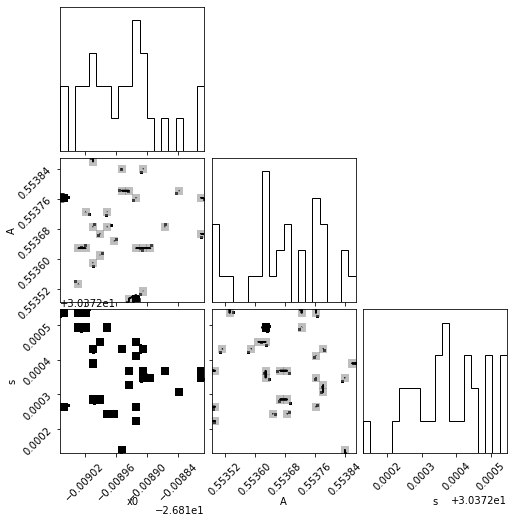

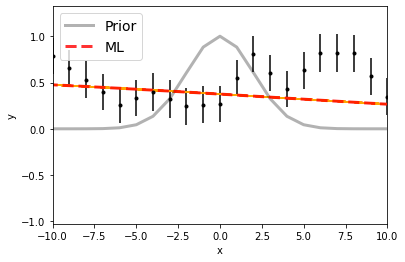

Maximum likelihood estimates:
x0 = -26.819
A = 0.554
s = 30.372


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x0 =  4980.181047064879 [6.65926128e-05 5.96478124e-05]
A  =  7.29285785781903e-18 [1.78243865e-21 1.35366452e-21]
s  =  30.37236528256644 [0.00010653 0.00012385]

-------------------------------------------------------------------------------------------

Ajuste en 6563 nm:

Parámetros reales:
1.0 1.0 1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


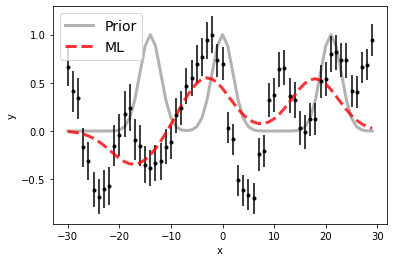

100%|██████████| 15000/15000 [00:27<00:00, 547.37it/s]


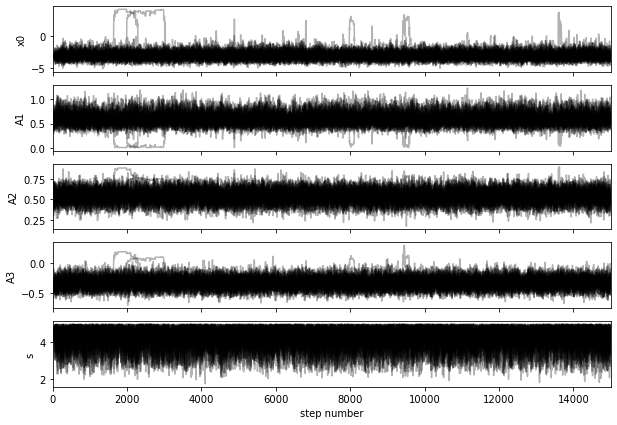

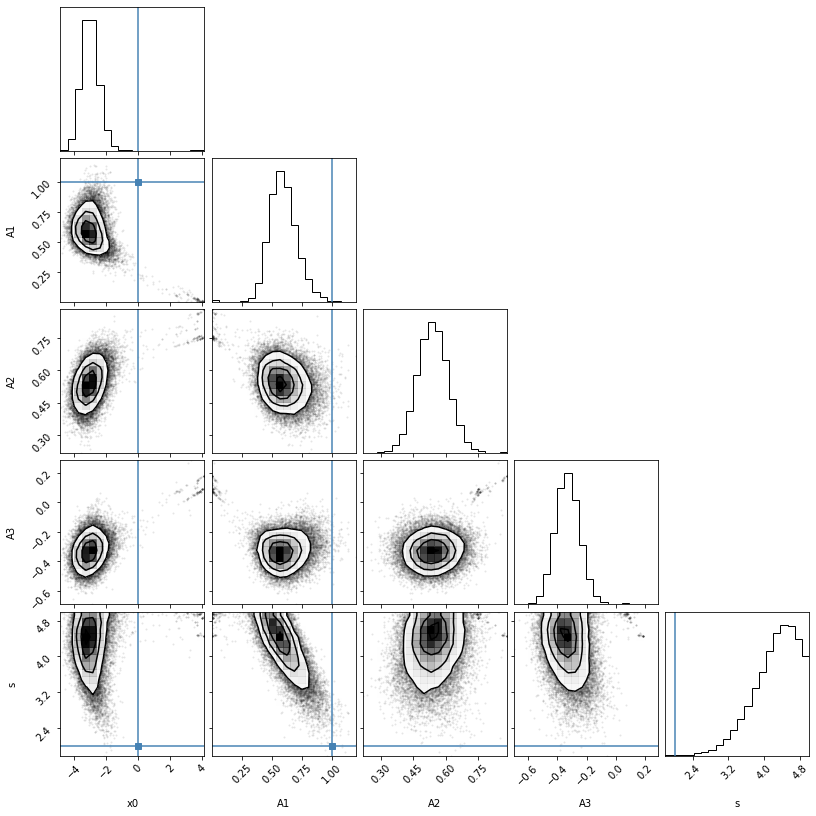

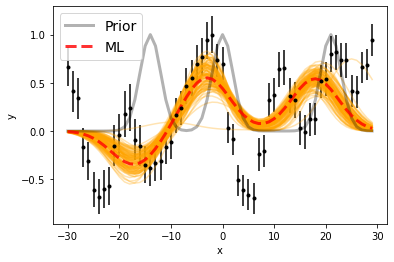

Maximum likelihood estimates:
x0 = -3.082
A1 = 0.555
A2 = 0.542
A3 = -0.349
s = 4.541


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x01, x02 =  6559.97466472727 6580.97466472727 [0.50975663 0.55342971]
A1, A2   =  6.11984651998441e-18 5.618983071011355e-18 [1.05605848e-18 1.24481718e-18] [7.34220094e-19 7.40838596e-19]
s  =  4.3229068949574305 [0.58268143 0.42810165]

-------------------------------------------------------------------------------------------

///////////////////////////////////////////////////////////////////////////////////////////


AJUSTANDO ESPECTRO 12

Ajuste en 4861 nm:

Parámetros reales:
1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


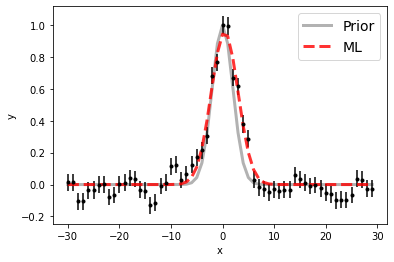

100%|██████████| 15000/15000 [00:19<00:00, 787.70it/s]


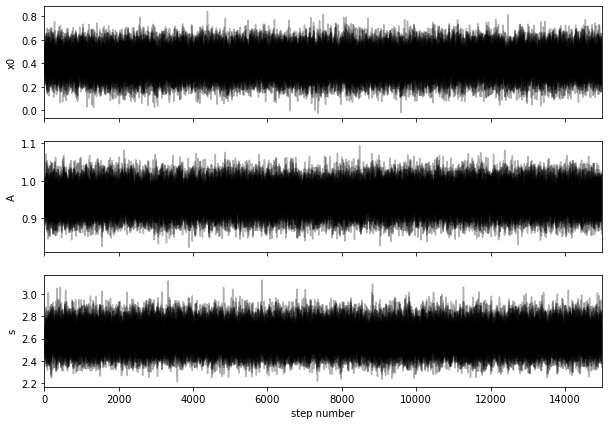

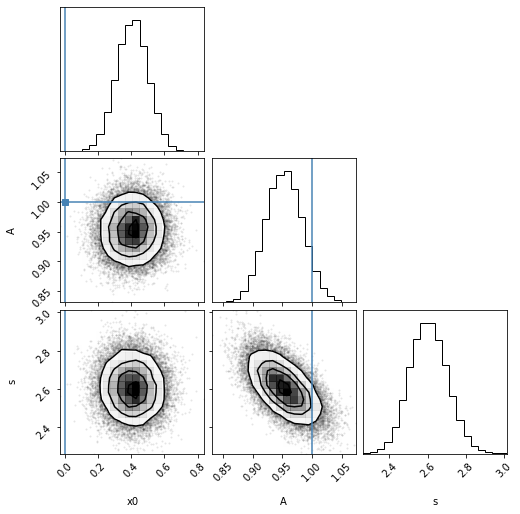

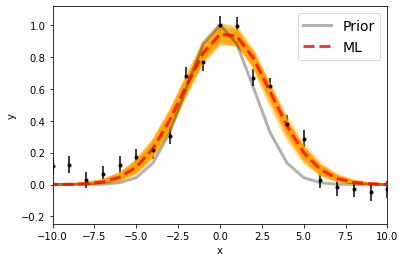

Maximum likelihood estimates:
x0 = 0.409
A = 0.954
s = 2.600


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x0 =  4861.407501562641 [0.09570721 0.09397487]
A  =  7.036956501662658e-17 [2.26552938e-18 2.30328364e-18]
s  =  2.6038065026498542 [0.09653872 0.10052798]

-------------------------------------------------------------------------------------------

Ajuste en 5007 nm:

Parámetros reales:
1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


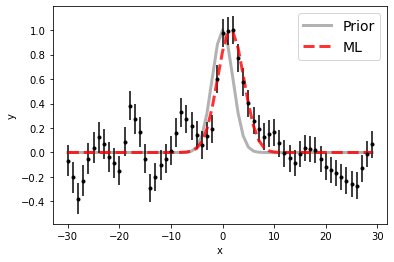

100%|██████████| 15000/15000 [00:18<00:00, 814.96it/s]


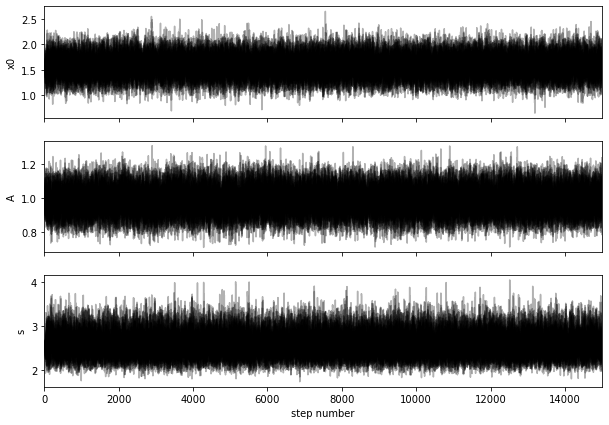

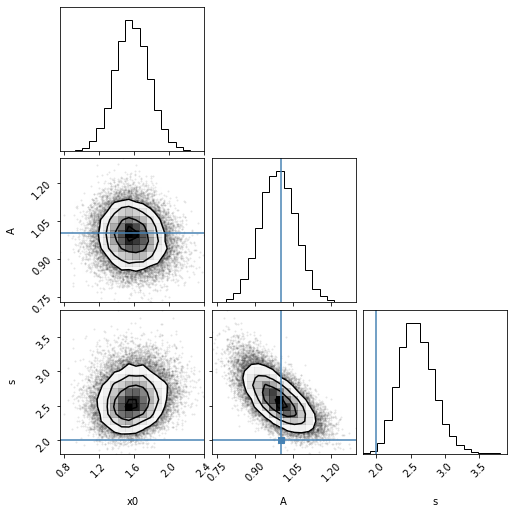

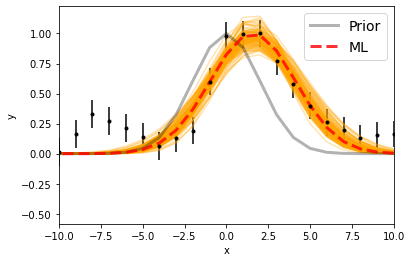

Maximum likelihood estimates:
x0 = 1.577
A = 1.001
s = 2.530


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x0 =  5008.576281821521 [0.18998014 0.19621609]
A  =  3.11886913544178e-17 [2.20785071e-18 2.27082724e-18]
s  =  2.574858756695029 [0.23078399 0.26215357]

-------------------------------------------------------------------------------------------

Ajuste en 6563 nm:

Parámetros reales:
1.0 1.0 1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


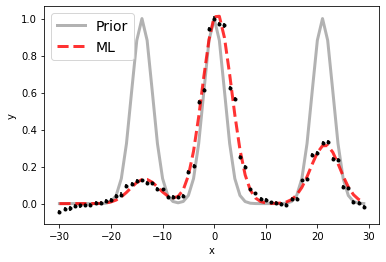

100%|██████████| 15000/15000 [00:28<00:00, 531.99it/s]


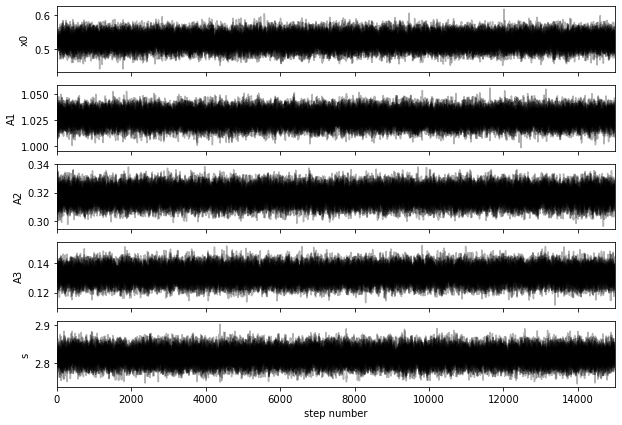

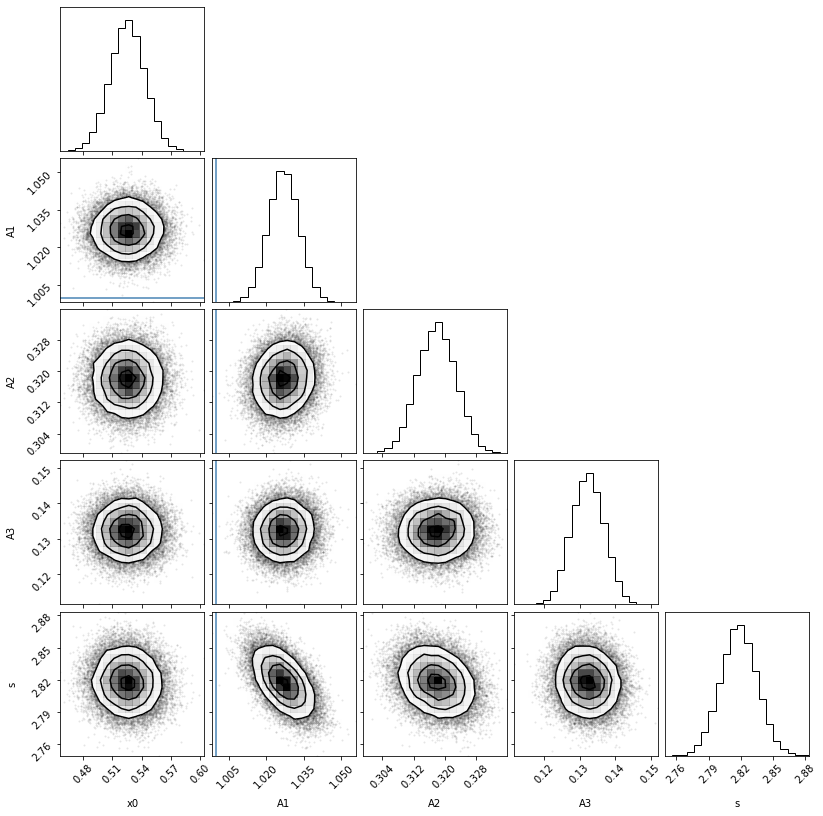

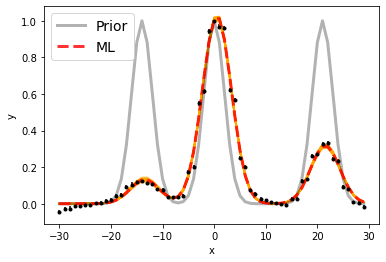

Maximum likelihood estimates:
x0 = 0.525
A1 = 1.027
A2 = 0.318
A3 = 0.132
s = 2.818


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x01, x02 =  6563.525407644314 6584.525407644314 [0.01788558 0.01767267]
A1, A2   =  2.300334518766456e-16 7.121209141017914e-17 [1.35538322e-18 1.36857544e-18] [1.10970761e-18 1.09104913e-18]
s  =  2.818046649930129 [0.01672642 0.0169761 ]

-------------------------------------------------------------------------------------------

///////////////////////////////////////////////////////////////////////////////////////////


AJUSTANDO ESPECTRO 13

Ajuste en 4861 nm:

Parámetros reales:
1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


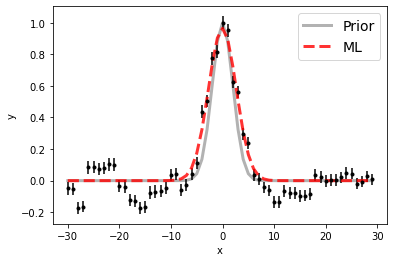

100%|██████████| 15000/15000 [00:18<00:00, 809.90it/s]


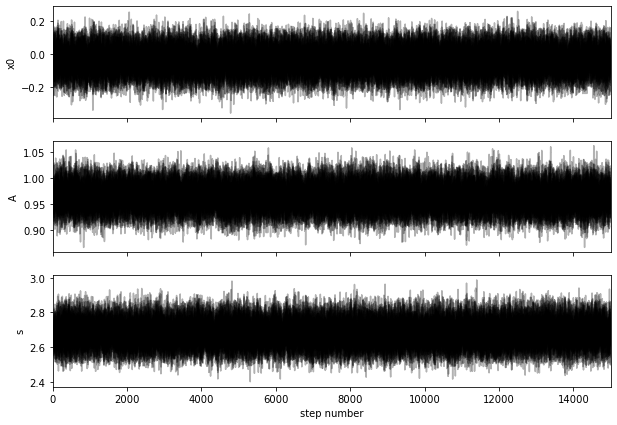

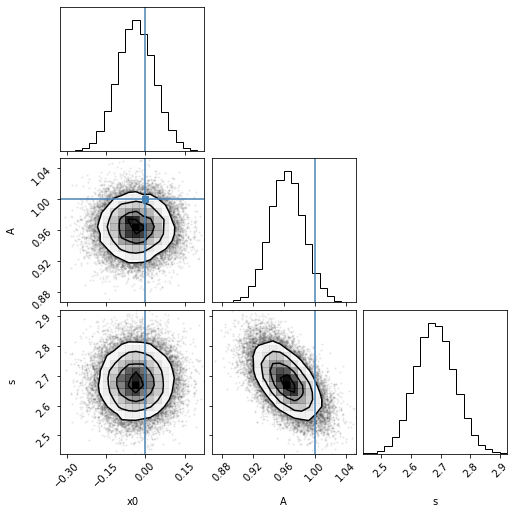

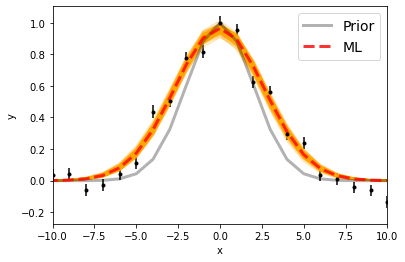

Maximum likelihood estimates:
x0 = -0.036
A = 0.964
s = 2.680


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x0 =  4860.96304840545 [0.06941103 0.07143039]
A  =  1.4002010639053612e-16 [3.15794247e-18 3.20898992e-18]
s  =  2.6800943125361254 [0.06485933 0.06775698]

-------------------------------------------------------------------------------------------

Ajuste en 5007 nm:

Parámetros reales:
1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


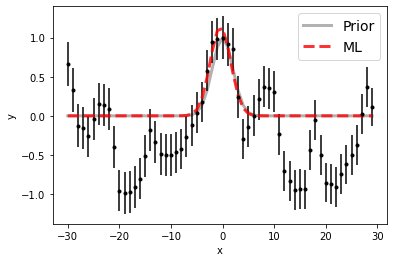

100%|██████████| 15000/15000 [00:18<00:00, 813.43it/s]


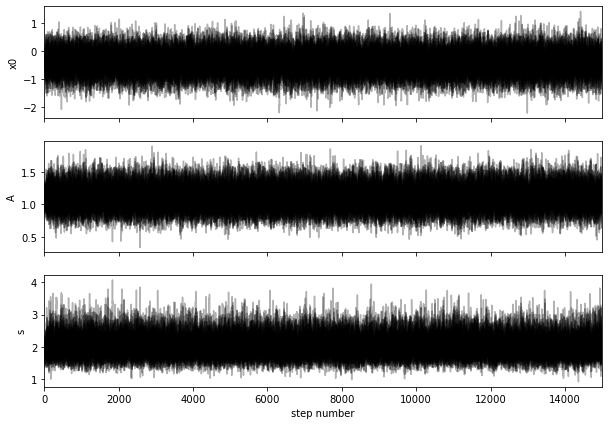

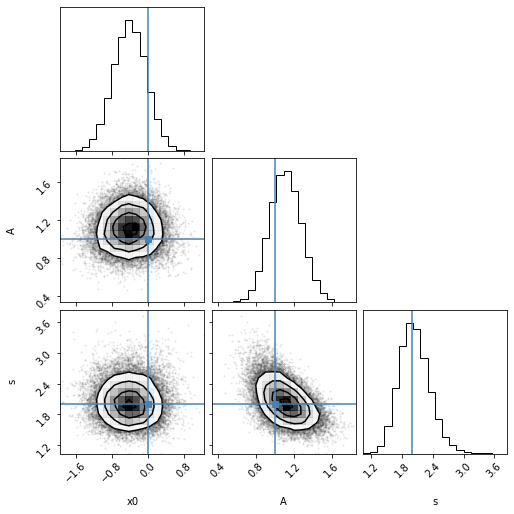

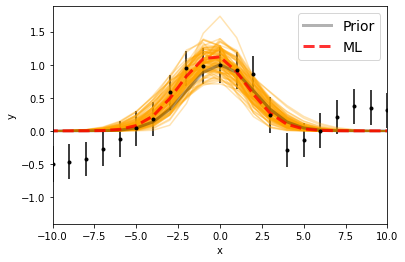

Maximum likelihood estimates:
x0 = -0.404
A = 1.141
s = 1.992


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x0 =  5006.598089144032 [0.36770927 0.36874662]
A  =  2.170717444004882e-17 [3.21869955e-18 3.30656718e-18]
s  =  2.0204431594493153 [0.27236087 0.3106931 ]

-------------------------------------------------------------------------------------------

Ajuste en 6563 nm:

Parámetros reales:
1.0 1.0 1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


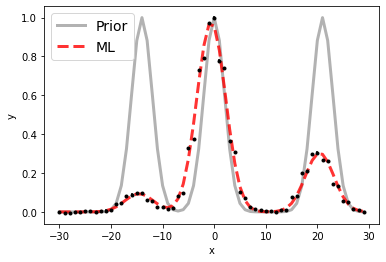

100%|██████████| 15000/15000 [00:28<00:00, 521.40it/s]


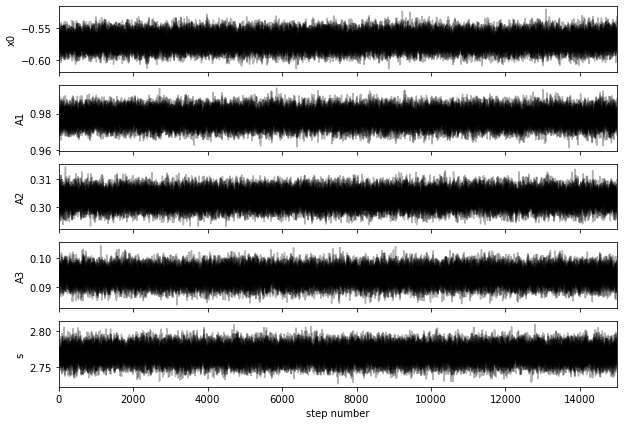

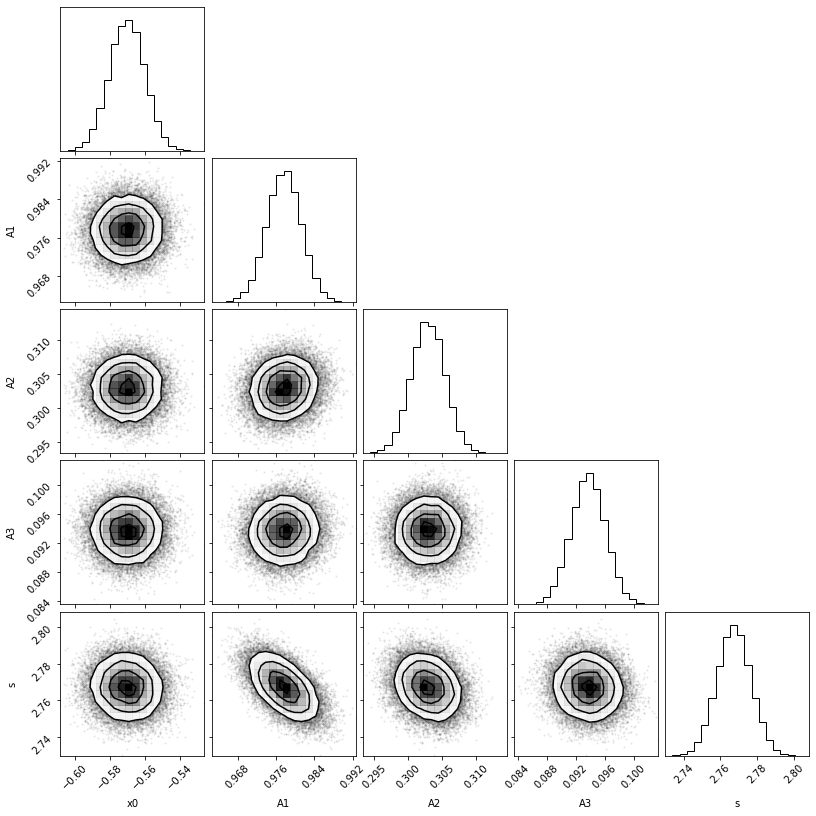

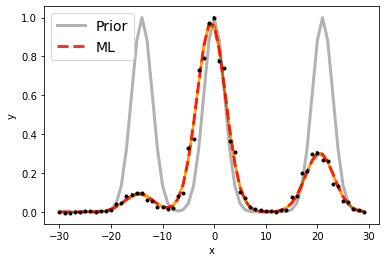

Maximum likelihood estimates:
x0 = -0.570
A1 = 0.978
A2 = 0.303
A3 = 0.094
s = 2.767


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x01, x02 =  6562.429856056993 6583.429856056993 [0.01015237 0.00998107]
A1, A2   =  5.953055810747857e-16 1.8441114440251802e-16 [2.20192227e-18 2.17153124e-18] [1.51235239e-18 1.49672354e-18]
s  =  2.767362255339309 [0.00915698 0.00924249]

-------------------------------------------------------------------------------------------

///////////////////////////////////////////////////////////////////////////////////////////


AJUSTANDO ESPECTRO 14

Ajuste en 4861 nm:

Parámetros reales:
1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


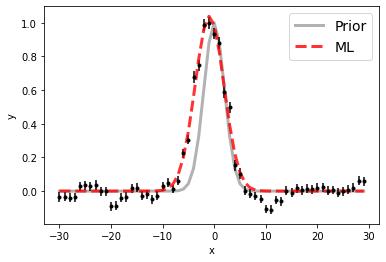

100%|██████████| 15000/15000 [00:18<00:00, 816.47it/s]


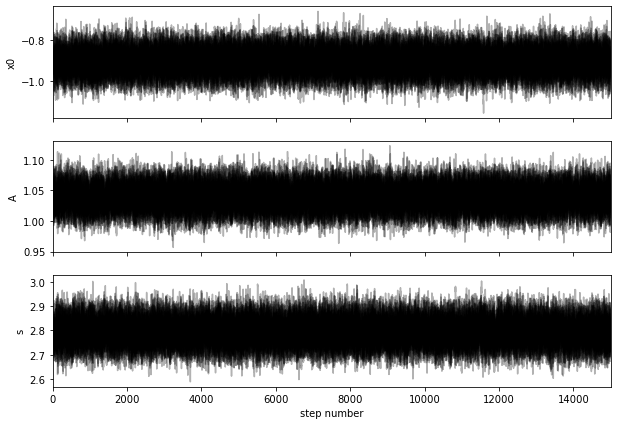

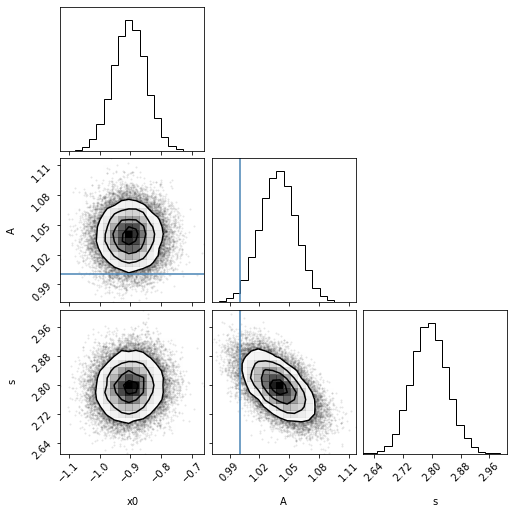

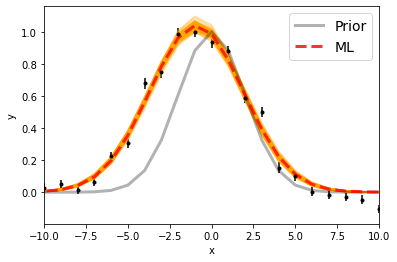

Maximum likelihood estimates:
x0 = -0.903
A = 1.039
s = 2.794


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x0 =  4860.097138896185 [0.05381475 0.0528903 ]
A  =  1.4417906557277416e-16 [2.52677121e-18 2.52958044e-18]
s  =  2.793951293675418 [0.04814214 0.04912864]

-------------------------------------------------------------------------------------------

Ajuste en 5007 nm:

Parámetros reales:
1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


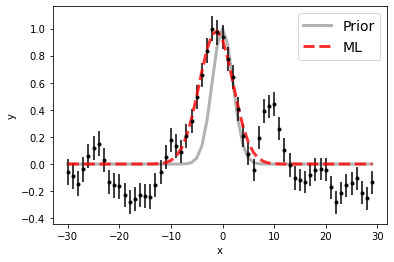

100%|██████████| 15000/15000 [00:18<00:00, 814.81it/s]


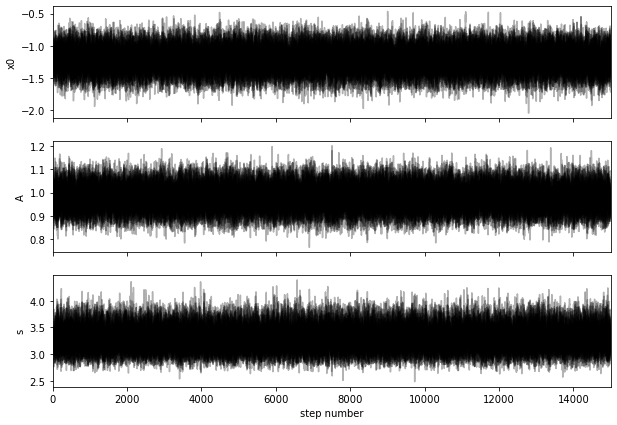

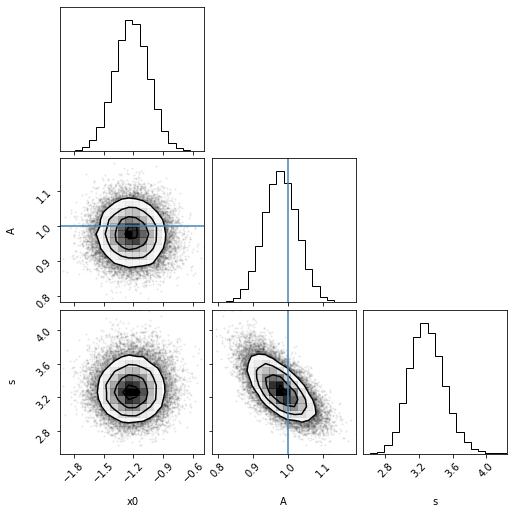

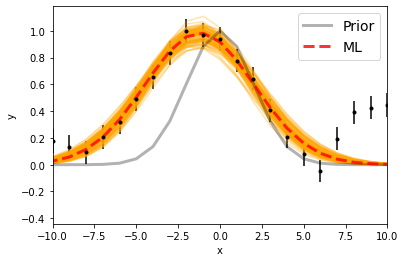

Maximum likelihood estimates:
x0 = -1.223
A = 0.984
s = 3.262


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x0 =  5005.78063698389 [0.16962043 0.17069703]
A  =  3.892617814240876e-17 [1.90453476e-18 1.93143264e-18]
s  =  3.2858125075881444 [0.19226708 0.2144534 ]

-------------------------------------------------------------------------------------------

Ajuste en 6563 nm:

Parámetros reales:
1.0 1.0 1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


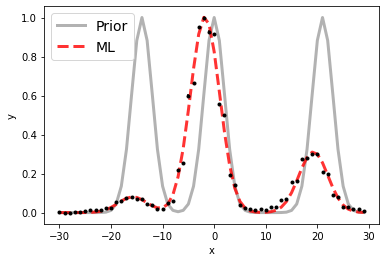

100%|██████████| 15000/15000 [00:28<00:00, 525.94it/s]


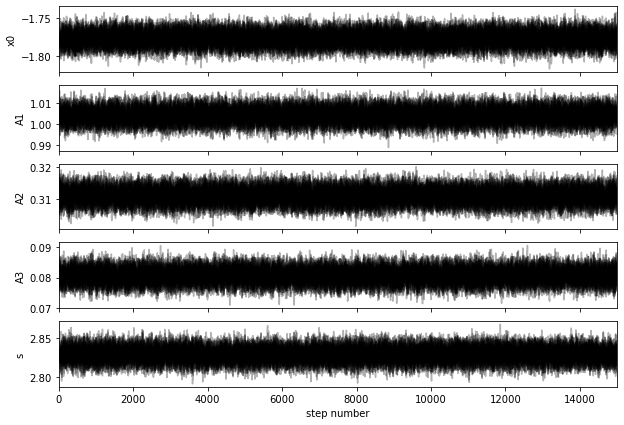

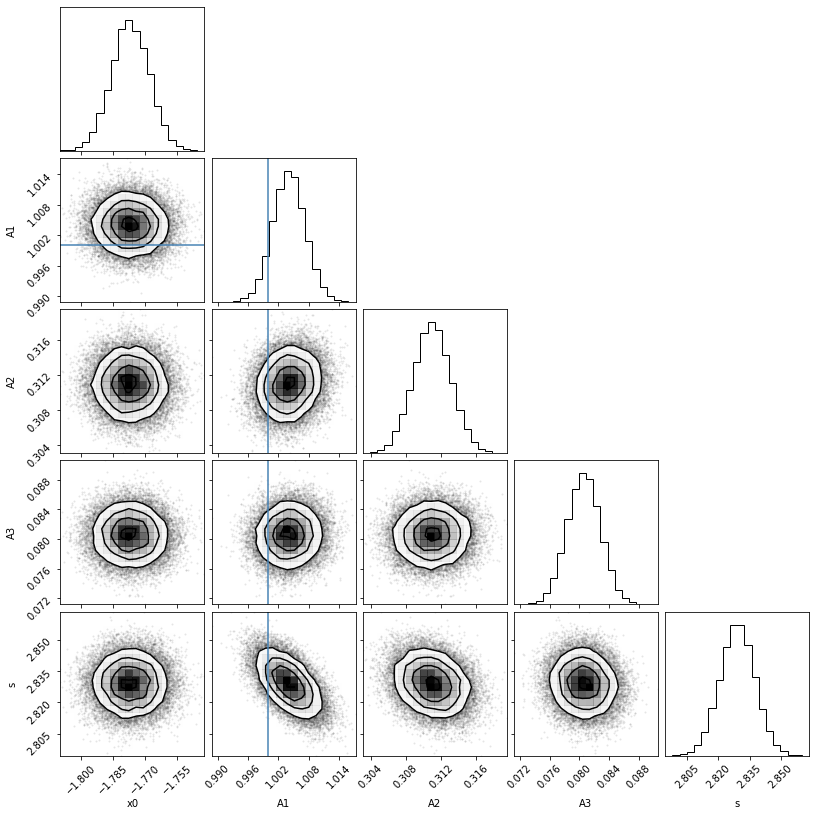

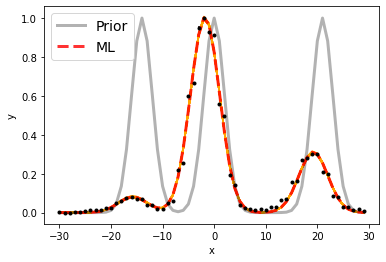

Maximum likelihood estimates:
x0 = -1.777
A1 = 1.004
A2 = 0.311
A3 = 0.081
s = 2.829


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x01, x02 =  6561.222906418791 6582.222906418791 [0.00870973 0.00898353]
A1, A2   =  5.492540357862269e-16 1.7011446415106948e-16 [1.74097809e-18 1.73830191e-18] [1.17281445e-18 1.17303346e-18]
s  =  2.829126360320035 [0.00830186 0.00833193]

-------------------------------------------------------------------------------------------

///////////////////////////////////////////////////////////////////////////////////////////


AJUSTANDO ESPECTRO 15

Ajuste en 4861 nm:

Parámetros reales:
1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


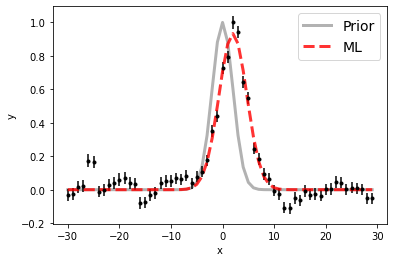

100%|██████████| 15000/15000 [00:19<00:00, 783.09it/s]


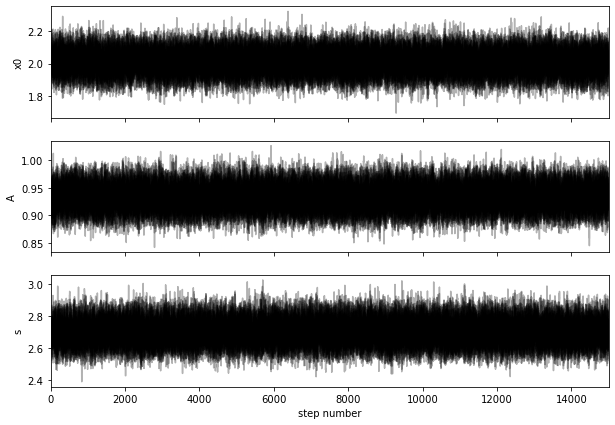

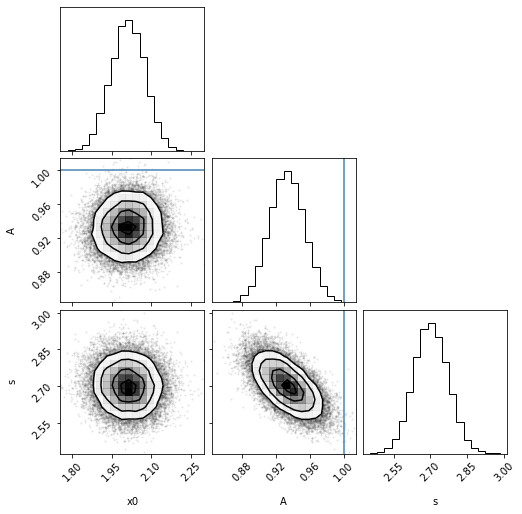

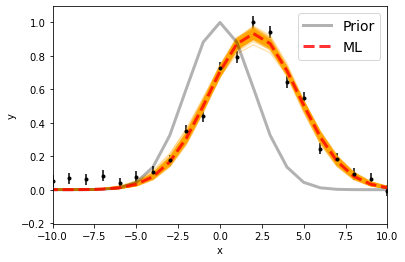

Maximum likelihood estimates:
x0 = 2.011
A = 0.933
s = 2.700


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x0 =  4863.011776902913 [0.06648799 0.06399374]
A  =  1.2849671729950066e-16 [2.83346941e-18 2.86407814e-18]
s  =  2.7009086684520156 [0.06834228 0.07085413]

-------------------------------------------------------------------------------------------

Ajuste en 5007 nm:

Parámetros reales:
1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


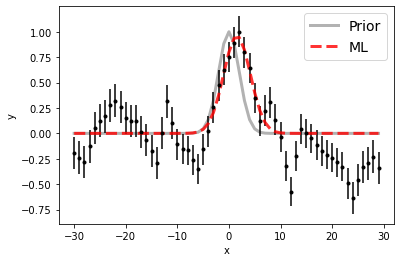

100%|██████████| 15000/15000 [00:20<00:00, 720.03it/s]


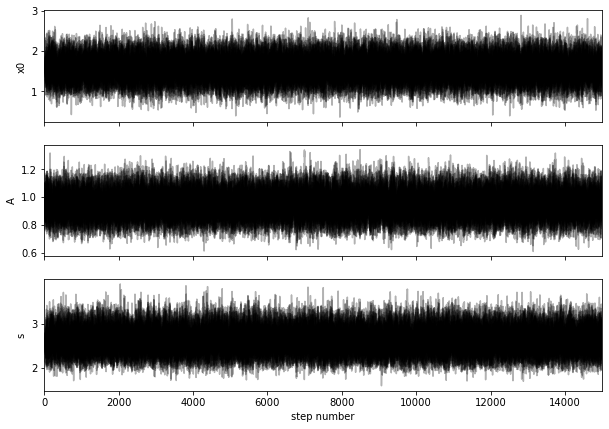

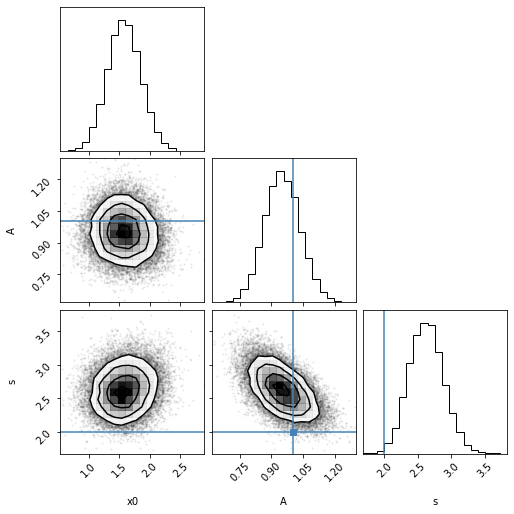

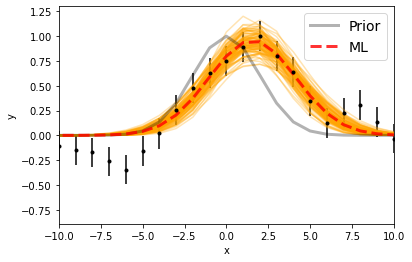

Maximum likelihood estimates:
x0 = 1.564
A = 0.958
s = 2.600


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x0 =  5008.5731256966055 [0.26997622 0.2758301 ]
A  =  2.817376986814967e-17 [2.47920808e-18 2.53140508e-18]
s  =  2.619713821962665 [0.25091732 0.26091294]

-------------------------------------------------------------------------------------------

Ajuste en 6563 nm:

Parámetros reales:
1.0 1.0 1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


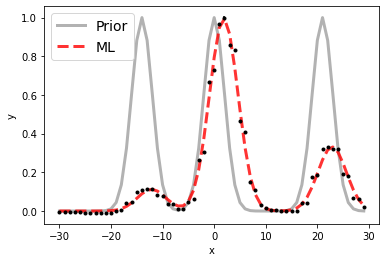

100%|██████████| 15000/15000 [00:49<00:00, 303.70it/s]


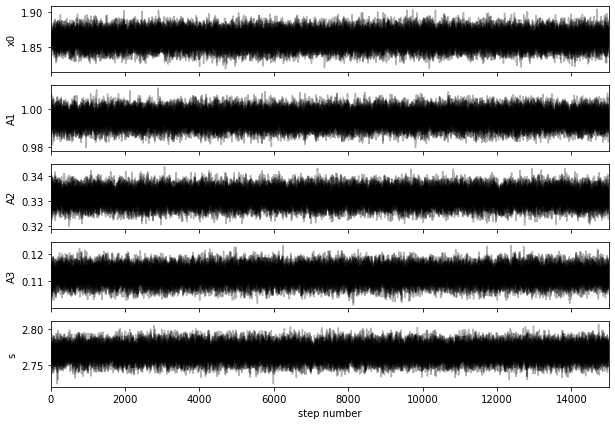

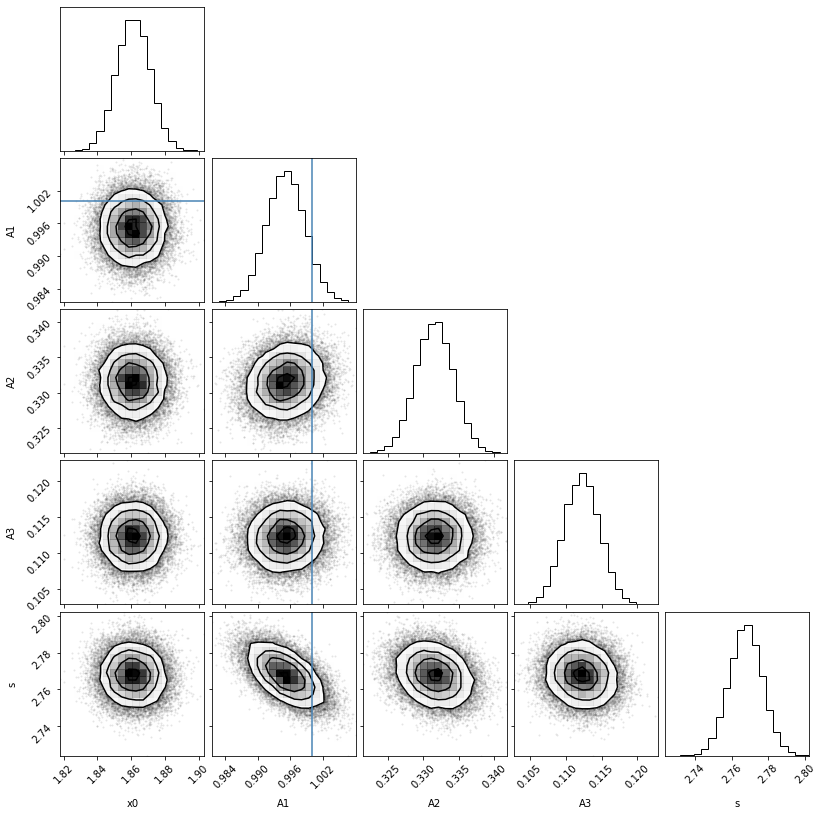

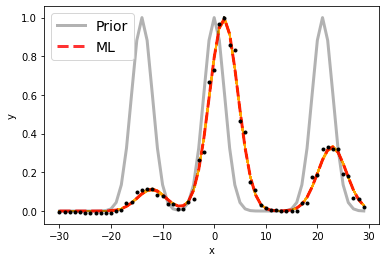

Maximum likelihood estimates:
x0 = 1.861
A1 = 0.995
A2 = 0.332
A3 = 0.112
s = 2.768


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x01, x02 =  6564.861082187771 6585.861082187771 [0.00989892 0.00991536]
A1, A2   =  5.084671518919965e-16 1.693927222711239e-16 [1.80913507e-18 1.81282995e-18] [1.36270644e-18 1.35207731e-18]
s  =  2.767727847397051 [0.00907948 0.0089945 ]

-------------------------------------------------------------------------------------------

///////////////////////////////////////////////////////////////////////////////////////////


AJUSTANDO ESPECTRO 16

Ajuste en 4861 nm:

Parámetros reales:
1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


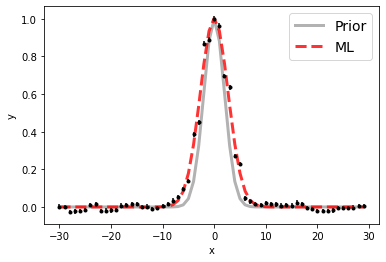

100%|██████████| 15000/15000 [00:45<00:00, 332.95it/s]


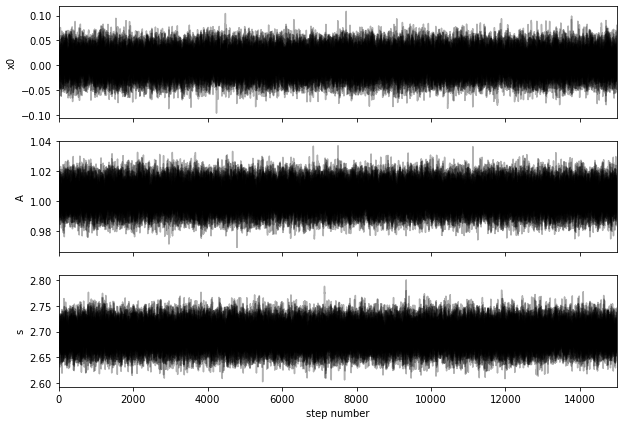

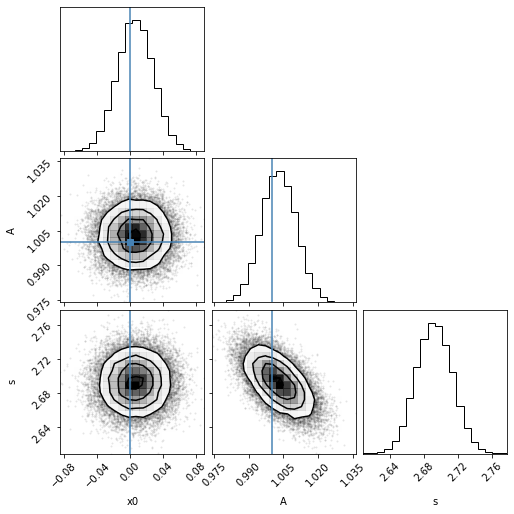

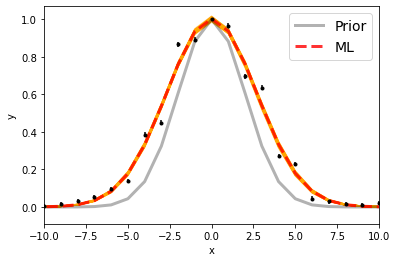

Maximum likelihood estimates:
x0 = 0.006
A = 1.003
s = 2.692


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x0 =  4861.005842798576 [0.02190113 0.02165075]
A  =  3.335754099857601e-16 [2.46566586e-18 2.52811978e-18]
s  =  2.692153349218624 [0.02102076 0.02125992]

-------------------------------------------------------------------------------------------

Ajuste en 5007 nm:

Parámetros reales:
1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


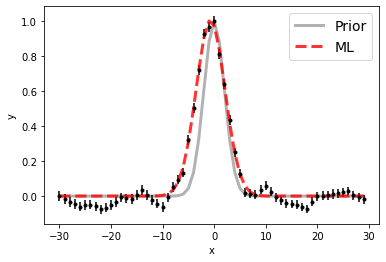

100%|██████████| 15000/15000 [00:44<00:00, 335.31it/s]


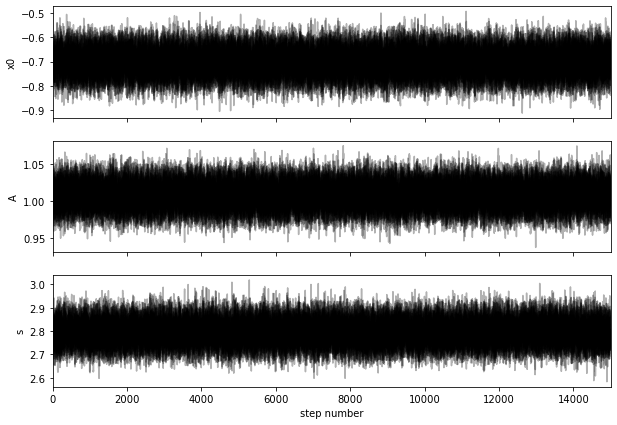

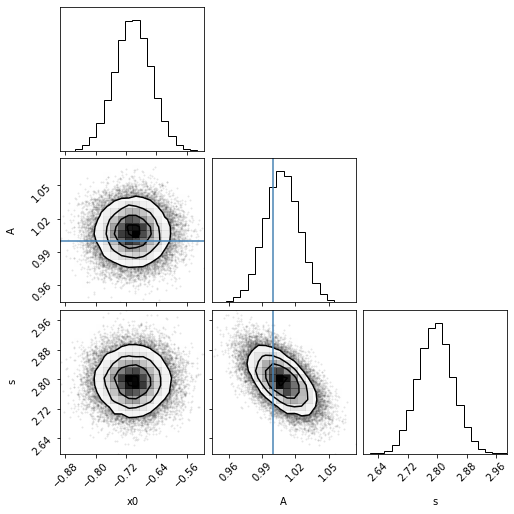

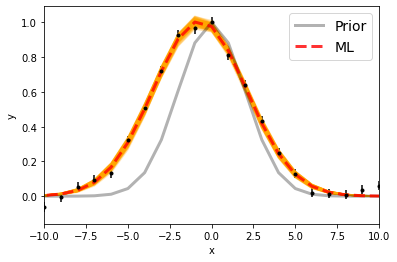

Maximum likelihood estimates:
x0 = -0.703
A = 1.008
s = 2.795


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x0 =  5006.297481798936 [0.04844376 0.04872672]
A  =  1.3585051526095958e-16 [2.11269502e-18 2.10110680e-18]
s  =  2.79540360402123 [0.0472754  0.04737981]

-------------------------------------------------------------------------------------------

Ajuste en 6563 nm:

Parámetros reales:
1.0 1.0 1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


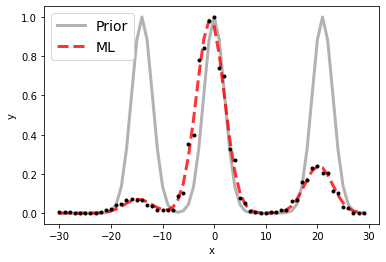

100%|██████████| 15000/15000 [01:07<00:00, 222.17it/s]


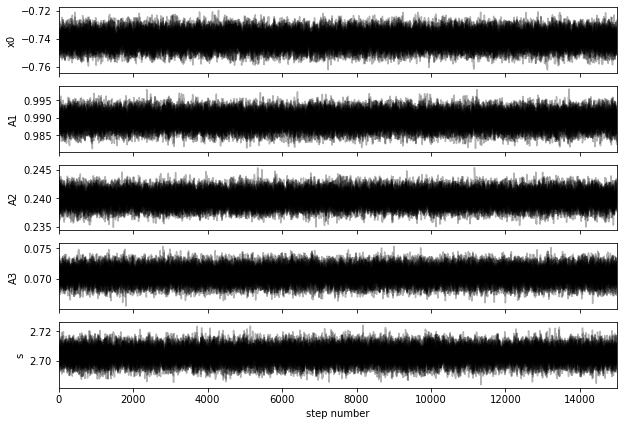

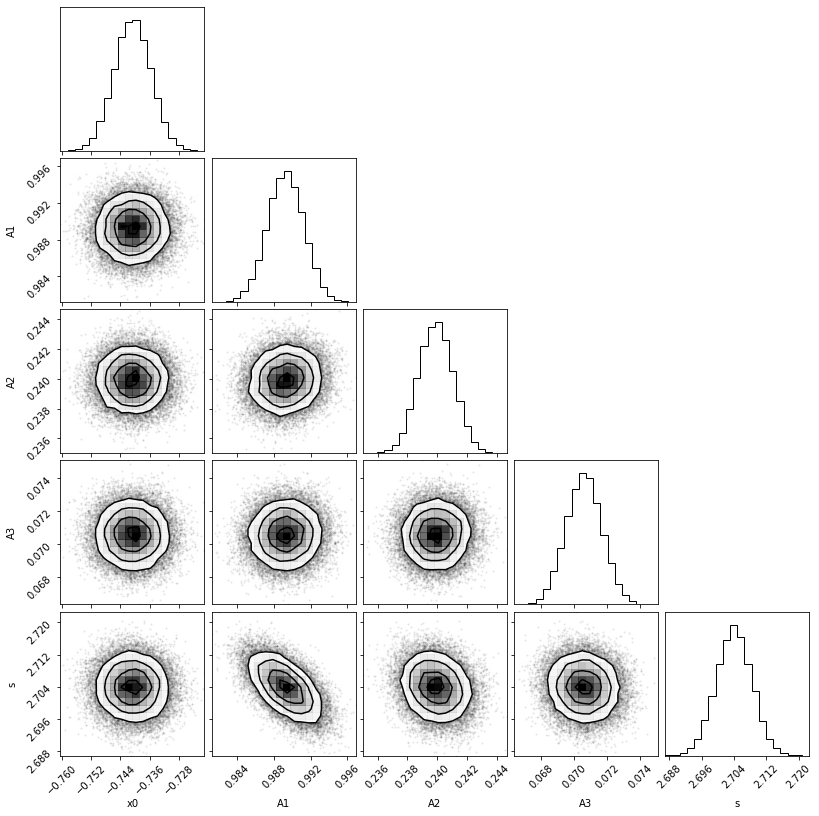

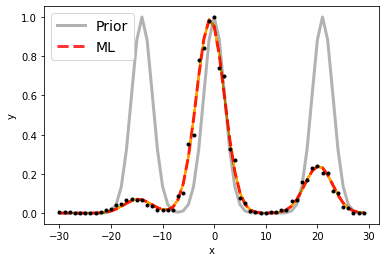

Maximum likelihood estimates:
x0 = -0.741
A1 = 0.989
A2 = 0.240
A3 = 0.071
s = 2.704


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x01, x02 =  6562.259263577398 6583.259263577398 [0.00495801 0.00496029]
A1, A2   =  1.082368043752562e-15 2.6248114705881284e-16 [2.15288254e-18 2.16255589e-18] [1.26542086e-18 1.26971520e-18]
s  =  2.703972664416295 [0.00439534 0.00439281]

-------------------------------------------------------------------------------------------

///////////////////////////////////////////////////////////////////////////////////////////


AJUSTANDO ESPECTRO 17

Ajuste en 4861 nm:

Parámetros reales:
1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


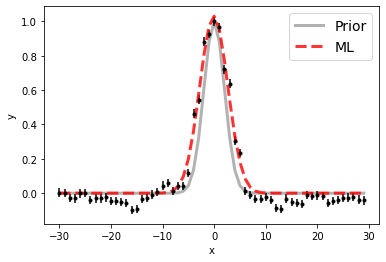

100%|██████████| 15000/15000 [00:43<00:00, 341.00it/s]


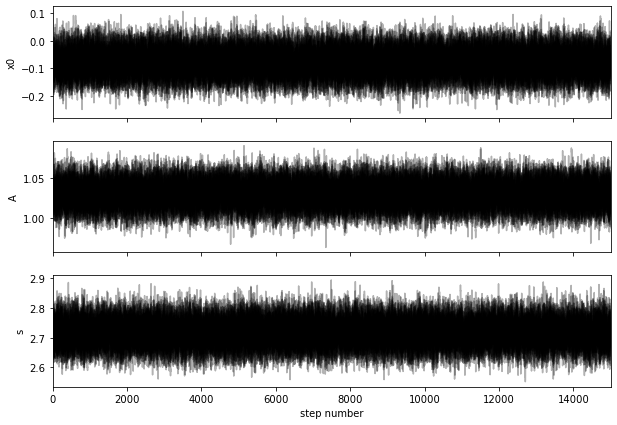

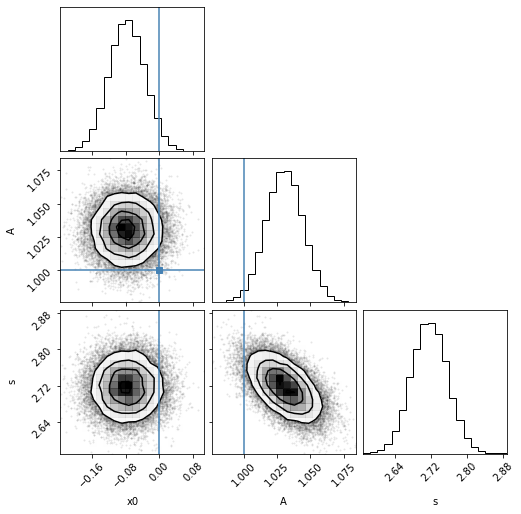

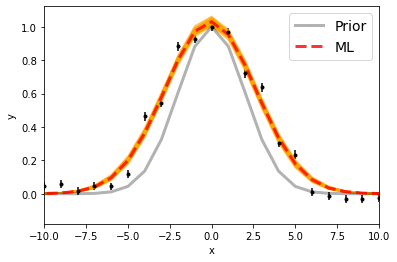

Maximum likelihood estimates:
x0 = -0.077
A = 1.031
s = 2.716


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x0 =  4860.922949844433 [0.04186608 0.04271606]
A  =  2.2146349825808787e-16 [2.99582563e-18 3.03778881e-18]
s  =  2.7168056029754997 [0.03942926 0.03976072]

-------------------------------------------------------------------------------------------

Ajuste en 5007 nm:

Parámetros reales:
1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


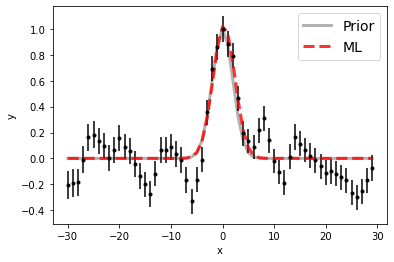

100%|██████████| 15000/15000 [00:45<00:00, 331.96it/s]


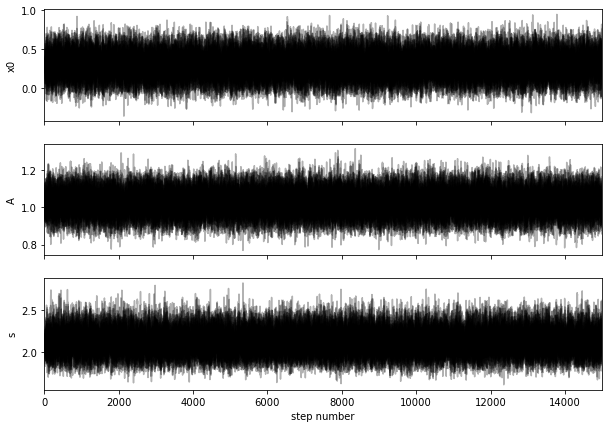

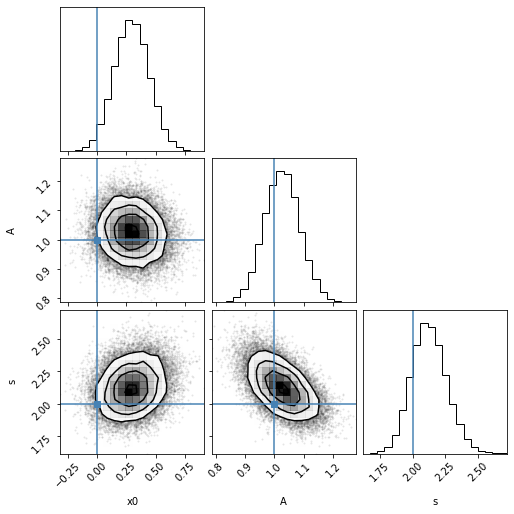

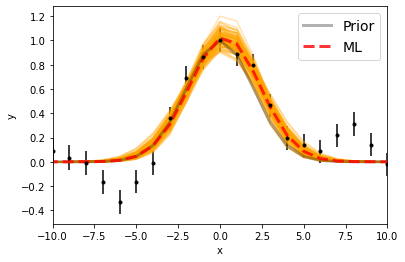

Maximum likelihood estimates:
x0 = 0.288
A = 1.029
s = 2.114


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x0 =  5007.294027987143 [0.1491617  0.14987941]
A  =  5.055585857840815e-17 [2.99567475e-18 2.96664360e-18]
s  =  2.121219778001451 [0.12896631 0.13818324]

-------------------------------------------------------------------------------------------

Ajuste en 6563 nm:

Parámetros reales:
1.0 1.0 1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


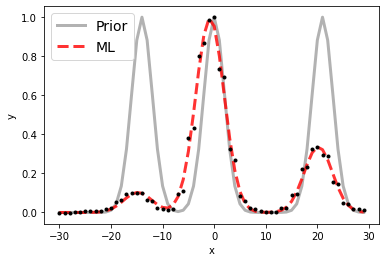

100%|██████████| 15000/15000 [01:08<00:00, 218.95it/s]


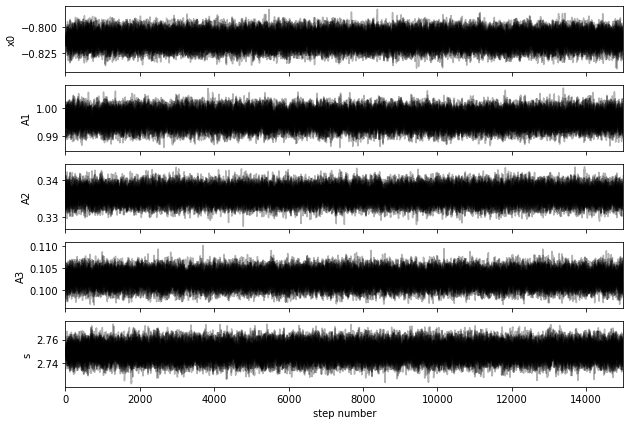

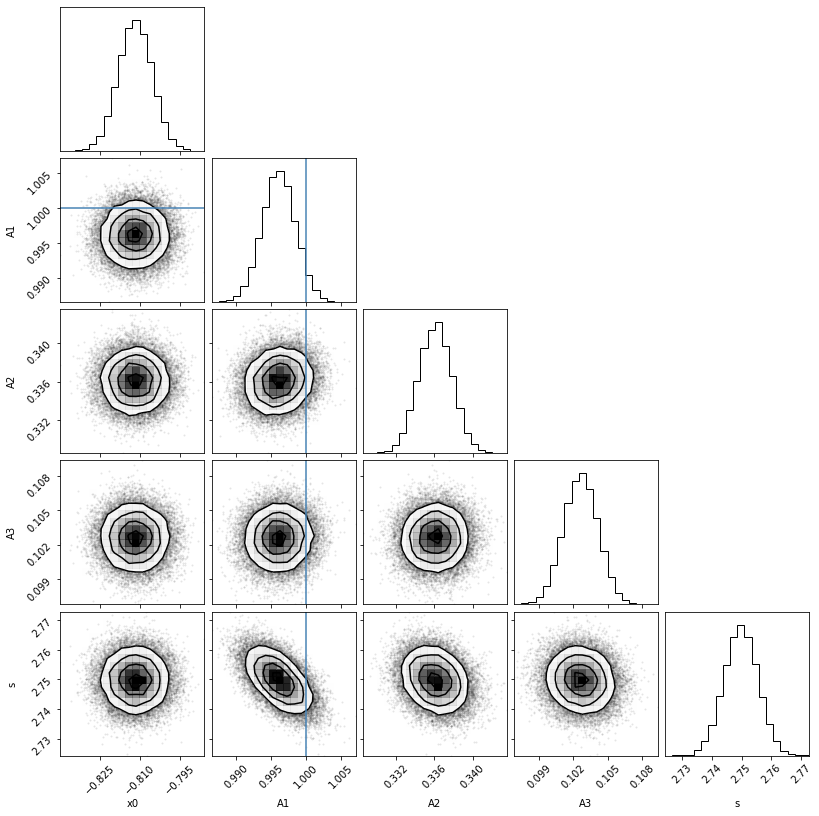

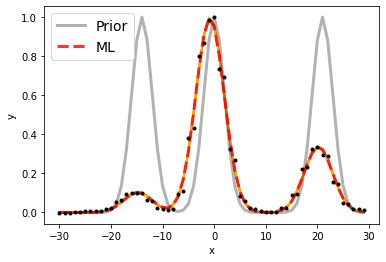

Maximum likelihood estimates:
x0 = -0.812
A1 = 0.996
A2 = 0.336
A3 = 0.103
s = 2.750


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x01, x02 =  6562.188145873617 6583.188145873617 [0.00630756 0.00626672]
A1, A2   =  1.0117261652706906e-15 3.4135714520645694e-16 [2.41584929e-18 2.45214760e-18] [1.79283725e-18 1.75671833e-18]
s  =  2.749754396973014 [0.00571072 0.00569787]

-------------------------------------------------------------------------------------------

///////////////////////////////////////////////////////////////////////////////////////////


AJUSTANDO ESPECTRO 18

Ajuste en 4861 nm:

Parámetros reales:
1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


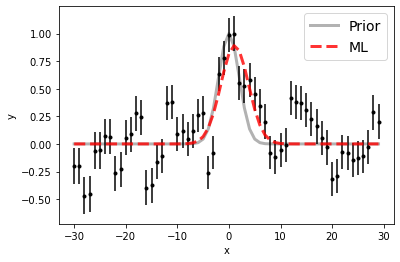

100%|██████████| 15000/15000 [00:44<00:00, 333.80it/s]


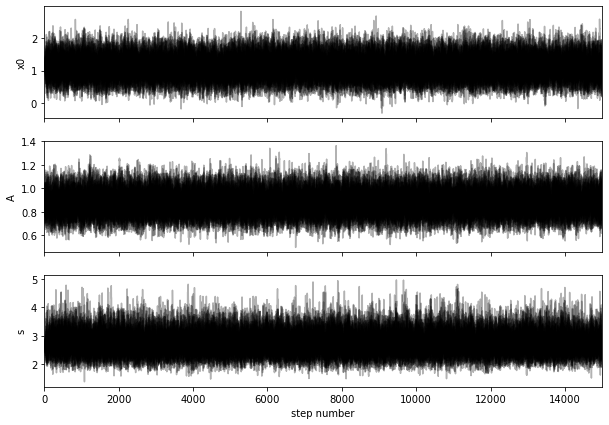

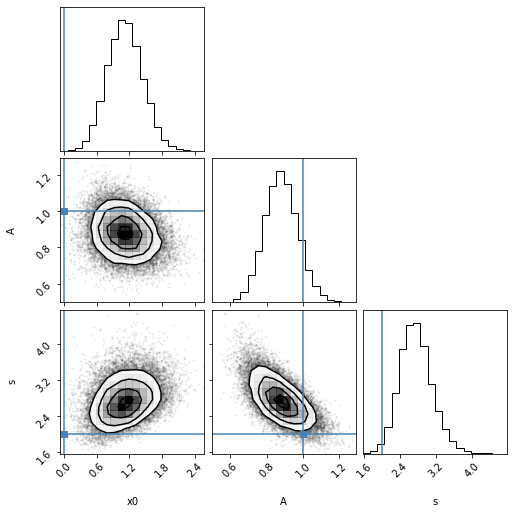

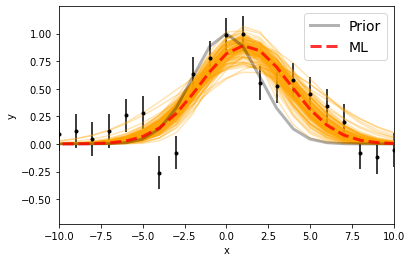

Maximum likelihood estimates:
x0 = 1.118
A = 0.891
s = 2.684


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x0 =  4862.112759495928 [0.32160402 0.33104104]
A  =  2.1740254204048225e-17 [2.22675554e-18 2.33459948e-18]
s  =  2.728298968321595 [0.3277124  0.37017137]

-------------------------------------------------------------------------------------------

Ajuste en 5007 nm:

Parámetros reales:
1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


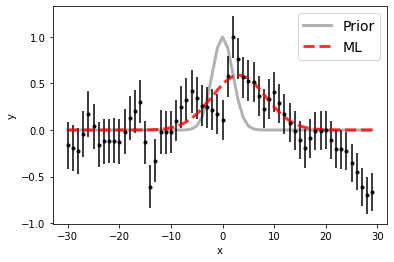

  0%|          | 0/15000 [00:00<?, ?it/s]C:\Users\saruk\anaconda3\lib\site-packages\emcee\moves\red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
100%|██████████| 15000/15000 [00:22<00:00, 660.90it/s]


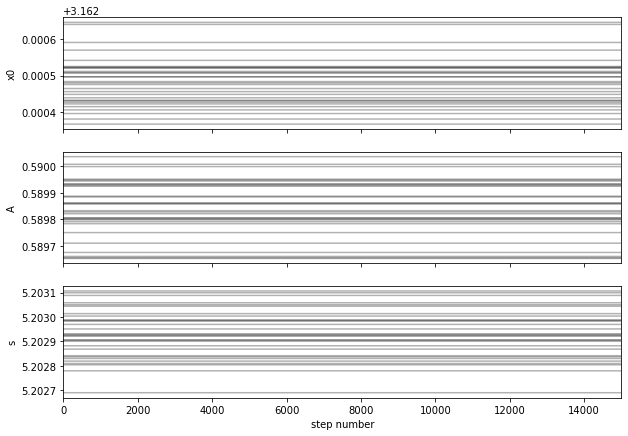

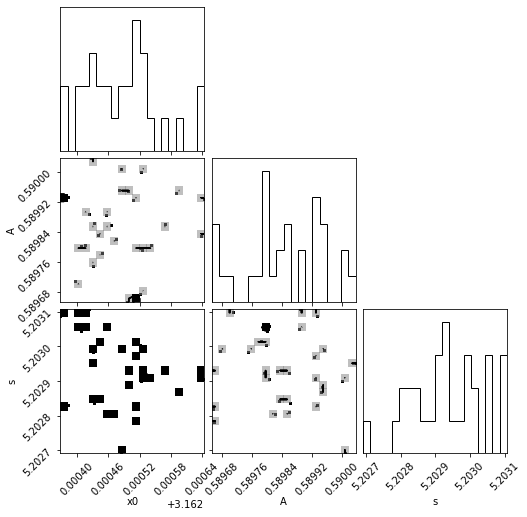

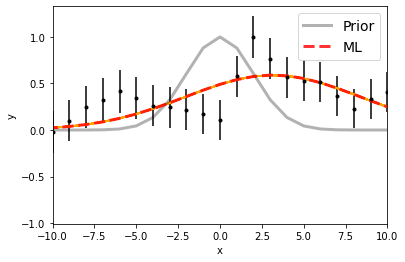

Maximum likelihood estimates:
x0 = 3.162
A = 0.590
s = 5.203


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x0 =  5010.162481701387 [6.65926128e-05 5.96478124e-05]
A  =  9.896913395898194e-18 [2.27057492e-21 1.72437728e-21]
s  =  5.20292636856353 [0.00010653 0.00012385]

-------------------------------------------------------------------------------------------

Ajuste en 6563 nm:

Parámetros reales:
1.0 1.0 1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


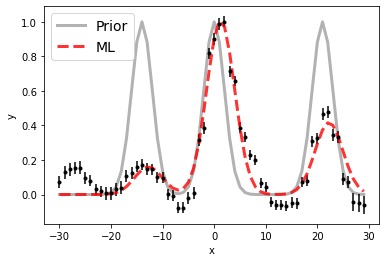

100%|██████████| 15000/15000 [01:09<00:00, 216.96it/s]


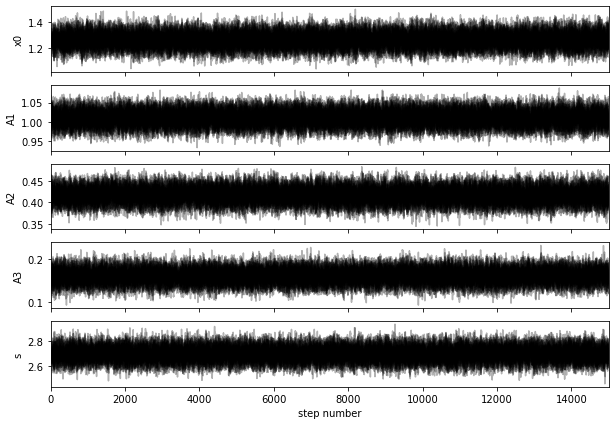

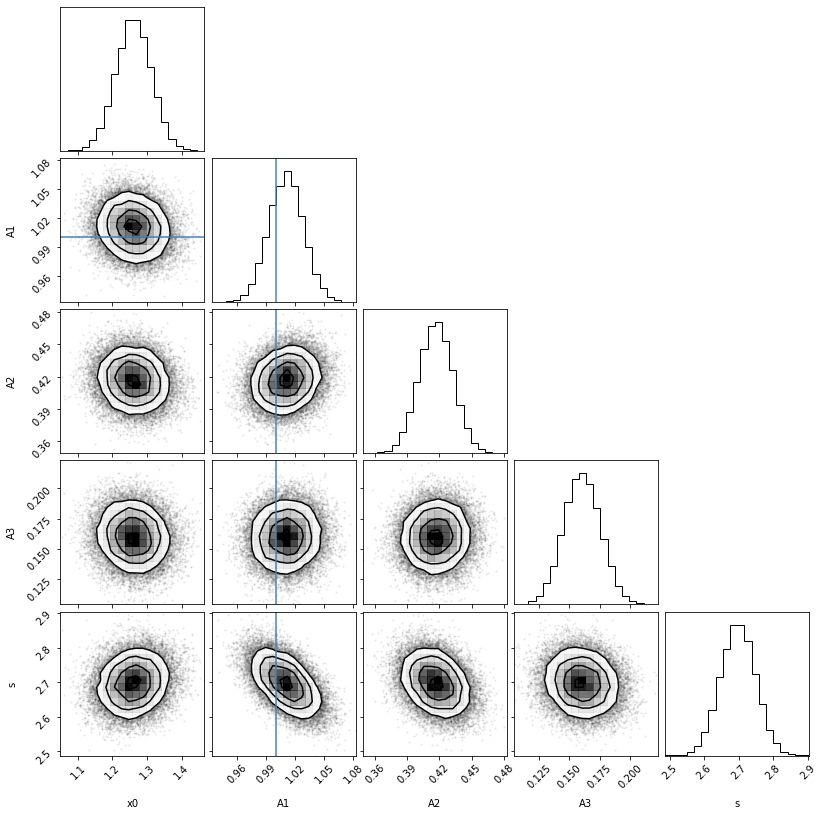

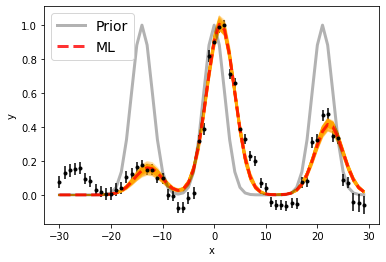

Maximum likelihood estimates:
x0 = 1.259
A1 = 1.010
A2 = 0.417
A3 = 0.160
s = 2.698


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x01, x02 =  6564.260524205576 6585.260524205576 [0.0516391  0.05117981]
A1, A2   =  7.266833847902342e-17 2.998410442444879e-17 [1.30638772e-18 1.26831816e-18] [1.13346346e-18 1.12823127e-18]
s  =  2.697448847251604 [0.05088573 0.0504613 ]

-------------------------------------------------------------------------------------------

///////////////////////////////////////////////////////////////////////////////////////////


El programa ha finalizado en 1704 s.


In [3]:
instanteInicial = datetime.now()

os.chdir(path+'\\adjusted_spectrum')    
os.getcwd()


Hbeta = 4861
OIII = 5007
Halfa = 6563
NII = 6583

lineas = np.array([Hbeta,OIII,Halfa,NII])
lineas_wave = np.array(np.where((l_obs==Hbeta)|(l_obs==OIII)|(l_obs==Halfa)|(l_obs==NII)))

for j in range(len(l_obs_todos[:,0])):
    l_obs = l_obs_todos[j,:]
    f_obs = f_obs_todos[j,:]
    f_syn = f_syn_todos[j,:]
    e_emit = e_emit_todos[j,:]
    
    print('AJUSTANDO ESPECTRO',j)
    print()
    
    
    ##################################### Hb y OIII
    x0_1 = []
    A_1 = []
    s_1 = []
    e_x0_1 = []
    e_A_1 = []
    e_s_1 = []
    lineas_1 = lineas[0:2]
    lineas_wave_1 = lineas_wave[0,0:2]
    for i in range(len(lineas_1)):
        lim_i=lineas_wave_1[i]-30; lim_i=int(lim_i)
        lim_f=lineas_wave_1[i]+30; lim_f=int(lim_f)
        
        # Choose the "true" parameters.
        data = f_obs-f_syn
        wave = l_obs[lim_i:lim_f]
        flux = data[lim_i:lim_f]
        ymax = np.max(flux)
        x = wave-lineas_1[i]
        y = flux/ymax
        yerr = e_emit[lim_i:lim_f]/ymax
        linea = lineas_1[i]
        
        def gaussian(x, a, x0, sigma):
            return a*np.exp(-(x-x0)**2/(2*sigma**2))
            
        popt, pcov = curve_fit(gaussian, wave, flux, p0=[1, 0, 2])
        
        A_true,x0_true,s_true=popt
        print('Ajuste en', lineas_1[i],'nm:')
        print()
        print('Parámetros reales:')
        print(A_true,x0_true,s_true)
        print()
        
        
        # Maximum likehood estimation:
        def log_likelihood(theta, x, y, yerr):
            x0, A, s = theta
            model = A * np.exp( -(x-x0)**2 / (2 * s**2) )
            sigma2 = yerr ** 2 #+ model ** 2 
            return -0.5 * np.sum((y - model) ** 2 / sigma2 )#+ np.log(sigma2))
        
        np.random.seed(42)
        nll = lambda *args: -log_likelihood(*args)
        initial = np.array([x0_true, A_true, s_true]) + 0.1 * np.random.randn(3)
        soln = minimize(nll, initial, args=(x, y, yerr))
        x0_ml, A_ml, s_ml = soln.x
        
        
        plt.errorbar(x, y, yerr=yerr, fmt=".k", capsize=0)
        plt.plot(x, A_true * np.exp(-(x-x0_true)**2 / (2*s_true**2))  , "k", alpha=0.3, lw=3, label="Prior")
        plt.plot(x, A_ml * np.exp(-(x-x0_ml)**2 / (2*s_ml**2))  , "--r", alpha=0.8, lw=3, label="ML")
        plt.legend(fontsize=14)
        #plt.xlim(-10, 10)
        plt.xlabel('x')
        plt.ylabel('y');
        plt.show()
        
        
        # Marginalization and uncertainty:
        def log_prior(theta):
            x0, A, s = theta
            if -10. < x0 < 10. and 0.0 < A < 20.0 and 0.0 < s < 5.0:
                return 0.0
            return -np.inf
        
        def log_probability(theta, x, y, yerr):
            lp = log_prior(theta)
            if not np.isfinite(lp):
                return -np.inf
            return lp + log_likelihood(theta, x, y, yerr)
        
        pos = soln.x + 1e-4 * np.random.randn(30, 3)
        nwalkers, ndim = pos.shape
        
        sampler = emcee.EnsembleSampler(nwalkers, ndim, log_probability, args=(x, y, yerr))
        sampler.run_mcmc(pos, 15000, progress=True);
        
        
        fig, axes = plt.subplots(3, figsize=(10, 7), sharex=True)
        samples = sampler.get_chain()
        labels = ["x0", "A", "s"]
        for i in range(ndim):
            ax = axes[i]
            ax.plot(samples[:, :, i], "k", alpha=0.3)
            ax.set_xlim(0, len(samples))
            ax.set_ylabel(labels[i])
        #    ax.yaxis.set_label_coords(-0.1, 0.5)
        
        axes[-1].set_xlabel("step number");
        plt.show()
        
        
        flat_samples = sampler.get_chain(discard=100, thin=15, flat=True)
        #print(flat_samples.shape)
        
        
        # Resultados
        fig = corner.corner(flat_samples, labels=labels, truths=[x0_true, A_true, s_true]);
        plt.show()
        
        inds = np.random.randint(len(flat_samples), size=100)
        plt.errorbar(x, y, yerr=yerr, fmt=".k", capsize=0)
        for ind in inds:
            sample = flat_samples[ind]
            plt.plot(x, sample[1] * np.exp(-(x-sample[0])**2 / (2*sample[2]**2)) , color='orange', alpha=0.3)
        plt.plot(x, A_true * np.exp(-(x-x0_true)**2 / (2*s_true**2))  , "k", alpha=0.3, lw=3, label="Prior")
        plt.plot(x, A_ml * np.exp(-(x-x0_ml)**2 / (2*s_ml**2))  , "--r", alpha=0.8, lw=3, label="ML")
        plt.legend(fontsize=14)
        plt.xlim(-10, 10)
        plt.xlabel('x')
        plt.ylabel('y');
        
        plt.show()
        
        print('Maximum likelihood estimates:')
        print("x0 = {0:.3f}".format(x0_ml))
        print("A = {0:.3f}".format(A_ml))
        print("s = {0:.3f}".format(s_ml))
        
        #
        datos = []
        errores = []
        for i in range(ndim):
            mcmc = np.percentile(flat_samples[:, i], [16, 50, 84])
            q = np.diff(mcmc)
            txt = "\mathrm{{{3}}} = {0:.3f}_{{-{1:.3f}}}^{{{2:.3f}}}"
            txt = txt.format(mcmc[1], q[0], q[1], labels[i])
            display(Math(txt))
            datos.append(mcmc[1])
            errores.append(q[:])
            
        datos = np.array(datos)
        errores = np.array(errores)
        x0 = datos[0]+linea
        A = datos[1]*ymax
        s = datos[2]
        e_x0 = errores[0]
        e_A = errores[1]*ymax
        e_s = errores[2]
        print('\nParámetros obtenidos:')
        print('x0 = ', x0, e_x0)
        print('A  = ', A, e_A)
        print('s  = ', s, e_s)
        print('\n-------------------------------------------------------------------------------------------')
        print()
        
        x0_1.append(x0)
        A_1.append(A)
        s_1.append(s)
        e_x0_1.append(e_x0)
        e_A_1.append(e_A)
        e_s_1.append(e_s)
    
    x0_1 = np.array(x0_1)
    A_1 = np.array(A_1)
    s_1 = np.array(s_1)
    e_x0_1 = np.array(e_x0_1)
    e_A_1 = np.array(e_A_1)
    e_s_1 = np.array(e_s_1)
    
        
    ##################################### Ha y NII
    
    d1 = 21
    d2 = 14
    
    x0_2 = []
    A1_2 = []
    A2_2 = []
    A3_2 = []
    s_2 = []
    e_x0_2 = []
    e_A1_2 = []
    e_A2_2 = []
    e_A3_2 = []
    e_s_2 = []
    lim_i = lineas_wave[0,2]-30; lim_i=int(lim_i)
    lim_f = lineas_wave[0,2]+30; lim_f=int(lim_f)
    
    # Choose the "true" parameters.
    data = f_obs-f_syn
    wave = l_obs[lim_i:lim_f]
    flux = data[lim_i:lim_f]
    ymax = np.max(flux)
    x = wave-lineas[2]
    y = flux/ymax
    yerr = e_emit[lim_i:lim_f]/ymax
    linea = lineas[2]
    
    def gaussian_2(x, a1 ,a2,a3, x0, sigma):
        return a1*np.exp(-(x-x0)**2/(2*sigma**2))+a2*np.exp(-(x-(x0+d1))**2/(2*sigma**2))+a3*np.exp(-(x-(x0-d2))**2/(2*sigma**2))
        
    popt, pcov = curve_fit(gaussian_2, wave, flux, p0=[1,1,1, 0, 2])
    
    A1_true,A2_true,A3_true,x0_true,s_true=popt
    print('Ajuste en', lineas[2],'nm:')
    print()
    print('Parámetros reales:')
    print(A1_true,A2_true,A3_true,x0_true,s_true)
    print()
    
    
    # Maximum likehood estimation:
    def log_likelihood(theta, x, y, yerr):
        x0, A1,A2,A3, s = theta
        model = A1 * np.exp( -(x-x0)**2 / (2 * s**2) )+A2 * np.exp( -(x-(x0+d1))**2 / (2 * s**2) )+A3 * np.exp( -(x-(x0-d2))**2 / (2 * s**2) )
        sigma2 = yerr ** 2 #+ model ** 2 
        return -0.5 * np.sum((y - model) ** 2 / sigma2 )#+ np.log(sigma2))
    
    np.random.seed(42)
    nll = lambda *args: -log_likelihood(*args)
    initial = np.array([x0_true, A1_true,A2_true,A3_true, s_true]) + 0.1 * np.random.randn(5)
    soln = minimize(nll, initial, args=(x, y, yerr))
    x0_ml, A1_ml,A2_ml,A3_ml, s_ml = soln.x
    
    
    plt.errorbar(x, y, yerr=yerr, fmt=".k", capsize=0)
    plt.plot(x, A1_true * np.exp(-(x-x0_true)**2 / (2*s_true**2))+ A2_true * np.exp(-(x-(x0_true+d1))**2 / (2*s_true**2))+ A3_true * np.exp(-(x-(x0_true-d2))**2 / (2*s_true**2))    , "k", alpha=0.3, lw=3, label="Prior")
    plt.plot(x, A1_ml * np.exp(-(x-x0_ml)**2 / (2*s_ml**2))+A2_ml * np.exp(-(x-(x0_ml+d1))**2 / (2*s_ml**2))+A3_ml * np.exp(-(x-(x0_ml-d2))**2 / (2*s_ml**2))  , "--r", alpha=0.8, lw=3, label="ML")
    plt.legend(fontsize=14)
    #plt.xlim(-10, 10)
    plt.xlabel('x')
    plt.ylabel('y');
    plt.show()
    
    
    # Marginalization and uncertainty:
    def log_prior(theta):
        x0, A1,A2,A3, s = theta
        if -10. < x0 < 10. and 0.0 < A1 < 20.0 and 0.0 < s < 5.0:
            return 0.0
        return -np.inf
        if -10. < x0 < 10. and 0.0 < A2 < 20.0 and 0.0 < s < 5.0:
            return 0.0
        return -np.inf
        if -10. < x0 < 10. and 0.0 < A3 < 20.0 and 0.0 < s < 5.0:
            return 0.0
        return -np.inf
    
    def log_probability(theta, x, y, yerr):
        lp = log_prior(theta)
        if not np.isfinite(lp):
            return -np.inf
        return lp + log_likelihood(theta, x, y, yerr)
    
    pos = soln.x + 1e-4 * np.random.randn(30, 5)
    nwalkers, ndim = pos.shape
    
    sampler = emcee.EnsembleSampler(nwalkers, ndim, log_probability, args=(x, y, yerr))
    sampler.run_mcmc(pos, 15000, progress=True);
    
    
    fig, axes = plt.subplots(5, figsize=(10, 7), sharex=True)
    samples = sampler.get_chain()
    labels = ["x0", "A1","A2","A3", "s"]
    for i in range(ndim):
        ax = axes[i]
        ax.plot(samples[:, :, i], "k", alpha=0.3)
        ax.set_xlim(0, len(samples))
        ax.set_ylabel(labels[i])
    #    ax.yaxis.set_label_coords(-0.1, 0.5)
    
    axes[-1].set_xlabel("step number");
    plt.show()
    
    
    flat_samples = sampler.get_chain(discard=100, thin=15, flat=True)
    #print(flat_samples.shape)
    
    
    # Resultados
    fig = corner.corner(flat_samples, labels=labels, truths=[x0_true, A1_true, A2_true, A3_true, s_true]);
    plt.show()
    
    inds = np.random.randint(len(flat_samples), size=100)
    plt.errorbar(x, y, yerr=yerr, fmt=".k", capsize=0)
    for ind in inds:
        sample = flat_samples[ind]
        plt.plot(x, sample[1] * np.exp(-(x-sample[0])**2 / (2*sample[4]**2))+sample[2] * np.exp(-(x-(sample[0]+d1))**2 / (2*sample[4]**2))+sample[3] * np.exp(-(x-(sample[0]-d2))**2 / (2*sample[4]**2)) , color='orange', alpha=0.3)
    plt.plot(x, A1_true * np.exp(-(x-x0_true)**2 / (2*s_true**2))+ A2_true * np.exp(-(x-(x0_true+d1))**2 / (2*s_true**2))+ A3_true * np.exp(-(x-(x0_true-d2))**2 / (2*s_true**2))  , "k", alpha=0.3, lw=3, label="Prior")
    plt.plot(x, A1_ml * np.exp(-(x-x0_ml)**2 / (2*s_ml**2))+A2_ml * np.exp(-(x-(x0_ml+d1))**2 / (2*s_ml**2))+A3_ml * np.exp(-(x-(x0_ml-d2))**2 / (2*s_ml**2))   , "--r", alpha=0.8, lw=3, label="ML")
    plt.legend(fontsize=14)
  #  plt.xlim(-10, 10)
    plt.xlabel('x')
    plt.ylabel('y');
    
    plt.show()
    
    print('Maximum likelihood estimates:')
    print("x0 = {0:.3f}".format(x0_ml))
    print("A1 = {0:.3f}".format(A1_ml))
    print("A2 = {0:.3f}".format(A2_ml))
    print("A3 = {0:.3f}".format(A3_ml))
    print("s = {0:.3f}".format(s_ml))
    
    #
    datos = []
    errores = []
    for i in range(ndim):
        mcmc = np.percentile(flat_samples[:, i], [16, 50, 84])
        q = np.diff(mcmc)
        txt = "\mathrm{{{3}}} = {0:.3f}_{{-{1:.3f}}}^{{{2:.3f}}}"
        txt = txt.format(mcmc[1], q[0], q[1], labels[i])
        display(Math(txt))
        datos.append(mcmc[1])
        errores.append(q[:])
        
    datos = np.array(datos)
    errores = np.array(errores)
    x0 = datos[0]+linea
    A1 = datos[1]*ymax
    A2 = datos[2]*ymax
    A3 = datos[3]*ymax
    s = datos[4]
    e_x0 = errores[0]
    e_A1 = errores[1]*ymax
    e_A2 = errores[2]*ymax
    e_A3 = errores[3]*ymax
    e_s = errores[4]
    print('\nParámetros obtenidos:')
    print('x01, x02 = ', x0, x0+d1, e_x0)
    print('A1, A2   = ', A1, A2, e_A1, e_A2)
    print('s  = ', s, e_s)
    print('\n-------------------------------------------------------------------------------------------')
    print()
    
    x0_2.append(x0)
    A1_2.append(A1)
    A2_2.append(A2)
    A3_2.append(A3)
    s_2.append(s)
    e_x0_2.append(e_x0)
    e_A1_2.append(e_A1)
    e_A2_2.append(e_A2)
    e_A3_2.append(e_A3)
    e_s_2.append(e_s)
    
    x0_2 = np.array(x0_2)
    A1_2 = np.array(A1_2) # Ha
    A2_2 = np.array(A2_2) # NII
    A3_2 = np.array(A3_2) # El otro N
    s_2 = np.array(s_2)
    e_x0_2 = np.array(e_x0_2)
    e_A1_2 = np.array(e_A1_2)
    e_A2_2 = np.array(e_A2_2)
    e_A3_2 = np.array(e_A3_2)
    e_s_2 = np.array(e_s_2)
    
    
    ####
    
    
    x0_t = np.concatenate((x0_1,x0_2,(x0_2+d1)),axis=0)
    e_x0_t = np.concatenate((e_x0_1,e_x0_2,e_x0_2),axis=0)
    A_t = np.concatenate((A_1,A1_2,A2_2),axis=0)
    e_A_t = np.concatenate((e_A_1,e_A1_2,e_A2_2),axis=0)
    s_t = np.concatenate((s_1,s_2,s_2),axis=0)
    e_s_t = np.concatenate((e_s_1,e_s_2,e_s_2),axis=0) 

    table = {'media': x0_t, 'e1x0':e_x0_t[:,0], 'e2x0':e_x0_t[:,1], 'A': A_t, 'e1A':e_A_t[:,0], 'e2A':e_A_t[:,1], 's':s_t, 'e1s':e_s_t[:,0], 'e2s':e_s_t[:,1]}
    #ascii.write(table, 'spectrum_adjusted_'+str(j)+'_NGC3972.txt', formats={'media': '%.5f','e1x0': '%.5f','e2x0':'%.5f','A': '%.10e','e1A': '%.10e','e2A':'%.10e','s': '%.5f','e1s': '%.5f','e2s':'%.5f'}, overwrite=True,format='fixed_width',delimiter=None)  
    
    print('///////////////////////////////////////////////////////////////////////////////////////////')
    print()
    print()

instanteFinal = datetime.now()
tiempo = instanteFinal - instanteInicial 
segundos = tiempo.seconds
print('El programa ha finalizado en', segundos,'s.')

Tras esto, se han eliminado determinados espectros ya que no se podían ajustar adecuadamente. 

En este caso nos hemos quedado con 17 espectros, se han eliminado el 11 y el 18.

### Calculo de flujos

Una vez conocemos la altura de la campana, A, y el ancho o desviación típica, s, del ajuste gaussiano calculamos el flujo de cada campana, que es el área debajo de la curva, que será:

                                           flujo = A * s * sqrt(2pi)

Y hacemos propagación de errores:

                             error = sqrt( 2pi * (s^2 * error_A^2 + A^2 *error_s^2)
                             
Los errores de A y sigma se han obtenido durante el ajuste gaussiano.

In [5]:
os.chdir(path+'\\adjusted_spectrum')    
os.getcwd()

lenn = len(glob.glob1(path+'\emited_spectrum',"*.BN"))

flux_t = []
err1_flux_t = []
err2_flux_t = []
for i in list(itertools.chain(range(0,lenn-8), range(lenn-7,lenn-1))):
    datos=pd.read_table('spectrum_adjusted_'+str(i)+'_NGC3972.txt', delim_whitespace=True)
    A = datos['A']
    s = datos['s']
    e1A = datos['e1A']
    e2A = datos['e2A']
    e1s = datos['e1s']
    e2s = datos['e2s']
    flux = []
    err1_flux = []
    err2_flux = []
    for j in range(len(A)): 
        integral = A[j]*s[j]*sqrt(2*pi)
        err1 = sqrt(2*pi*(s[j]**2*e1A[j]**2+A[j]**2*e1s[j]**2))
        err2 = sqrt(2*pi*(s[j]**2*e2A[j]**2+A[j]**2*e2s[j]**2))
        flux.append(integral)
        err1_flux.append(err1)
        err2_flux.append(err2)
    flux = np.array(flux)
    err1_flux = np.array(err1_flux)
    err2_flux = np.array(err2_flux)
    flux_t.append(flux)
    err1_flux_t.append(err1_flux)
    err2_flux_t.append(err2_flux)
flux_t = np.array(flux_t)
err1_flux_t = np.array(err1_flux_t)
err2_flux_t = np.array(err2_flux_t)

spec = np.linspace(0,len(flux_t[:,0])-1,len(flux_t[:,0]))
for j in range(len(flux_t[:,0])):
    table = {'spec': spec, 'Ha':flux_t[:,2], 'e1Ha':err1_flux_t[:,2], 'e2Ha':err2_flux_t[:,2], 
             'Hb':flux_t[:,0], 'e1Hb':err1_flux_t[:,0], 'e2Hb':err2_flux_t[:,0], 'O3': flux_t[:,1], 
             'e1O3':err1_flux_t[:,1], 'e2O3':err2_flux_t[:,1], 'N2':flux_t[:,3], 'e1N2':err1_flux_t[:,3], 
             'e2N2':err2_flux_t[:,3]}
    ascii.write(table, 'flujos.txt', formats={'spec': '%i','Ha': '%.6e','e1Ha': '%.6e','e2Ha': '%.6e',
                                              'Hb':'%.6e','e1Hb': '%.6e','e2Hb': '%.6e','O3': '%.6e',
                                              'e1O3': '%.6e','e2O3': '%.6e','N2': '%.6e','e1N2': '%.6e',
                                              'e2N2': '%.6e',}, overwrite=True, format='fixed_width',delimiter=None)  
